In [1]:
import sys
print(sys.version)

3.6.5 |Anaconda custom (64-bit)| (default, Mar 29 2018, 13:14:23) 
[GCC 4.2.1 Compatible Clang 4.0.1 (tags/RELEASE_401/final)]


In [2]:
"""
Created on January 20 2018
@author: Neven Caplar
@contact: ncaplar@princeton.edu

These comments are theoretically the only ones you need to read to run the notebook

1. Specify the directory in which you want to run the analysis below (PSF_DIRECTORY)
2. Name and place the data in DATA_FOLDER. The data is avaliable at https://github.com/nevencaplar/PFS_Work_In_Progress/tree/master/CutsForTigerMay2
3. TESTING_FOLDER will be filled during the run with images from the analysis analysis

4. (OPTIONAL)Next cell contains some extensions that I use that make life much easier when using jupyter notebook 
    Without them this notebook becomes reallllly huge and hard to deal with
    These can be downloaded from https://github.com/ipython-contrib/jupyter_contrib_nbextensions

"""
############################################################
# name your directory where you want to have files!
PSF_DIRECTORY='/Users/nevencaplar/Documents/PFS/'
# place cutouts in this folder - name as you wish
DATA_FOLDER=PSF_DIRECTORY+'TigerAnalysis/CutsForTigerMay2/'
############################################################
    

TESTING_FOLDER=PSF_DIRECTORY+'Testing/'
TESTING_PUPIL_IMAGES_FOLDER=TESTING_FOLDER+'Pupil_Images/'
TESTING_WAVEFRONT_IMAGES_FOLDER=TESTING_FOLDER+'Wavefront_Images/'
TESTING_FINAL_IMAGES_FOLDER=TESTING_FOLDER+'Final_Images/'
import os

for i in [PSF_DIRECTORY,DATA_FOLDER,TESTING_PUPIL_IMAGES_FOLDER,TESTING_WAVEFRONT_IMAGES_FOLDER,TESTING_FINAL_IMAGES_FOLDER]:
    if not os.path.exists(i):
        os.makedirs(i)  

In [3]:
%%javascript
try {
  require(['base/js/utils'], function (utils) {
    utils.load_extension('code_prettify/code_prettify');
    utils.load_extension('collapsible_headings/main'); 
    utils.load_extension('codefolding/edit'); 
    utils.load_extension('codefolding/main'); 
    utils.load_extension('execute_time/ExecuteTime');   
    utils.load_extension('toc2/main'); 
  });
}
catch (err) {
  console.log('toc2 load error:', err);
}

<IPython.core.display.Javascript object>

In [4]:
# make notebook nice and wide to fill the entire screen
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [5]:
%load_ext autoreload
%autoreload 2

#import Zernike_Module
#from Zernike_Module import LNP_PFS,LN_PFS_single,create_parInit,downsample_manual_function,Zernike_Analysis,PFSPupilFactory,custom_fftconvolve,stepK,maxK,sky_scale,sky_size,create_x,remove_pupil_parameters_from_all_parameters

#Zernike_Module_lastOct15_beforeScatterChange
import Zernike_Module
from Zernike_Module import *

In [6]:
#general import statments
from __future__ import absolute_import, division, print_function
import galsim
import numpy as np
np.set_printoptions(suppress=True)
np.seterr(divide='ignore', invalid='ignore')
import pandas as pd
import io
import math
import pickle

#tqdm is not necesarry, it is the monitor evaluation of the 'for' loops
from tqdm import tqdm

# lsst stack
#import lsst.afw
#from lsst.afw.cameraGeom import PupilFactory
#from lsst.afw.geom import Angle, degrees
#from lsst.afw import geom
#from lsst.afw.geom import Point2D

# astropy
import astropy
import astropy.convolution
from astropy.convolution import Gaussian2DKernel

# scipy and skimage
#from scipy.ndimage import gaussian_filter
import scipy.misc
import skimage.transform

#lmfit
import lmfit

#matplotlib
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
matplotlib.rcParams.update({'font.size': 18})
%config InlineBackend.rc = {}
%matplotlib inline
%config IPython.matplotlib.backend = "retina"

from shutil import copy
from scipy.optimize import curve_fit

def lin_fit_1D(x, a, b):
    return a * x + b

def lin_fit_1DConstant(x, b):
    return  np.full(len(x),b)

def lin_fit_2D(x,y, a, b,c):
    return a * x + b*y+c

## unit test

In [7]:
columns=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

sci_image_unit=np.ones((50,50))
var_image_unit=np.ones((50,50))
#array([     0.85110826,      0.73047372,     -0.31672873,     -0.00539844, -0.32264156,     -0.04922217,     -0.49565709,      0.18057418,
#            0.79993531,      0.10032969,      0.08769052,      0.25372595,          0.06064503,      0.21049747,   
#           0.45840763,      2.05047984,  0.30893478,     -0.13166649, 
#           -0.06752367,     -0.13093007,            0.89197452, 
#           0.10757197,   0.60969064,      1.06409559,   0.14192374, 
#           109336.61223169,   2.41053199,      0.00379578,
#            0.4673993 ,      1.88555321,      0.99733826])
allparameters_proposal=np.array([24,0.09,0.02,-0.1,0.0,0.1,0.02,0.2,
                                 0.7,0.1,0.3,0.0,0.07,0.0,
                                 0.17,0.67,1,1,
                                 0.0,-0.0,0.80,
                                 0.01,0.51,1.06,0.28,
                                 50000,2.5,0.027,
                                 0.37,1.85,1.0])
print('version of the code is: '+str(Zernike_Module.__version__))
model = LN_PFS_single(sci_image_unit,var_image_unit,dithering=1,save=1)   

res=model(allparameters_proposal,return_Image=True)
print(res[0])
#assert res=-4808.04
#print('ok')

version of the code is: 0.21b
None
zmax: 11
-3291.813787780913


In [8]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')

optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')



res_iapetus=res[1]

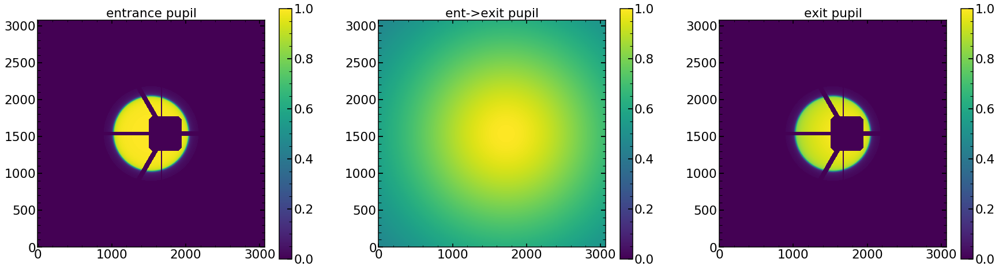

In [9]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

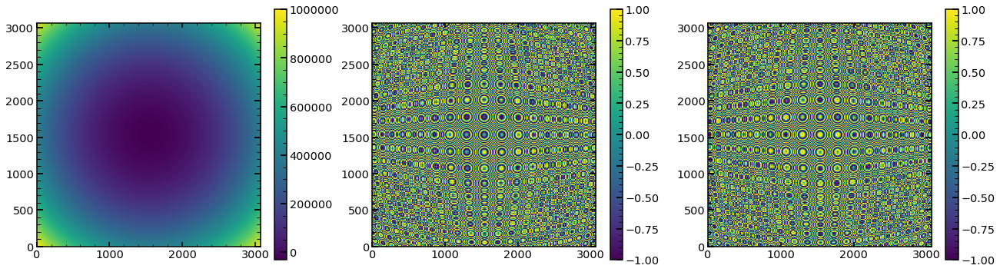

In [10]:
matplotlib.rcParams.update({'font.size': 12})

plt.figure(figsize=(30,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()


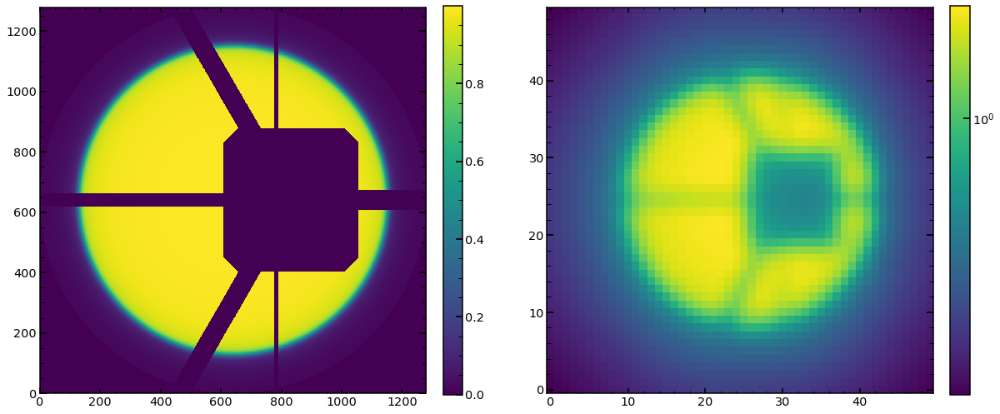

In [11]:
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(pupililluminated,origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(122)
plt.imshow(res_iapetus,norm=LogNorm(),origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([1,10**-2,10**-3,10**-4,10**-5,10,10**2,10**3,10**4,10**5])

# March 21

## First script

In [22]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)

In [199]:
list_of_HgAr_to_analyze=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=16)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=0)
                                        &(finalHgAr_Feb2019['close'].values.astype(int)==1)&(finalHgAr_Feb2019['wavelength'].values.astype(float)<800)&(finalHgAr_Feb2019['wavelength'].values.astype(float)>600)]

list_of_HgAr_to_not_analyze_2_3=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=3)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=2)
                                        &(finalHgAr_Feb2019['close'].values.astype(int)==1)&(finalHgAr_Feb2019['wavelength'].values.astype(float)<1000)&(finalHgAr_Feb2019['wavelength'].values.astype(float)>600)]

list_of_HgAr_to_not_analyze_727=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['wavelength']=='727.47876')]

# remove the spots from fibers 2 and 3 as they are too close together
list_of_HgAr_to_analyze=np.setdiff1d(list_of_HgAr_to_analyze,list_of_HgAr_to_not_analyze_2_3)
list_of_HgAr_to_analyze=np.setdiff1d(list_of_HgAr_to_analyze,list_of_HgAr_to_not_analyze_727)
print(len(list_of_HgAr_to_analyze))

28


In [200]:
list_of_Ne_to_analyze_all=finalNe_Feb2019.index[(finalNe_Feb2019['fiber'].values.astype(int)<=16)&(finalNe_Feb2019['fiber'].values.astype(int)>=0)
                                        &(finalNe_Feb2019['close'].values.astype(int)==1)]


list_of_Ne_to_not_analyze_2_3=finalNe_Feb2019.index[(finalNe_Feb2019['fiber'].values.astype(int)<=3)&(finalNe_Feb2019['fiber'].values.astype(int)>=2)
                                        &(finalNe_Feb2019['close'].values.astype(int)==1)]

# remove the spots from fibers 2 and 3 as they are too close together
list_of_Ne_to_analyze=np.setdiff1d(list_of_Ne_to_analyze_all,list_of_Ne_to_not_analyze_2_3)

print(len(list_of_Ne_to_analyze))

56


28


In [201]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T01S'+str(single_spot)+'March.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI03.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/MarchScriptToSubmitScriptsTiger01'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T01S'+str(single_spot)+'March.sh \n')

file.close()

In [202]:
#MPI
for single_spot in list_of_Ne_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T02S'+str(single_spot)+'March.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    #for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
    for obs in [12397,12313,12355,12349,12361,12343,12367,12403,12307,12319,12391]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI03.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/MarchScriptToSubmitScriptsTiger02'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_Ne_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T02S'+str(single_spot)+'March.sh \n')

file.close()

In [334]:
list_of_HgAr_to_analyze=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=16)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=0)
                                        &(finalHgAr_Feb2019['close'].values.astype(int)==1)&(finalHgAr_Feb2019['wavelength'].values.astype(float)<1000)&(finalHgAr_Feb2019['wavelength'].values.astype(float)>800)]

list_of_HgAr_to_not_analyze_2_3=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=3)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=2)
                                        &(finalHgAr_Feb2019['close'].values.astype(int)==1)&(finalHgAr_Feb2019['wavelength'].values.astype(float)<1000)&(finalHgAr_Feb2019['wavelength'].values.astype(float)>600)]

list_of_HgAr_to_not_analyze_727=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['wavelength']=='727.47876')]

# remove the spots from fibers 2 and 3 as they are too close together
list_of_HgAr_to_analyze=np.setdiff1d(list_of_HgAr_to_analyze,list_of_HgAr_to_not_analyze_2_3)
list_of_HgAr_to_analyze=np.setdiff1d(list_of_HgAr_to_analyze,list_of_HgAr_to_not_analyze_727)
print(len(list_of_HgAr_to_analyze))

28


In [335]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T01S'+str(single_spot)+'March.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for obs in [11790,11730,11748,11694,11754,11700,11760,11796,11736,11724,11784]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI03.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/MarchScriptToSubmitScriptsTiger01'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T01S'+str(single_spot)+'March.sh \n')

file.close()

## Looking at the single image

In [393]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
    
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
    
    
date='March22'
obs=11730
single_number='99'
image_index=int(single_number)
eps=5
arc='HgAr'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

p35


fiber                            8
xc                            2135
yc                            1179
wavelength               727.47876
close                            1
lamp                          HgAr
xc_effective                  2204
old_index_approx                63
superold_index_approx          nan
Name: 99, dtype: object

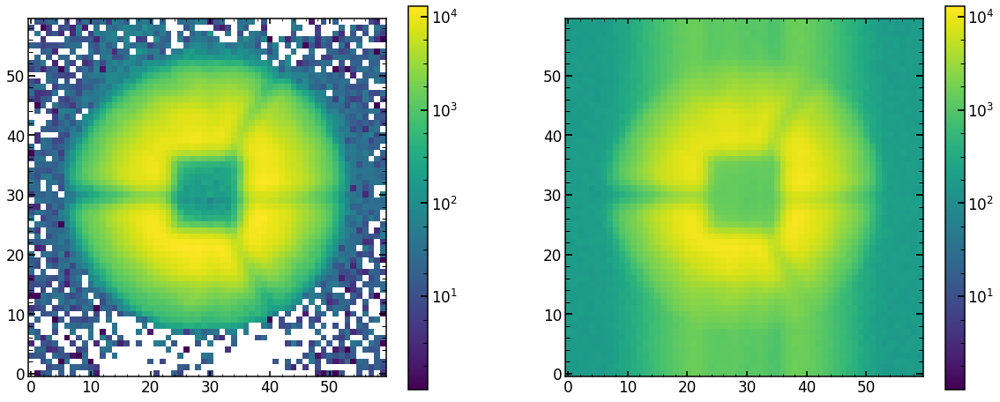

In [394]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [395]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

FileNotFoundError: [Errno 2] No such file or directory: '/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/March22/chainMarch22_Single_P_11730995HgArEmcee3.npy'

In [339]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(31,)
          z4        z5        z6        z7        z8        z9       z10  \
0 -26.737984 -0.517362  0.037548  0.247717 -0.026299 -0.072088 -0.266047   

        z11  
0 -0.555707  
   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.68098   0.078564  0.011734  0.012193  0.066093     0.004508   

   radiometricEffect  radiometricExponent    x_ilum    y_ilum  
0       1.523500e-07         1.700600e-07  0.972817  0.948338  
   x_fiber   y_fiber  effective_radius_illumination  frd_sigma  \
0  -0.0024 -0.058512                        0.79753   0.107805   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.998192  1.036481           -0.027785  119676.102803   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.228216              0.001182      0.468095  1.822104  0.996414  


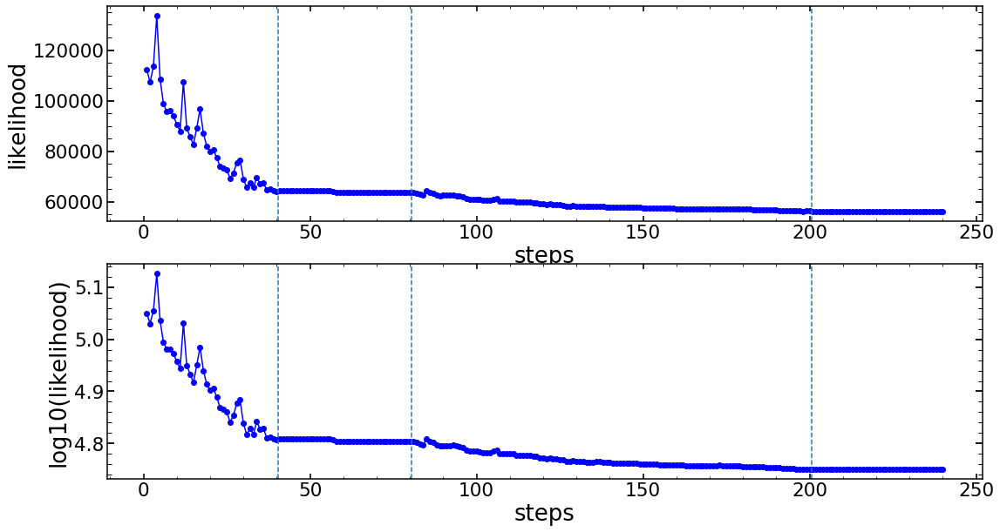

In [340]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [341]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   
       
model(minchain)

None
zmax: 11


-56243.51540607001

In [342]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

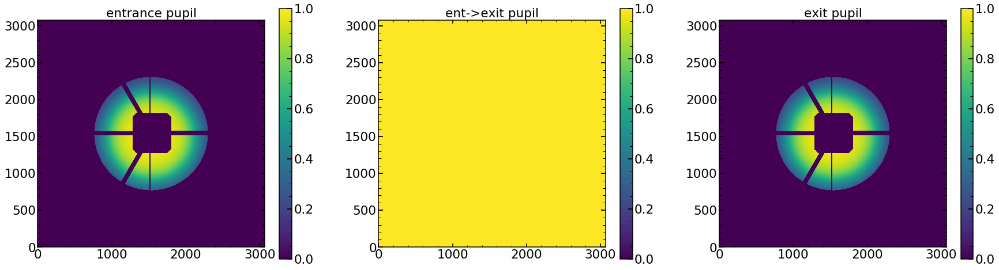

In [310]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

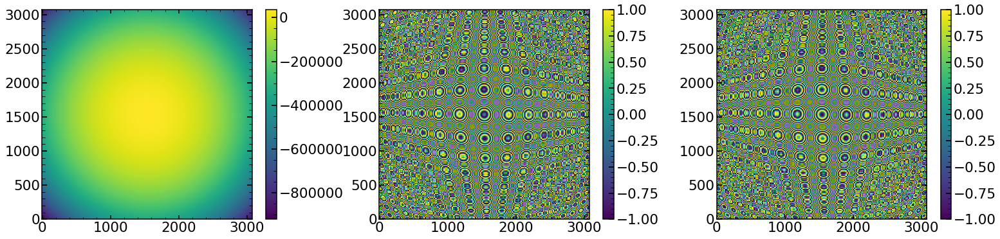

In [343]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

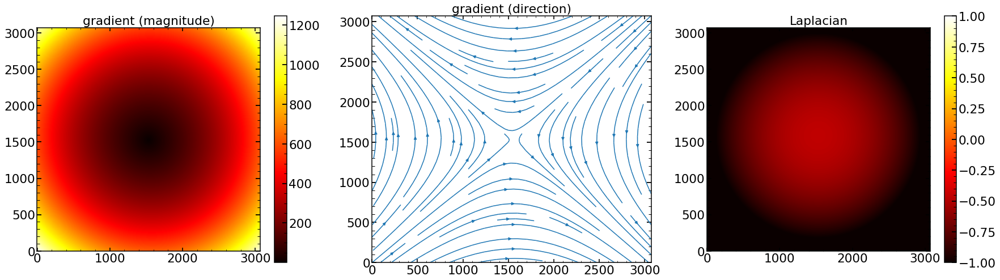

In [344]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

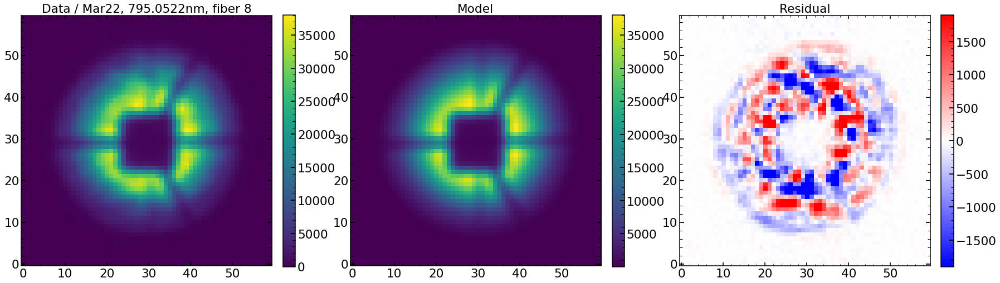

In [345]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / Mar22, '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus-sci_image,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 31.241247462994036
Abs of residual divided by total flux is: 0.054268873790371444
Abs of residual divided by largest value of a flux in the image is: 0.09865409592166614


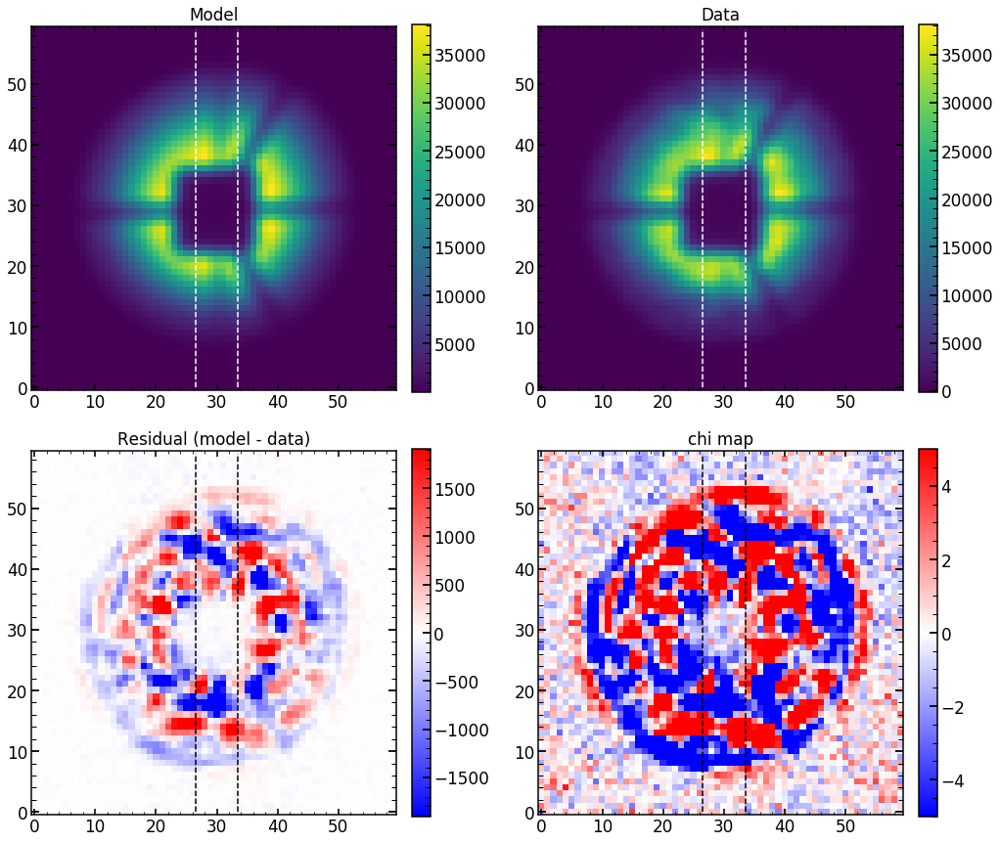

In [346]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

31.241247462994036
chi**2 reduced is: 31.241247462994036
Abs of residual divided by total flux is: 0.054268873790371444
Abs of residual divided by largest value of a flux in the image is: 0.09865409592166614


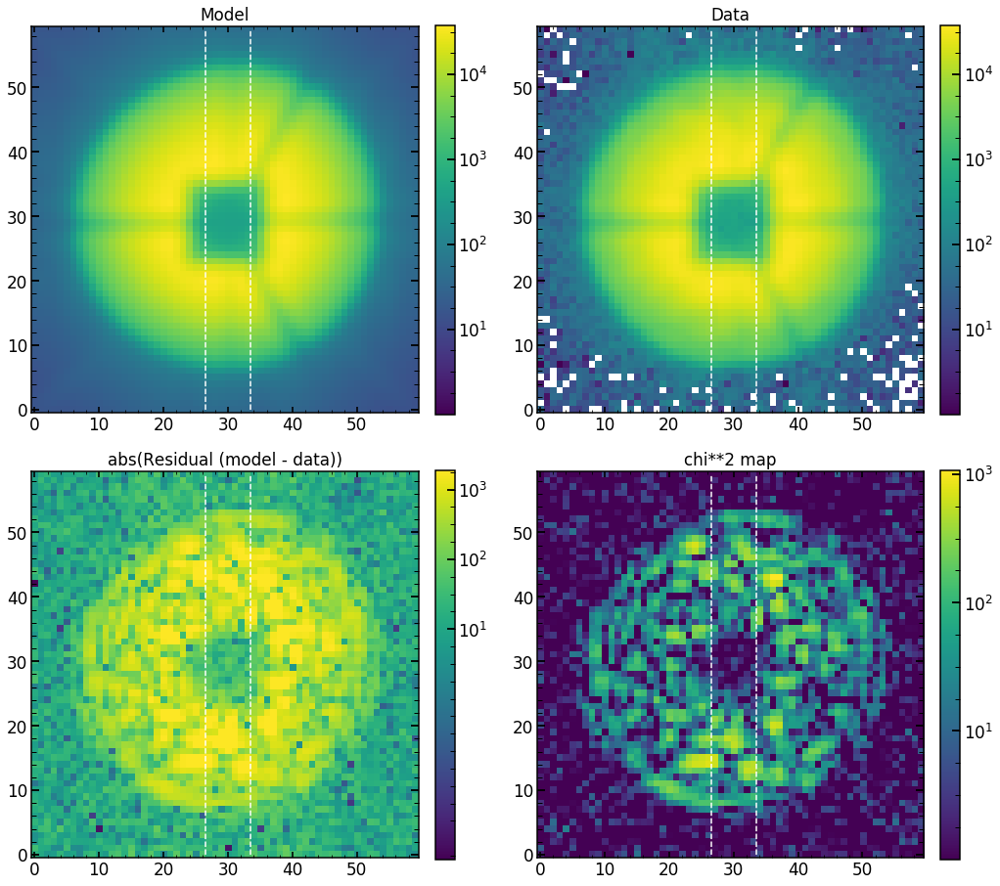

In [347]:
single_analysis.create_basic_comparison_plot_log()

## Codes

In [28]:
columns=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

columns11=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

columns11_analysis=columns+['chi2','chi2max']

columns22=['z4','z5','z6','z7','z8','z9','z10','z11',
           'z12','z13','z14','z15','z16','z17','z18','z19','z20','z21','z22',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

columns22_analysis=columns22+['chi2','chi2max']

def lin_fit_1D(x, a, b):
    return a * x + b

def lin_fit_1DConstant(x, b):
    return  np.full(len(x),b)

def lin_fit_2D(x,y, a, b,c):
    return a * x + b*y+c

In [29]:
def create_minchain_err(chain0,likechain0,sci_image,var_image,old=0):
    minchain_err_test=[]
    for var_number in range(len(columns)):
        #ravel likelihood
        likechain0_Emcee3_ravel=np.ravel(likechain0)

        # connect chain and lnchain
        chain0_Emcee3_ravel=np.ravel(chain0[:,:,var_number])
        chain0_Emcee3_ravel_argsort=np.argsort(chain0_Emcee3_ravel)  
        chain0_Emcee3_ravel_sort=chain0_Emcee3_ravel[chain0_Emcee3_ravel_argsort]
        likechain0_Emcee3_ravel_sort=likechain0_Emcee3_ravel[chain0_Emcee3_ravel_argsort]

        # move to chi2 space
        chi2_Emcee3_ravel_sort=-(np.array(likechain0_Emcee3_ravel_sort)*(2)-np.log(2*np.pi*np.sum(var_image)))/(sci_image.shape[0])**2
        min_chi2_Emcee3_ravel_sort=np.min(chi2_Emcee3_ravel_sort)

        # simplest standard deviation
        std_chain=np.std(chain0_Emcee3_ravel_sort)

        #best solution
        mean_chain=chain0_Emcee3_ravel_sort[chi2_Emcee3_ravel_sort==np.min(chi2_Emcee3_ravel_sort)][0]

        # step size
        step=std_chain/10

        # create result 3*std in each direction
        try:
            res=[]
            if step==0:
                step=10e-17
            for i in np.arange(mean_chain-30*step,mean_chain+30*step,step):
                selected_chi2_Emcee3_ravel_sort=chi2_Emcee3_ravel_sort[(np.array(chain0_Emcee3_ravel_sort<i+step)&np.array(chain0_Emcee3_ravel_sort>i))]
                if len(selected_chi2_Emcee3_ravel_sort>10):   
                    res.append([i+step/2,np.min(chi2_Emcee3_ravel_sort[(np.array(chain0_Emcee3_ravel_sort<i+step)&np.array(chain0_Emcee3_ravel_sort>i))])])

            res=np.array(res)

            #print(columns[var_number]+' min : '+str(mean_chain))
            #print(columns[var_number]+' std : '+str(std_chain))

            # find low limit and high limit
            res_within2_chi=res[res[:,1]<min_chi2_Emcee3_ravel_sort*2]
            minchain_err_element=[-np.abs(mean_chain-res_within2_chi[0,0]),np.abs(res_within2_chi[-1,0]-mean_chain)]
        except IndexError:
            if var_number!=25:
                print(columns[var_number]+': failed!')
                minchain_err_element=[-mean_chain,mean_chain]

        minchain_err_test.append(minchain_err_element)
        #print(columns[var_number]+' min_err : '+str(minchain_err_element[0]))
        #print(columns[var_number]+' max_err : '+str(minchain_err_element[1]))
    if old==1:
        minchain_err_test=np.mean(np.abs(np.array(minchain_err_test)),axis=1)
        #print(minchain_err_test)
        return minchain_err_test
    else:       
        return np.array(minchain_err_test)
    
    
import scipy.optimize as optimize
def curve_fit_custom_lin(V,index_arr,z4_arr,z4_arr_err_low,z4_arr_err_up):
    a,b=V
    yfit=lin_fit_1D(index_arr,a,b)
    weight=np.ones_like(yfit)
    weight[yfit>z4_arr]=z4_arr_err_up[yfit>z4_arr] # if the fit point is above the measure, use upper weight
    weight[yfit<=z4_arr]=z4_arr_err_low[yfit<=z4_arr] # else use lower weight
    return (yfit-z4_arr)**2/weight**2

def curve_fit_custom_con(V,index_arr,z4_arr,z4_arr_err_low,z4_arr_err_up):
    a=V
    yfit=lin_fit_1DConstant(index_arr,a)
    weight=np.ones_like(yfit)
    weight[yfit>z4_arr]=z4_arr_err_up[yfit>z4_arr] # if the fit point is above the measure, use upper weight
    weight[yfit<=z4_arr]=z4_arr_err_low[yfit<=z4_arr] # else use lower weight
    return (yfit-z4_arr)**2/weight**2 

In [30]:
def create_results_of_fit_single(date,single_number,arc=None,zMax=None):
    """create solution from a single image, create error and lower and upper erros

    @param[in] date             date when the analysis was conducted
    @param[in] single_number    number of the image
    @param[in] arc              which arc was analyzed
    @returns       results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper to be fed to solution_at_0_and_plots
    """
    print(zMax)
    if arc is None:
        arc='HgAr'
        
    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
        
    if zMax==22:
        columns_analysis=columns22_analysis
    else:
        columns_analysis=columns11_analysis
    
    results_of_fit_single=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)
    err_results_of_fit_single=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)
    err_results_of_fit_single_lower=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)
    err_results_of_fit_single_upper=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)

    # arrange all results in one pandas 
    #date='Sep19'
    #date='Sep27'
    RESULT_FOLDER='/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+str(date)+'/'

    single_defocus_list=obs_possibilites

    #single_number=55
    image_index=single_number
    method='P'
    eps=5

    res_likelihood=[]

    for single_defocus in range(0,len(single_defocus_list)):
        try:
            obs=single_defocus_list[single_defocus]
            try:
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                print(str(single_number)+' obs (Emcee3): '+str(obs)+' is found!')
            except:    
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                print(str(single_number)+'obs (Emcee2): '+str(obs)+' is found!')

            if obs==8600:
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
            else:       
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
                #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

 
            likechain0=likechain

            chain0=chain
            minchain=chain0[np.abs(likechain0)==np.min(np.abs(likechain0))][0]
            chi2reduced=2*np.min(np.abs(likechain0))/(sci_image.shape[0])**2
            #print(" test0")

            """
            minchain_err=[]
            for i in range(len(columns)):
                #minchain_err=np.append(minchain_err,np.std(chain0[:,:,i].flatten()))
                minchain_err=np.append(minchain_err,np.sqrt(chi2reduced)*np.std(chain0[:,:,i].flatten()))

            minchain_err=np.array(minchain_err)
            """
            minchain_err_old=create_minchain_err(chain0,likechain0,sci_image,var_image,old=1)
            #print(minchain_err_old)
            #print(" test1")
            minchain_err=create_minchain_err(chain0,likechain0,sci_image,var_image)
            #print(" test2")
            results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain,np.array([chi2reduced,np.mean(sci_image**2/var_image)])),axis=0)
            #print(" test3")
            #print(results_of_fit_single.iloc[single_defocus])
            err_results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain_err_old,np.array([1,1])),axis=0)
            #print(" test4")
            err_results_of_fit_single_lower.iloc[single_defocus]=np.concatenate((minchain_err[:,0],np.array([1,1])),axis=0)
            #print(" test5")
            err_results_of_fit_single_upper.iloc[single_defocus]=np.concatenate((minchain_err[:,1],np.array([1,1])),axis=0)
            #print(" test6")
        
        except:
            ValueError
            print(str(single_number)+' '+str(obs)+' '+str(arc)+' is NOT found or failed!')
    #results_of_fit_single=results_of_fit_single[np.abs(results_of_fit_single['z4'])>0]
    #err_results_of_fit_single=err_results_of_fit_single[np.abs(err_results_of_fit_single['z4'])>0]
    #err_results_of_fit_single_lower=err_results_of_fit_single_lower[np.abs(err_results_of_fit_single_lower['z4'])>0]
    #err_results_of_fit_single_upper=err_results_of_fit_single_upper[np.abs(err_results_of_fit_single_upper['z4'])>0]              
    
    return results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper


def create_results_of_fit_single_focus(date,single_number,arc=None,zMax=None):
    """create solution from a single image, create error and lower and upper erros

    @param[in] date             date when the analysis was conducted
    @param[in] single_number    number of the image
    @param[in] arc              which arc was analyzed
    @returns       results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper to be fed to solution_at_0_and_plots
    """
    print(zMax)
    if arc is None:
        arc='HgAr'
        
    if arc=='HgAr':
        obs_possibilites=np.array([11748])
    elif arc=='Ne':
        obs_possibilites=np.array([12355])
        
    if zMax==22:
        columns_analysis=columns22_analysis
    else:
        columns_analysis=columns11_analysis        
        
    if arc=='HgAr':
        labels=['11748']
    elif arc=='Ne':
        labels=['12355']

    results_of_fit_single=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)
    err_results_of_fit_single=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)
    err_results_of_fit_single_lower=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)
    err_results_of_fit_single_upper=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)

    # arrange all results in one pandas 
    #date='Sep19'
    #date='Sep27'
    RESULT_FOLDER='/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+str(date)+'/'

    single_defocus_list=obs_possibilites

    #single_number=55
    image_index=single_number
    method='P'
    eps=5

    res_likelihood=[]

    for single_defocus in range(0,len(single_defocus_list)):
        try:
            obs=single_defocus_list[single_defocus]
            try:
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                print(str(single_number)+' obs (Emcee3): '+str(obs)+' is found!')
            except:    
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                print(str(single_number)+'obs (Emcee2): '+str(obs)+' is found!')

            if obs==8600:
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
            else:       
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
                #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

 
            likechain0=likechain

            chain0=chain
            minchain=chain0[np.abs(likechain0)==np.min(np.abs(likechain0))][0]
            chi2reduced=2*np.min(np.abs(likechain0))/(sci_image.shape[0])**2
            #print(" test0")

            """
            minchain_err=[]
            for i in range(len(columns)):
                #minchain_err=np.append(minchain_err,np.std(chain0[:,:,i].flatten()))
                minchain_err=np.append(minchain_err,np.sqrt(chi2reduced)*np.std(chain0[:,:,i].flatten()))

            minchain_err=np.array(minchain_err)
            """
            minchain_err_old=create_minchain_err(chain0,likechain0,sci_image,var_image,old=1)
            #print(minchain_err_old)
            #print(" test1")
            minchain_err=create_minchain_err(chain0,likechain0,sci_image,var_image)
            #print(" test2")
            results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain,np.array([chi2reduced,np.mean(sci_image**2/var_image)])),axis=0)
            #print(" test3")
            #print(results_of_fit_single.iloc[single_defocus])
            err_results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain_err_old,np.array([1,1])),axis=0)
            #print(" test4")
            err_results_of_fit_single_lower.iloc[single_defocus]=np.concatenate((minchain_err[:,0],np.array([1,1])),axis=0)
            #print(" test5")
            err_results_of_fit_single_upper.iloc[single_defocus]=np.concatenate((minchain_err[:,1],np.array([1,1])),axis=0)
            #print(" test6")
        
        except:
            ValueError
            print(str(single_number)+' '+str(obs)+' '+str(arc)+' is NOT found or failed!')
    #results_of_fit_single=results_of_fit_single[np.abs(results_of_fit_single['z4'])>0]
    #err_results_of_fit_single=err_results_of_fit_single[np.abs(err_results_of_fit_single['z4'])>0]
    #err_results_of_fit_single_lower=err_results_of_fit_single_lower[np.abs(err_results_of_fit_single_lower['z4'])>0]
    #err_results_of_fit_single_upper=err_results_of_fit_single_upper[np.abs(err_results_of_fit_single_upper['z4'])>0]              
    
    return results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper

In [31]:
def solution_at_0_and_plots(date,single_number,arc,results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,plot=True,zMax=None):
    """create solution at the focus and plot dependence with defocu

    @param[in] date             date when the analysis was conducted
    @param[in] single_number    number of the image
    @param[in] arc              which arc was analyzed
  
    """    
    
    if zMax==22:
        columns_analysis=columns22_analysis
        columns=columns22
        z_addition_factor=11
    else:
        columns_analysis=columns11_analysis
        columns=columns11
        z_addition_factor=0
    
    results_of_fit_single=results_of_fit_single[np.abs(results_of_fit_single['z4'])>0]
    err_results_of_fit_single=err_results_of_fit_single[np.abs(err_results_of_fit_single['z4'])>0]
    err_results_of_fit_single_lower=err_results_of_fit_single_lower[np.abs(err_results_of_fit_single_lower['z4'])>0]
    err_results_of_fit_single_upper=err_results_of_fit_single_upper[np.abs(err_results_of_fit_single_upper['z4'])>0]    
    
    if len(results_of_fit_single)<=6:
        if zMax==22:
            solution_at_0=np.full(31+11,0)

        else:
            solution_at_0=np.full(31,0)       

        return solution_at_0
    else:
        IMAGES_FOLDER='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/'

        solution_at_0=[]

        for q in columns_analysis:

            z4_arr=np.array(results_of_fit_single[q])
            z4_arr_err=np.array(err_results_of_fit_single[q])
            z4_arr_err_up=np.array(err_results_of_fit_single_upper[q])
            z4_arr_err_low=np.array(err_results_of_fit_single_lower[q])
            index_arr=results_of_fit_single[q].index.values.astype(float)
            #print(q)
            #print(index_arr)
            #print(z4_arr)
            #print(z4_arr_err)
            #print(z4_arr_err_up)
            #print(z4_arr_err_low)
            
            z4_arr_no0=z4_arr[np.abs(index_arr)>0.5]
            z4_arr_no0_err=z4_arr_err[np.abs(index_arr)>0.5]
            z4_arr_no0_err_up=z4_arr_err_up[np.abs(index_arr)>0.5]
            z4_arr_no0_err_low=z4_arr_err_low[np.abs(index_arr)>0.5]
            index_arr_no0=index_arr[np.abs(index_arr)>0.5]
            #print(q)
            #print(index_arr_no0)
            #print(z4_arr_no0)
            #print(z4_arr_no0_err)
            #print(z4_arr_no0_err_up)
            #print(z4_arr_no0_err_low)
            
            
            z4_arr_only0=z4_arr[np.abs(index_arr)<=0.5]
            z4_arr_only0_err=z4_arr_err[np.abs(index_arr)<=0.5]
            z4_arr_only0_err_up=z4_arr_err_up[np.abs(index_arr)<=0.5] 
            z4_arr_only0_err_low=z4_arr_err_low[np.abs(index_arr)<=0.5]
            index_arr_only0=index_arr[np.abs(index_arr)<=0.5]

            fit_res=[]
            interim_zero_solutions=[]

            
            if q in columns[:8+z_addition_factor]:
                # these variables are fit via linear fit, without values at focus
                # it is z4-z11
                # for loop below removes 2 points from the fit that create largest deviations from median result in focus
                for l in range(len(index_arr_no0)):
                    #print('good_index'+str(np.delete(index_arr_no0,l)))
                    #print('index_arr_no0'+str(np.delete(z4_arr_no0,l)))
                    #print('z4_arr_no0_err_low'+str(np.delete(z4_arr_no0_err_low,l)))
                    #print('z4_arr_no0_err_up'+str(np.delete(z4_arr_no0_err_up,l)))
                    popt=optimize.leastsq(curve_fit_custom_lin,x0=[1,1],args=(np.delete(index_arr_no0,l),np.delete(z4_arr_no0,l), np.delete(z4_arr_no0_err_low,l),np.delete(z4_arr_no0_err_up,l)))[0]
                    interim_zero_solutions.append([l,lin_fit_1D(0,popt[0],popt[1])])
                interim_zero_solutions_arr=np.array(interim_zero_solutions)
                interim_zero_solutions_arr_dif=np.abs(interim_zero_solutions_arr[:,1]-np.median(interim_zero_solutions_arr[:,1]))
                second_max_dif=np.sort(interim_zero_solutions_arr_dif)[-2]
                interim_zero_solutions_arr=interim_zero_solutions_arr[interim_zero_solutions_arr_dif<second_max_dif]
                #print(interim_zero_solutions_arr[:,0])
                good_index=interim_zero_solutions_arr[:,0].astype(int)
                #print('good_index'+str(good_index))
                #print('index_arr_no0'+str(index_arr_no0))
                #print('z4_arr_no0_err_low'+str(z4_arr_no0_err_low))
                #print('z4_arr_no0_err_up'+str(z4_arr_no0_err_up))
                popt=optimize.leastsq(curve_fit_custom_lin,x0=[1,1],args=(np.array(index_arr_no0)[good_index],np.array(z4_arr_no0)[good_index],np.array(z4_arr_no0_err_low)[good_index],np.array(z4_arr_no0_err_up)[good_index]))[0]
                #print(popt)
                for i in np.linspace(-4.5,4.5,19):
                    fit_res.append(lin_fit_1D(i,popt[0],popt[1]))
                solution_at_0.append(fit_res[9])

            interim_zero_solutions=[]
            if q in columns[8+z_addition_factor:25+z_addition_factor]:
                # these variables are set at mean value (constant fit), without values at focus
                # these are variables that describe the pupil
                for l in range(len(index_arr_no0)):
                    popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(np.delete(index_arr_no0,l),np.delete(z4_arr_no0,l), np.delete(z4_arr_no0_err_low,l),np.delete(z4_arr_no0_err_up,l)))[0]
                    interim_zero_solutions.append([l,popt[0]])
                interim_zero_solutions_arr=np.array(interim_zero_solutions)
                interim_zero_solutions_arr_dif=np.abs(interim_zero_solutions_arr[:,1]-np.median(interim_zero_solutions_arr[:,1]))
                third_max_dif=np.sort(interim_zero_solutions_arr_dif)[-3]
                interim_zero_solutions_arr=interim_zero_solutions_arr[interim_zero_solutions_arr_dif<=(third_max_dif*1.1)]
                #print(interim_zero_solutions_arr[:,0])
                good_index=interim_zero_solutions_arr[:,0].astype(int)
                popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(np.array(index_arr_no0)[good_index],np.array(z4_arr_no0)[good_index],np.array(z4_arr_no0_err_low)[good_index],np.array(z4_arr_no0_err_up)[good_index]))[0]
                fit_res=lin_fit_1DConstant(np.linspace(-4.5,4.5,19),popt[0])
                solution_at_0.append(fit_res[9])

            if q in np.concatenate((np.array(columns[25+z_addition_factor:]),np.array(['chi2','chi2max'])),axis=0):
                # these variables are set at value as measured at 0 - (perhaps is should be close to 0)
                if z4_arr_only0.size==1:
                    for i in np.linspace(-4.5,4.5,19):
                        fit_res.append(z4_arr_only0) 
                    solution_at_0.append(fit_res[9])
                else:
                    # these variables are set at mean value (constant fit), without values at focus
                    popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(index_arr_only0, z4_arr_only0, z4_arr_only0_err_low,z4_arr_only0_err_up))[0]
                    fit_res=lin_fit_1DConstant(np.linspace(-4.5,4.5,19),popt[0])
                    solution_at_0.append(fit_res[9])


            #making plots here
            ######
            #print(q)
            #print(fit_res)
            plt.figure(figsize=(20,10))
            plt.errorbar(index_arr,z4_arr,yerr=[np.abs(z4_arr_err_low),z4_arr_err_up],color='blue',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='single fit results')
            plt.plot(np.linspace(-4.5,4.5,19),fit_res,color='orange',label='fit')
            if q in columns[:8]:
                plt.plot(np.linspace(-4.5,4.5,19),np.zeros((19,1)),':',color='black')
            plt.plot([0], [fit_res[9]], marker='o', markersize=10, color="red",label='prediction for focus')
            #print('prediction for focus: '+str(q)+' '+str(fit_res[9]))
            plt.title(q,size=40)
            plt.legend(fontsize=25)
            plt.xlabel('defocus lab [mm]',size=30)
            plt.ylabel('defocus model',size=30)
            #print(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/')
            if not os.path.exists(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/'):
                os.makedirs(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/')
            plt.savefig(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/'+str(arc)+str(q))

            if not os.path.exists(IMAGES_FOLDER+'Defocus/'+str(q)+'/'):
                os.makedirs(IMAGES_FOLDER+'Defocus/'+str(q)+'/')
            plt.savefig(IMAGES_FOLDER+'Defocus/'+str(q)+'/'+str(arc)+str(single_number))

            plt.close()   
            ######

        solution_at_0=np.array(solution_at_0)[:len(solution_at_0)-2]
        return solution_at_0

In [37]:
def residual_1D(sci_image,var_image,res_iapetus):

    #sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')    
    multiplicative_factor_to_renormalize_to_50000=np.max(sci_image)/50000
    sci_image_smaller=sci_image[:,8:14]/multiplicative_factor_to_renormalize_to_50000
    var_image_smaller=var_image[:,8:14]/multiplicative_factor_to_renormalize_to_50000

    residual_initial_smaller=sci_image_smaller-res_iapetus[:,8:14]/multiplicative_factor_to_renormalize_to_50000
    #residual_RF_smaller=chi_RF_corrected_image[:,8:14]*np.sqrt(var_image_smaller)

    #################################
    # step 5 from Horne, very simplified
    inputimage_smaller=sci_image_smaller
    Px=np.sum(inputimage_smaller,axis=0)/np.sum(inputimage_smaller)
    var_inputimage_smaller=var_image_smaller
    #################################
    # Equation 8 from Horne with modification from Robert abut variance for extraction of signal
    # note that this uses profile from full thing, and not "residual profile"

    # nominator
    weighted_inputimage_smaller=inputimage_smaller*Px/(1)
    # denominator
    weights_array=np.ones((inputimage_smaller.shape[0],inputimage_smaller.shape[1]))*Px**2

    init_lamda=np.array(list(map(np.sum, weighted_inputimage_smaller)))/(np.array(list(map(np.sum,weights_array))))
    init_lamda_boxcar=np.array(list(map(np.sum, inputimage_smaller)))
    # Equation 8.5 from Horne
    var_f_std_lamda=1/np.sum(np.array(Px**2/(var_inputimage_smaller)),axis=1)
    std_init_lamda=np.sqrt(var_f_std_lamda)
    std_init_lamda_boxcar=np.sqrt(np.array(list(map(np.sum, var_inputimage_smaller))))


    #################################
    # Equation 8 from Horne with modification from Robert abut variance for initial removal
    # note that this uses profile from full thing, and not "residual profile"

    # nominator
    weighted_inputimage_smaller=residual_initial_smaller*Px/(1)
    # denominator
    weights_array=np.ones((residual_initial_smaller.shape[0],residual_initial_smaller.shape[1]))*Px**2

    init_removal_lamda=np.array(list(map(np.sum, weighted_inputimage_smaller)))/(np.array(list(map(np.sum,weights_array))))
    init_removal_lamda_boxcar=np.array(list(map(np.sum, residual_initial_smaller)))
    # Equation 8.5 from Horne
    var_init_removal_lamda=1/np.sum(np.array(Px**2/(var_inputimage_smaller)),axis=1)
    std_init_removal_lamda=np.sqrt(var_init_removal_lamda)
    return init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda

def chi_50000(sci_image,var_image,res_iapetus):

    #sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')    
    multiplicative_factor_to_renormalize_to_50000=np.max(sci_image)/50000
    sci_image_renormalized=sci_image/multiplicative_factor_to_renormalize_to_50000
    var_image_renormalized=var_image/multiplicative_factor_to_renormalize_to_50000
    res_iapetus_renormalized=res_iapetus/multiplicative_factor_to_renormalize_to_50000
    

    return np.mean((sci_image_renormalized-res_iapetus_renormalized)**2/var_image_renormalized)


In [102]:
def add_artificial_noise(sci_image,var_image,res_iapetus):
    multi_factor=np.max(sci_image)/40000
    Max_SN_now=np.max(sci_image)/np.max(np.sqrt(var_image))
    dif_in_SN=Max_SN_now/200
    artifical_noise=np.zeros_like(res_iapetus)
    artifical_noise=np.array(artifical_noise)
    for i in range(len(artifical_noise)):
        for j in range(len(artifical_noise)):
            artifical_noise[i,j]=np.random.randn()*np.sqrt((dif_in_SN**2-1)*var_image[i,j])   
            
    if dif_in_SN>1:        
        return (sci_image+artifical_noise),((dif_in_SN**2)*var_image),res_iapetus
    else:
        return (sci_image),((dif_in_SN**2)*var_image),res_iapetus        


## Creation of pandas dataframe

In [356]:
#single_number_for_single_pos_full=np.load("/Users/nevencaplar/Documents/PFS/2017-12-15/single_number_for_single_pos_full.npy") 

results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalHgAr_Feb2019.index,columns=columns11_analysis)
err_results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalHgAr_Feb2019.index,columns=columns11_analysis)

results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_defocus_HgAr)
err_results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_HgAr)

results_of_fit_many_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

label=['m4','m35','m3','m25','m2','m15','m1','m05','0','0d','p05','p1','p15','p2','p25','p3','p35','p4','0p']

for single_number in range(len(finalHgAr_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single('March22',single_number,'HgAr',11)
    solution_at_0=solution_at_0_and_plots('March22',single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,11)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_HgAr[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_HgAr[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_HgAr[label[i]]=results_of_fit_many_HgAr[label[i]][np.abs(results_of_fit_many_HgAr[label[i]]['z4'])>0]



11
0 11796 HgAr is NOT found or failed!
0 11790 HgAr is NOT found or failed!
0 11784 HgAr is NOT found or failed!
0 11778 HgAr is NOT found or failed!
0 11772 HgAr is NOT found or failed!
0 11766 HgAr is NOT found or failed!
0 11760 HgAr is NOT found or failed!
0 11754 HgAr is NOT found or failed!
0 11748 HgAr is NOT found or failed!
0 11748 HgAr is NOT found or failed!
0 11694 HgAr is NOT found or failed!
0 11700 HgAr is NOT found or failed!
0 11706 HgAr is NOT found or failed!
0 11712 HgAr is NOT found or failed!
0 11718 HgAr is NOT found or failed!
0 11724 HgAr is NOT found or failed!
0 11730 HgAr is NOT found or failed!
0 11736 HgAr is NOT found or failed!
11
1 11796 HgAr is NOT found or failed!
1 11790 HgAr is NOT found or failed!
1 11784 HgAr is NOT found or failed!
1 11778 HgAr is NOT found or failed!
1 11772 HgAr is NOT found or failed!
1 11766 HgAr is NOT found or failed!
1 obs (Emcee3): 11760 is found!
radiometricExponent: failed!
radiometricExponent: failed!
1 obs (Emcee3): 

9 obs (Emcee3): 11790 is found!
radiometricExponent: failed!
radiometricExponent: failed!
9 obs (Emcee3): 11784 is found!
9 11778 HgAr is NOT found or failed!
9 11772 HgAr is NOT found or failed!
9 11766 HgAr is NOT found or failed!
9 obs (Emcee3): 11760 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
9 obs (Emcee3): 11754 is found!
radiometricEffect: failed!
y_ilum: failed!
radiometricEffect: failed!
y_ilum: failed!
9 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
9 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
9 obs (Emcee3): 11694 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!

18 obs (Emcee3): 11784 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
18 11778 HgAr is NOT found or failed!
18 11772 HgAr is NOT found or failed!
18 11766 HgAr is NOT found or failed!
18 obs (Emcee3): 11760 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
18 obs (Emcee3): 11754 is found!
radiometricEffect: failed!
radiometricEffect: failed!
18 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
18 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
18 obs (Emcee3): 11694 is found!
radiometricEffect: f

38 11736 HgAr is NOT found or failed!
11
39 11796 HgAr is NOT found or failed!
39 11790 HgAr is NOT found or failed!
39 11784 HgAr is NOT found or failed!
39 11778 HgAr is NOT found or failed!
39 11772 HgAr is NOT found or failed!
39 11766 HgAr is NOT found or failed!
39 11760 HgAr is NOT found or failed!
39 11754 HgAr is NOT found or failed!
39 11748 HgAr is NOT found or failed!
39 11748 HgAr is NOT found or failed!
39 11694 HgAr is NOT found or failed!
39 11700 HgAr is NOT found or failed!
39 11706 HgAr is NOT found or failed!
39 11712 HgAr is NOT found or failed!
39 11718 HgAr is NOT found or failed!
39 11724 HgAr is NOT found or failed!
39 11730 HgAr is NOT found or failed!
39 11736 HgAr is NOT found or failed!
11
40 11796 HgAr is NOT found or failed!
40 11790 HgAr is NOT found or failed!
40 11784 HgAr is NOT found or failed!
40 11778 HgAr is NOT found or failed!
40 11772 HgAr is NOT found or failed!
40 11766 HgAr is NOT found or failed!
40 11760 HgAr is NOT found or failed!
40 117

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
49 11706 HgAr is NOT found or failed!
49 11712 HgAr is NOT found or failed!
49 11718 HgAr is NOT found or failed!
49 obs (Emcee3): 11724 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
49 11730 HgAr is NOT found or failed!
49 obs (Emcee3): 11736 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
11
50 11796 HgAr is NOT found or failed!
50 11790 HgAr is NOT found or failed!
50 11784 HgAr is NOT found or failed!
50 11778 HgAr is NOT found or failed!
50 11772 HgAr is NOT found or failed!
50 11766 HgAr is NOT found or failed!
50 11760 HgAr is NOT found or failed!
50 11754 HgAr is NOT found or failed!
50 11748 HgAr is NOT found or failed!
50 11748 HgAr is 

radiometricExponent: failed!
57 obs (Emcee3): 11736 is found!
y_ilum: failed!
y_ilum: failed!
11
58 11796 HgAr is NOT found or failed!
58 11790 HgAr is NOT found or failed!
58 11784 HgAr is NOT found or failed!
58 11778 HgAr is NOT found or failed!
58 11772 HgAr is NOT found or failed!
58 11766 HgAr is NOT found or failed!
58 11760 HgAr is NOT found or failed!
58 11754 HgAr is NOT found or failed!
58 11748 HgAr is NOT found or failed!
58 11748 HgAr is NOT found or failed!
58 11694 HgAr is NOT found or failed!
58 11700 HgAr is NOT found or failed!
58 11706 HgAr is NOT found or failed!
58 11712 HgAr is NOT found or failed!
58 11718 HgAr is NOT found or failed!
58 11724 HgAr is NOT found or failed!
58 11730 HgAr is NOT found or failed!
58 11736 HgAr is NOT found or failed!
11
59 obs (Emcee3): 11796 is found!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
59 obs (Emcee3): 11790 is found!
radiom

66 obs (Emcee3): 11790 is found!
radiometricExponent: failed!
radiometricExponent: failed!
66 obs (Emcee3): 11784 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
66 11778 HgAr is NOT found or failed!
66 11772 HgAr is NOT found or failed!
66 11766 HgAr is NOT found or failed!
66 obs (Emcee3): 11760 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
66 obs (Emcee3): 11754 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
66 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricEffect: failed!
66 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricEffect: failed!
66 obs (Emcee3): 11694 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricE

radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
73 obs (Emcee3): 11748 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
73 obs (Emcee3): 11748 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
73 obs (Emcee3): 11694 is found!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
73 obs (Emcee3): 11700 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
73 11706 HgAr is NOT found or failed!
73 11712 HgAr is NOT found or failed!
73 11718 HgAr is NOT found or failed!
73 11724 HgAr is NOT found or failed!
73 obs (Emcee3): 11730 is found!
radiometricEffect: failed!
x_ilum: failed!
radi

81 11706 HgAr is NOT found or failed!
81 11712 HgAr is NOT found or failed!
81 11718 HgAr is NOT found or failed!
81 obs (Emcee3): 11724 is found!
81 obs (Emcee3): 11730 is found!
81 obs (Emcee3): 11736 is found!
11
82 11796 HgAr is NOT found or failed!
82 11790 HgAr is NOT found or failed!
82 11784 HgAr is NOT found or failed!
82 11778 HgAr is NOT found or failed!
82 11772 HgAr is NOT found or failed!
82 11766 HgAr is NOT found or failed!
82 11760 HgAr is NOT found or failed!
82 11754 HgAr is NOT found or failed!
82 11748 HgAr is NOT found or failed!
82 11748 HgAr is NOT found or failed!
82 11694 HgAr is NOT found or failed!
82 11700 HgAr is NOT found or failed!
82 11706 HgAr is NOT found or failed!
82 11712 HgAr is NOT found or failed!
82 11718 HgAr is NOT found or failed!
82 11724 HgAr is NOT found or failed!
82 11730 HgAr is NOT found or failed!
82 11736 HgAr is NOT found or failed!
11
83 obs (Emcee3): 11796 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: 

radiometricEffect: failed!
radiometricExponent: failed!
90 obs (Emcee3): 11790 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
90 obs (Emcee3): 11784 is found!
90 11778 HgAr is NOT found or failed!
90 11772 HgAr is NOT found or failed!
90 11766 HgAr is NOT found or failed!
90 obs (Emcee3): 11760 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
90 obs (Emcee3): 11754 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
90 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
90 obs (Emcee3): 11

97 obs (Emcee3): 11784 is found!
radiometricExponent: failed!
radiometricExponent: failed!
97 11778 HgAr is NOT found or failed!
97 11772 HgAr is NOT found or failed!
97 11766 HgAr is NOT found or failed!
97 obs (Emcee3): 11760 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
97 obs (Emcee3): 11754 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
97 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
97 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent:

105 obs (Emcee3): 11784 is found!
105 11778 HgAr is NOT found or failed!
105 11772 HgAr is NOT found or failed!
105 11766 HgAr is NOT found or failed!
105 obs (Emcee3): 11760 is found!
radiometricExponent: failed!
radiometricExponent: failed!
105 obs (Emcee3): 11754 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
105 obs (Emcee3): 11748 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
105 obs (Emcee3): 11748 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
105 11694 HgAr is NOT found or failed!
105 obs (Emcee3): 11700 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
105 11706 HgAr is NOT found or failed!
105 11712 HgAr is NOT found or failed!
105 11718 HgAr is NOT found or failed!
105 11724 HgAr is NOT found or failed!
10

x_ilum: failed!
114 obs (Emcee3): 11790 is found!
y_ilum: failed!
y_ilum: failed!
114 obs (Emcee3): 11784 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
114 11778 HgAr is NOT found or failed!
114 11772 HgAr is NOT found or failed!
114 11766 HgAr is NOT found or failed!
114 obs (Emcee3): 11760 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
114 obs (Emcee3): 11754 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
114 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
114 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radio

121 11784 HgAr is NOT found or failed!
121 11778 HgAr is NOT found or failed!
121 11772 HgAr is NOT found or failed!
121 11766 HgAr is NOT found or failed!
121 11760 HgAr is NOT found or failed!
121 11754 HgAr is NOT found or failed!
121 11748 HgAr is NOT found or failed!
121 11748 HgAr is NOT found or failed!
121 11694 HgAr is NOT found or failed!
121 11700 HgAr is NOT found or failed!
121 11706 HgAr is NOT found or failed!
121 11712 HgAr is NOT found or failed!
121 11718 HgAr is NOT found or failed!
121 11724 HgAr is NOT found or failed!
121 11730 HgAr is NOT found or failed!
121 11736 HgAr is NOT found or failed!
11
122 11796 HgAr is NOT found or failed!
122 11790 HgAr is NOT found or failed!
122 11784 HgAr is NOT found or failed!
122 11778 HgAr is NOT found or failed!
122 11772 HgAr is NOT found or failed!
122 11766 HgAr is NOT found or failed!
122 11760 HgAr is NOT found or failed!
122 11754 HgAr is NOT found or failed!
122 11748 HgAr is NOT found or failed!
122 11748 HgAr is NOT 

radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
129 11730 HgAr is NOT found or failed!
129 obs (Emcee3): 11736 is found!
11
130 11796 HgAr is NOT found or failed!
130 11790 HgAr is NOT found or failed!
130 11784 HgAr is NOT found or failed!
130 11778 HgAr is NOT found or failed!
130 11772 HgAr is NOT found or failed!
130 11766 HgAr is NOT found or failed!
130 11760 HgAr is NOT found or failed!
130 11754 HgAr is NOT found or failed!
130 11748 HgAr is NOT found or failed!
130 11748 HgAr is NOT found or failed!
130 11694 HgAr is NOT found or failed!
130 11700 HgAr is NOT found or failed!
130 11706 HgAr is NOT found or failed!
130 11712 HgAr is NOT found or failed!
130 11718 HgAr is NOT found or failed!
130 11724 HgAr is NOT found or failed!
130 11730 HgAr is NOT found or failed!
130 11736 HgAr is NOT found or failed!
11
131 obs (Emcee3): 11796 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
radiometricEffect: fail

138 obs (Emcee3): 11790 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
138 obs (Emcee3): 11784 is found!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
138 11778 HgAr is NOT found or failed!
138 11772 HgAr is NOT found or failed!
138 11766 HgAr is NOT found or failed!
138 obs (Emcee3): 11760 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
138 obs (Emcee3): 11754 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
138 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: f

radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
145 obs (Emcee3): 11784 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
145 11778 HgAr is NOT found or failed!
145 11772 HgAr is NOT found or failed!
145 11766 HgAr is NOT found or failed!
145 obs (Emcee3): 11760 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
145 obs (Emcee3): 11754 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
145 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y

153 obs (Emcee3): 11790 is found!
x_ilum: failed!
x_ilum: failed!
153 obs (Emcee3): 11784 is found!
153 11778 HgAr is NOT found or failed!
153 11772 HgAr is NOT found or failed!
153 11766 HgAr is NOT found or failed!
153 obs (Emcee3): 11760 is found!
radiometricEffect: failed!
radiometricEffect: failed!
153 obs (Emcee3): 11754 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
153 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
153 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
153 obs (Emcee3): 11694 is found!
radiometricEffect: failed!
y_ilum: failed!
radiometricEffect: failed!
y_ilum: failed!
153 obs (Emcee3): 11700 is foun

x_ilum: failed!
162 obs (Emcee3): 11784 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
162 11778 HgAr is NOT found or failed!
162 11772 HgAr is NOT found or failed!
162 11766 HgAr is NOT found or failed!
162 obs (Emcee3): 11760 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
162 obs (Emcee3): 11754 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
162 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
162 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponen

169 11778 HgAr is NOT found or failed!
169 11772 HgAr is NOT found or failed!
169 11766 HgAr is NOT found or failed!
169 obs (Emcee3): 11760 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
169 obs (Emcee3): 11754 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
169 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
169 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
169 obs (Emcee3): 11694 is found!
radiometr

177 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
177 obs (Emcee3): 11694 is found!
radiometricEffect: failed!
x_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
177 obs (Emcee3): 11700 is found!
177 11706 HgAr is NOT found or failed!
177 11712 HgAr is NOT found or failed!
177 11718 HgAr is NOT found or failed!
177 obs (Emcee3): 11724 is found!
177 obs (Emcee3): 11730 is found!
y_ilum: failed!
y_ilum: failed!
177 obs (Emcee3): 11736 is found!
11
178 11796 HgAr is NOT found or failed!
178 11790 HgAr is NOT found or failed!
178 11784 HgAr is NOT found or failed!
178 11778 HgAr is NOT found or failed!
178 11772 HgAr is NOT found or failed!
178 11766 HgAr is NOT found or failed!
178 11760 HgAr is NOT found or failed!
178 11754 HgAr is NOT found or failed!
178 11748 HgAr is NOT found or failed!
178 11748 HgAr is NOT found or 

radiometricExponent: failed!
186 11778 HgAr is NOT found or failed!
186 11772 HgAr is NOT found or failed!
186 11766 HgAr is NOT found or failed!
186 11760 HgAr is NOT found or failed!
186 obs (Emcee3): 11754 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
186 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
186 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
186 obs (Emcee3): 11694 is found!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
186 obs (Emcee3): 11700 is found!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
radiometricEffect

In [357]:
results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalNe_Feb2019.index,columns=columns11_analysis)
err_results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalNe_Feb2019.index,columns=columns11_analysis)

results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(results_of_fit_many_single_defocus_Ne)
err_results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_Ne)


results_of_fit_many_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

for single_number in range(len(finalNe_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single('March22',single_number,'Ne',11)
    solution_at_0=solution_at_0_and_plots('March22',single_number,'Ne',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,11)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_Ne[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_Ne[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_Ne[label[i]]=results_of_fit_many_Ne[label[i]][np.abs(results_of_fit_many_Ne[label[i]]['z4'])>0]


11
0 12403 Ne is NOT found or failed!
0 12397 Ne is NOT found or failed!
0 12391 Ne is NOT found or failed!
0 12385 Ne is NOT found or failed!
0 12379 Ne is NOT found or failed!
0 12373 Ne is NOT found or failed!
0 12367 Ne is NOT found or failed!
0 12361 Ne is NOT found or failed!
0 12355 Ne is NOT found or failed!
0 12355 Ne is NOT found or failed!
0 12349 Ne is NOT found or failed!
0 12343 Ne is NOT found or failed!
0 12337 Ne is NOT found or failed!
0 12331 Ne is NOT found or failed!
0 12325 Ne is NOT found or failed!
0 12319 Ne is NOT found or failed!
0 12313 Ne is NOT found or failed!
0 12307 Ne is NOT found or failed!
11
1 12403 Ne is NOT found or failed!
1 12397 Ne is NOT found or failed!
1 12391 Ne is NOT found or failed!
1 12385 Ne is NOT found or failed!
1 12379 Ne is NOT found or failed!
1 12373 Ne is NOT found or failed!
1 12367 Ne is NOT found or failed!
1 12361 Ne is NOT found or failed!
1 12355 Ne is NOT found or failed!
1 12355 Ne is NOT found or failed!
1 12349 Ne is 

11 obs (Emcee3): 12397 is found!
11 obs (Emcee3): 12391 is found!
11 12385 Ne is NOT found or failed!
11 12379 Ne is NOT found or failed!
11 12373 Ne is NOT found or failed!
11 obs (Emcee3): 12367 is found!
11 obs (Emcee3): 12361 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
11 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
11 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
11 obs (Emcee3): 12349 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
11 obs (Emcee3): 12343 is found!
radiometricEffect: failed!
x_ilum: f

20 12403 Ne is NOT found or failed!
20 12397 Ne is NOT found or failed!
20 12391 Ne is NOT found or failed!
20 12385 Ne is NOT found or failed!
20 12379 Ne is NOT found or failed!
20 12373 Ne is NOT found or failed!
20 12367 Ne is NOT found or failed!
20 12361 Ne is NOT found or failed!
20 12355 Ne is NOT found or failed!
20 12355 Ne is NOT found or failed!
20 12349 Ne is NOT found or failed!
20 12343 Ne is NOT found or failed!
20 12337 Ne is NOT found or failed!
20 12331 Ne is NOT found or failed!
20 12325 Ne is NOT found or failed!
20 12319 Ne is NOT found or failed!
20 12313 Ne is NOT found or failed!
20 12307 Ne is NOT found or failed!
11
21 12403 Ne is NOT found or failed!
21 12397 Ne is NOT found or failed!
21 12391 Ne is NOT found or failed!
21 12385 Ne is NOT found or failed!
21 12379 Ne is NOT found or failed!
21 12373 Ne is NOT found or failed!
21 12367 Ne is NOT found or failed!
21 12361 Ne is NOT found or failed!
21 12355 Ne is NOT found or failed!
21 12355 Ne is NOT found 

11
35 12403 Ne is NOT found or failed!
35 12397 Ne is NOT found or failed!
35 12391 Ne is NOT found or failed!
35 12385 Ne is NOT found or failed!
35 12379 Ne is NOT found or failed!
35 12373 Ne is NOT found or failed!
35 12367 Ne is NOT found or failed!
35 12361 Ne is NOT found or failed!
35 12355 Ne is NOT found or failed!
35 12355 Ne is NOT found or failed!
35 12349 Ne is NOT found or failed!
35 12343 Ne is NOT found or failed!
35 12337 Ne is NOT found or failed!
35 12331 Ne is NOT found or failed!
35 12325 Ne is NOT found or failed!
35 12319 Ne is NOT found or failed!
35 12313 Ne is NOT found or failed!
35 12307 Ne is NOT found or failed!
11
36 12403 Ne is NOT found or failed!
36 12397 Ne is NOT found or failed!
36 12391 Ne is NOT found or failed!
36 12385 Ne is NOT found or failed!
36 12379 Ne is NOT found or failed!
36 12373 Ne is NOT found or failed!
36 12367 Ne is NOT found or failed!
36 12361 Ne is NOT found or failed!
36 12355 Ne is NOT found or failed!
36 12355 Ne is NOT fou

42 12337 Ne is NOT found or failed!
42 12331 Ne is NOT found or failed!
42 12325 Ne is NOT found or failed!
42 obs (Emcee3): 12319 is found!
42 obs (Emcee3): 12313 is found!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
42 12307 Ne is NOT found or failed!
11
43 12403 Ne is NOT found or failed!
43 12397 Ne is NOT found or failed!
43 12391 Ne is NOT found or failed!
43 12385 Ne is NOT found or failed!
43 12379 Ne is NOT found or failed!
43 12373 Ne is NOT found or failed!
43 12367 Ne is NOT found or failed!
43 obs (Emcee3): 12361 is found!
43 12355 Ne is NOT found or failed!
43 12355 Ne is NOT found or failed!
43 12349 Ne is NOT found or failed!
43 12343 Ne is NOT found or failed!
43 12337 Ne is NOT found or failed!
43 12331 Ne is NOT found or failed!
43 12325 Ne is NOT found or failed!
43 12319 Ne is NOT found or failed!
43 12313 Ne is NOT found or failed!
43 12307 Ne is NOT found or failed

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
51 obs (Emcee3): 12349 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
51 obs (Emcee3): 12343 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
51 12337 Ne is NOT found or failed!
51 12331 Ne is NOT found or failed!
51 12325 Ne is NOT found or failed!
51 obs (Emcee3): 12319 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
51 obs (Emcee3): 12313 is found!
y_ilum: failed!
y_ilum: failed!
51 obs (Emcee3): 12307 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
11
52 12403 Ne is NOT found or failed!
52 

radiometricExponent: failed!
radiometricExponent: failed!
60 obs (Emcee3): 12391 is found!
x_ilum: failed!
x_ilum: failed!
60 12385 Ne is NOT found or failed!
60 12379 Ne is NOT found or failed!
60 12373 Ne is NOT found or failed!
60 obs (Emcee3): 12367 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
60 obs (Emcee3): 12361 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
60 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
60 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
60 12349 Ne is NOT found or failed!
60 obs (Emcee3): 12343 is found!
radiometricEffect: failed!
radiome

68 obs (Emcee3): 12343 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
68 12337 Ne is NOT found or failed!
68 12331 Ne is NOT found or failed!
68 12325 Ne is NOT found or failed!
68 obs (Emcee3): 12319 is found!
68 obs (Emcee3): 12313 is found!
radiometricExponent: failed!
radiometricExponent: failed!
68 obs (Emcee3): 12307 is found!
11
69 obs (Emcee3): 12403 is found!
radiometricEffect: failed!
x_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
69 obs (Emcee3): 12397 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
69 obs (Emcee3): 12391 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
69 12385 Ne is NOT found or failed!
69 12379 Ne is NOT found or failed!
69 1

radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
77 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
77 obs (Emcee3): 12349 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
77 obs (Emcee3): 12343 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
77 12337 Ne is NOT found or failed!
77 12331 Ne is NOT found or failed!
77 12325 Ne is NOT found or failed!
77 obs (Emcee3): 12319 is found!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
77 obs (Emcee3): 12313 is found!
77 obs (Emcee3): 12307 is found!
y_ilum: failed!
y_ilum: failed!
11
78 obs (Emcee3): 12403 is found!
radiometricExponent: failed!
radiome

86 obs (Emcee3): 12391 is found!
86 12385 Ne is NOT found or failed!
86 12379 Ne is NOT found or failed!
86 12373 Ne is NOT found or failed!
86 obs (Emcee3): 12367 is found!
radiometricEffect: failed!
radiometricEffect: failed!
86 obs (Emcee3): 12361 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
86 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
radiometricEffect: failed!
radiometricExponent: failed!
86 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
radiometricEffect: failed!
radiometricExponent: failed!
86 obs (Emcee3): 12349 is found!
x_ilum: failed!
x_ilum: failed!
86 obs (Emcee3): 12343 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!

95 obs (Emcee3): 12397 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
95 obs (Emcee3): 12391 is found!
radiometricExponent: failed!
radiometricExponent: failed!
95 12385 Ne is NOT found or failed!
95 12379 Ne is NOT found or failed!
95 12373 Ne is NOT found or failed!
95 obs (Emcee3): 12367 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
95 obs (Emcee3): 12361 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
95 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
95 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!


104 obs (Emcee3): 12397 is found!
radiometricEffect: failed!
radiometricEffect: failed!
104 obs (Emcee3): 12391 is found!
104 12385 Ne is NOT found or failed!
104 12379 Ne is NOT found or failed!
104 12373 Ne is NOT found or failed!
104 obs (Emcee3): 12367 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
104 obs (Emcee3): 12361 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
104 obs (Emcee3): 12355 is found!
x_ilum: failed!
x_ilum: failed!
104 obs (Emcee3): 12355 is found!
x_ilum: failed!
x_ilum: failed!
104 obs (Emcee3): 12349 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
104 o

113 obs (Emcee3): 12397 is found!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
113 obs (Emcee3): 12391 is found!
x_ilum: failed!
x_ilum: failed!
113 12385 Ne is NOT found or failed!
113 12379 Ne is NOT found or failed!
113 12373 Ne is NOT found or failed!
113 obs (Emcee3): 12367 is found!
y_ilum: failed!
y_ilum: failed!
113 obs (Emcee3): 12361 is found!
x_ilum: failed!
x_ilum: failed!
113 12355 Ne is NOT found or failed!
113 12355 Ne is NOT found or failed!
113 obs (Emcee3): 12349 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
113 obs (Emcee3): 12343 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
113 12337 Ne is NOT found or failed!
113 12331 Ne is NOT found or failed!
113 12325 Ne is NOT found or failed!
113 obs (Emcee3): 12319 is found!
113 obs (Emcee3): 

122 obs (Emcee3): 12397 is found!
z6: failed!
radiometricExponent: failed!
y_ilum: failed!
scattering_slope: failed!
z6: failed!
radiometricExponent: failed!
y_ilum: failed!
scattering_slope: failed!
122 obs (Emcee3): 12391 is found!
x_ilum: failed!
x_ilum: failed!
122 12385 Ne is NOT found or failed!
122 12379 Ne is NOT found or failed!
122 12373 Ne is NOT found or failed!
122 obs (Emcee3): 12367 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
122 obs (Emcee3): 12361 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
122 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
122 obs (Emcee3): 12355 is found!
radiometricEf

radiometricExponent: failed!
radiometricExponent: failed!
128 obs (Emcee3): 12307 is found!
11
129 12403 Ne is NOT found or failed!
129 12397 Ne is NOT found or failed!
129 12391 Ne is NOT found or failed!
129 12385 Ne is NOT found or failed!
129 12379 Ne is NOT found or failed!
129 12373 Ne is NOT found or failed!
129 12367 Ne is NOT found or failed!
129 12361 Ne is NOT found or failed!
129 12355 Ne is NOT found or failed!
129 12355 Ne is NOT found or failed!
129 12349 Ne is NOT found or failed!
129 12343 Ne is NOT found or failed!
129 12337 Ne is NOT found or failed!
129 12331 Ne is NOT found or failed!
129 12325 Ne is NOT found or failed!
129 12319 Ne is NOT found or failed!
129 12313 Ne is NOT found or failed!
129 12307 Ne is NOT found or failed!
11
130 12403 Ne is NOT found or failed!
130 12397 Ne is NOT found or failed!
130 12391 Ne is NOT found or failed!
130 12385 Ne is NOT found or failed!
130 12379 Ne is NOT found or failed!
130 12373 Ne is NOT found or failed!
130 12367 Ne i

137 12385 Ne is NOT found or failed!
137 12379 Ne is NOT found or failed!
137 12373 Ne is NOT found or failed!
137 obs (Emcee3): 12367 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
137 obs (Emcee3): 12361 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
137 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
137 obs (Emcee3): 12355 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
137 obs (Emcee3): 12349 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
137 obs (Emcee3): 12343 is found!
radiometr

In [358]:
pd.set_option("display.max_rows",10)
results_of_fit_many_HgAr['p35']

,z4,z5,z6,z7,z8,z9,z10,z11,hscFrac,strutFrac,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,-23.046855,1.053224,0.021975,0.503231,0.955598,0.181710,-0.261882,-0.039752,0.691720,0.095215,...,1.007088,0.624763,111068.186565,2.643611,0.005519,0.459076,1.799299,0.993988,50.072564,7980.152832
6,-23.218986,0.784895,0.663548,0.142892,0.854702,0.000142,-0.167210,-0.190152,0.702794,0.087041,...,0.994779,0.591661,119876.298206,2.679152,0.006135,0.367853,1.842350,0.996191,34.199207,7261.770508
9,-23.729835,0.534822,0.789186,-0.317424,0.760325,-0.223410,-0.207924,-0.006289,0.709314,0.099887,...,1.045627,0.624131,49708.930067,2.554899,0.003762,0.396109,1.850647,0.994280,252.551008,41751.484375
11,-25.221529,0.636908,0.961991,-0.439209,0.721957,-0.390735,-0.504051,0.373787,0.695213,0.107310,...,1.053482,0.533866,15786.701519,2.879835,0.039789,0.400204,1.917041,0.992132,23.153556,2409.529541
13,-23.883740,1.272315,0.228162,0.416202,0.890318,0.112201,-0.397300,-0.031171,0.663327,0.090471,...,1.010645,0.501285,119283.224086,2.509629,0.003802,0.378341,1.810371,0.995158,37.175855,7141.930176
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,-31.086347,-1.530672,0.862420,-0.685202,-0.231658,-0.220377,-0.194400,0.516258,0.662723,0.092473,...,1.043775,-0.493004,12111.557528,2.650485,0.019109,0.596055,1.780964,0.991778,15.860034,1512.681152
181,-29.234140,-1.256798,-0.187162,0.186068,-0.471767,0.156747,-0.033281,0.004589,0.677087,0.089307,...,0.993606,-0.600894,71521.690080,2.958606,0.022832,0.376011,1.820267,0.991772,35.551861,4078.432129
186,-29.408256,-1.266738,0.508759,-0.301322,-0.349119,0.032692,-0.208577,-0.184963,0.686200,0.081885,...,0.969840,-0.582069,107748.041136,2.374845,0.003029,0.454275,1.804238,0.991202,33.275239,3372.895996
189,-30.539645,-1.784068,0.510111,-0.518032,-0.452691,-0.312845,-0.141263,0.290263,0.667924,0.085571,...,0.996556,-0.574952,67359.263945,2.986038,0.038570,0.360680,1.783647,0.988667,189.094345,16137.949219


In [359]:
pd.set_option("display.max_rows",10)
results_of_fit_many_Ne['p35']

,z4,z5,z6,z7,z8,z9,z10,z11,hscFrac,strutFrac,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
2,-22.538122,0.924450,-0.217521,0.598144,0.813872,0.249489,-0.353044,0.106046,0.699937,0.103500,...,1.002926,0.668960,74628.833298,2.675841,0.007907,0.402310,1.851233,0.992942,157.446564,25335.611328
6,-22.972613,1.194711,0.358946,0.377914,0.875172,0.155481,-0.241843,-0.044079,0.693124,0.093138,...,0.991656,0.575881,66597.165072,2.451142,0.002933,0.382060,1.782714,0.992268,64.301624,8448.855469
11,-22.636000,1.109561,-0.003075,0.425634,0.877560,0.153635,-0.420843,-0.132384,0.701752,0.093797,...,1.020499,0.530958,57099.598610,2.382955,0.002625,0.418186,1.792917,0.992437,153.341324,22494.923828
14,-23.048600,1.250519,0.203751,0.357678,0.826288,0.137600,-0.374050,-0.174289,0.699407,0.092565,...,1.007068,0.532971,118242.347515,2.670920,0.007231,0.359918,1.832268,0.994455,216.630027,38591.050781
15,-23.365506,1.271128,0.445742,0.260226,0.764217,0.137830,-0.347010,-0.176010,0.692498,0.088556,...,0.996544,0.517093,119609.470963,2.639537,0.005132,0.350849,1.784317,0.994982,40.296611,7713.336426
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133,-28.263475,-1.413517,0.109068,0.166663,-0.469519,0.043217,-0.056823,-0.244711,0.698998,0.085405,...,0.984170,-0.545317,85665.980930,2.402534,0.002625,0.461154,1.785704,0.991255,544.515869,61764.949219
137,-28.278572,-1.034102,-0.378420,0.213819,-0.493709,0.285198,0.156769,0.001009,0.702872,0.091084,...,0.991026,-0.615636,41548.241317,2.502647,0.004086,0.486673,1.823084,0.991694,114.718816,13989.252930
140,-28.545800,-1.216396,-0.147218,0.134956,-0.466155,0.180820,-0.000138,-0.107044,0.701702,0.088459,...,0.983815,-0.607859,117187.552786,2.706091,0.010096,0.444720,1.802058,0.991786,198.462106,22382.167969
141,-29.063551,-1.348178,0.091144,0.082526,-0.475421,0.148358,-0.050233,-0.044784,0.686184,0.086293,...,0.970102,-0.582034,118076.693089,2.470801,0.003836,0.369266,1.907037,0.994899,42.701765,4296.269043


In [360]:
labels_with_data_HgAr=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_HgAr[label[i]])>5:
        labels_with_data_HgAr.append(i)
        
labels_with_data_Ne=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_Ne[label[i]])>5:
        labels_with_data_Ne.append(i)
        
labels_with_data=np.unique(labels_with_data_HgAr+labels_with_data_Ne)

In [361]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Mar220119/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar220119/' + 'results_of_fit_many_direct_HgAr_from_Mar22.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar220119/' + 'results_of_fit_many_direct_Ne_from_Mar22.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)

In [447]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='March22'
zMax=11
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocus that we have analyzed
for j in tqdm(labels_with_data):
    print("Plotting "+str(label[j])+' now')
    # i runs through all the parameters
    for i in range(0,len(descriptions)):
        # take values for HgAr
        
        x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe_Feb2019.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe_Feb2019.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])

        # this was when I had only HgAr
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne))
        y=np.concatenate((y_HgAr,y_Ne))    
        colors= np.concatenate((values_HgAr,values_Ne))
        

        
        
        # size of point
        # this was when I had only HgAr
        #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
        area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
        

        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1        
        
        
        
        plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()

  0%|          | 0/12 [00:00<?, ?it/s]

Plotting m4 now


  8%|▊         | 1/12 [00:23<04:13, 23.05s/it]

Plotting m35 now


 17%|█▋        | 2/12 [00:39<03:17, 19.75s/it]

Plotting m3 now


 25%|██▌       | 3/12 [00:59<02:59, 19.92s/it]

Plotting m1 now


 33%|███▎      | 4/12 [01:19<02:39, 19.92s/it]

Plotting m05 now


 42%|████▏     | 5/12 [01:38<02:17, 19.68s/it]

Plotting 0d now


 50%|█████     | 6/12 [01:59<01:59, 19.87s/it]

Plotting 0 now


 58%|█████▊    | 7/12 [02:19<01:39, 19.96s/it]

Plotting p05 now


 67%|██████▋   | 8/12 [02:39<01:19, 20.00s/it]

Plotting p1 now


 75%|███████▌  | 9/12 [03:00<01:00, 20.07s/it]

Plotting p3 now


 83%|████████▎ | 10/12 [03:22<00:40, 20.25s/it]

Plotting p35 now


 92%|█████████▏| 11/12 [03:40<00:20, 20.07s/it]

Plotting p4 now


100%|██████████| 12/12 [04:00<00:00, 20.01s/it]


<Figure size 864x720 with 0 Axes>

## Creation of prediction for next fit and verification

In [446]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Mar220119/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Mar22.pkl', 'rb') as f:
    results_of_fit_many_HgAr=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Mar22.pkl', 'rb') as f:
    results_of_fit_many_Ne=pickle.load(f)

### creation 

In [448]:
from scipy.optimize import curve_fit

def lin_fit_2D(x_y, a, b,c):
    x=x_y[:,0]
    y=x_y[:,1]
    return a * x + b*y+c

def lin_fit_3D(dz_dx_dy, a, b,c,d):
    z=dz_dx_dy[:,0]
    x=dz_dx_dy[:,1]
    y=dz_dx_dy[:,2]
    return a * z + b*x+c*y+d


def func(x,a1,a2,b1,b2,c1,d,a1b1,a1c1,b1c1):
    ''' 
    a1, a2 - connected with x
    b1, b2 - connected with y
    c1 - connected with z (defocus)
    d - overal factor
    a1b1-xy
    a1c1 -xz
    b1c1 -yz
    
    '''
    return a1*x[0]+a2*x[0]**2+b1*x[1]+b2*x[1]**2+c1*x[2]+d+a1b1*x[0]*x[1]+a1c1*x[0]*x[2]+b1c1*x[1]*x[2]


def funcz4(x,a1,a2,b1,b2,c1,d,a1b1,a1c1,b1c1,c2):
    ''' 
    a1, a2 - connected with x
    b1, b2 - connected with y
    c1 - connected with z (defocus)
    d - overal factor
    a1b1-xy
    a1c1 -xz
    b1c1 -yz
    
    '''
    return a1*x[0]+a2*x[0]**2+b1*x[1]+b2*x[1]**2+c1*x[2]+c2*x[2]**2+d+a1b1*x[0]*x[1]+a1c1*x[0]*x[2]+b1c1*x[1]*x[2]

#def func(x, a1,a2,a3,a4,a5,b1,b2,b3,b4,b5,c):
#    return np.polynomial.chebyshev.chebval(x[0],[a1,a2,a3,a4,a5])+np.polynomial.chebyshev.chebval(x[1],[b1,b2,b3,b4,b5])+c

#popt1, pcov = curve_fit(func, np.transpose(res_convolving_array1[:,[0,1]]), 10/4*res_convolving_array1[:,2])



label_short=['m4','m35','m3','m15','m05','0d','0','p05','p15','p3','p35','p4']
label_defocus=['m4','m35','m3','m15','p15','p3','p35','p4']
label_focus=['m05','0d','0','p05']
label_focus_focus=['0']
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
mm=np.array([-4. , -3.5, -3. , -2.5, -2. , -1.5, -1. , -0.5, -0. , -0. ,  0.5,
        1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4.,0 ])

In [449]:
results_of_fit_many_interpolation_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

results_of_fit_many_interpolation_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

# find coordinates of all spots on the detector
all_x_HgAr=finalHgAr_Feb2019['xc_effective']
all_y_HgAr=finalHgAr_Feb2019['yc']

all_x_Ne=finalNe_Feb2019['xc_effective']
all_y_Ne=finalNe_Feb2019['yc']

# detector is 4096 pixels in x direction and 4176 in y direction
all_x_HgAr_in_respect_to_center=all_x_HgAr-int((4096+69)/2)
all_y_HgAr_in_respect_to_center=all_y_HgAr-int(4176/2)

all_x_Ne_in_respect_to_center=all_x_Ne-int((4096+69)/2)
all_y_Ne_in_respect_to_center=all_y_Ne-int(4176/2)


In [450]:
i='p35'
j='z11'
single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)

i='p35'
j='z11'
single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)

In [451]:
print(len(results_of_fit_many_HgAr[i][j]))
print(len(results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]))

print(len(results_of_fit_many_Ne[i][j]))
print(len(results_of_fit_many_Ne[i][j][single_selection_Ne_index]))

43
43
41
41


In [452]:
zMax=11

if zMax==11:
    labels_cont=['z5','z6','z7','z8','z9','z10','z11','hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert','effective_radius_illumination','slitHolder_frac_dx','radiometricEffect','radiometricExponent','x_ilum','y_ilum']
else:
    labels_cont=['z5','z6','z7','z8','z9','z10','z11','z12','z13','z14','z15','z16','z17','z18','z19','z20','z21','z22','hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert','effective_radius_illumination','slitHolder_frac_dx','radiometricEffect','radiometricExponent','x_ilum','y_ilum']


single_parameter=[]
for j in labels_cont:
    for i in label_defocus:
        # fibers 2 and 3 are too close and remove them from analysis
        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  

        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)          
        
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]      
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]         
        
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values

        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values

        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr.values,single_selection_y_HgAr.values,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne.values,single_selection_y_Ne.values,single_selection_z_Ne,single_selection_values_Ne]))         
        
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
        single_selection_array=single_selection_array_HgAr
        if i==label_short[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))

    if j in ['hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert']:
        # I force to have no z-dependance
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))
        
        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-5*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]
        #res_selected=res[np.logical_or((res<np.median(res)+2*np.std(res)),(res<np.median(res)-2*np.std(res))).astype(int)]
        
        popt, pcov = curve_fit(func, xdata_selected, ydata_selected,p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))        
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))      
    elif j in ['slitHolder_frac_dx','x_ilum']:
        # I force to have no z-dependance and positive x dependence
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[-0.0003,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-10e-12,-10e-12,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[-0.000001,0,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        ##############
        # I am manually overiding the fit!!!!
        ##############
        #popt=[-3*10e-5,0,0,0,0,0,0,0,0]
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    elif j in ['y_ilum']:
        # I force to have no z-dependance and no x-dependence, only y dependence
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.0,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,0,0,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,np.inf,np.inf,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    elif j in ['effective_radius_illumination']:
        # I force to have no z-dependance,no x and no y dependence
        # killing it at the moment
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.000,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt)))     
        
    elif j in ['radiometricEffect','radiometricExponent']:
        # I force to have no z-dependance,no x and no y dependence
        # killing it at the moment
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.000,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12]))
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    else:     
        # 'z5','z6','z7','z8','z9','z10','z11'
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0])
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]        

        popt, pcov = curve_fit(func, xdata_selected, ydata_selected,p0=[0,0,0,0,0,0,0,0,0])        
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=func([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
  
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Ne[i].at[:,j]=func([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)
     

z5: [-0.0000294  -0.00000006 -0.0000774  -0.00000004 -0.01146688 -0.10497631
  0.00000021 -0.00018984 -0.00001886]
Value in center for z5: -1.6309903954673417
First fit for z5: [-0.0000294  -0.00000006 -0.0000774  -0.00000004 -0.01146688 -0.10497631
  0.00000021 -0.00018984 -0.00001886]
z6: [-0.0001076   0.00000016  0.00004068 -0.00000018  0.1803995  -0.38793167
  0.          0.00001728  0.00009193]
Value in center for z6: 1.028018915251772
First fit for z6: [-0.0001076   0.00000016  0.00004068 -0.00000018  0.1803995  -0.38793167
  0.          0.00001728  0.00009193]
z7: [-0.00001653 -0.00000006 -0.000235    0.00000001 -0.02830939  0.28483718
  0.00000003 -0.00001609 -0.00001206]
Value in center for z7: -0.6630941634177352
First fit for z7: [-0.00001653 -0.00000006 -0.000235    0.00000001 -0.02830939  0.28483718
  0.00000003 -0.00001609 -0.00001206]
z8: [-0.0003393   0.00000003  0.00000736  0.00000001  0.00839231  0.02160962
  0.00000004 -0.00000029 -0.00000766]
Value in center for z8:

In [453]:
single_parameter=[]
for j in ['z4']:
    for i in label_defocus:
        # fibers 2 and 3 are too close and remove them from analysis
        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  

        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)       
        
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]  
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]  
        
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values
        
        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values
        
        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr.values,single_selection_y_HgAr.values,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne.values,single_selection_y_Ne.values,single_selection_z_Ne,single_selection_values_Ne]))         
        
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
        single_selection_array=single_selection_array_HgAr

        if i==label_short[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))

    if j in ['z4']:
        # I force to have no z-dependance
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))
        
        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]
        #res_selected=res[np.logical_or((res<np.median(res)+2*np.std(res)),(res<np.median(res)-2*np.std(res))).astype(int)]
        
        popt, pcov = curve_fit(funcz4, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[-0.0003,0,0,0,0,0,0,0,0,0])
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(funcz4([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(funcz4([2082,2088,0],*popt)))            
   
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=funcz4([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Ne[i].at[:,j]=funcz4([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)

First fit for z4: [-0.00186206 -0.00000175 -0.00027143  0.00000035 -0.          2.75773089
 -0.00000139 -0.         -0.        ]
z4: [-0.00136859  0.00000015 -0.00014442  0.00000006 -7.58119365 -0.68619216
 -0.00000005 -0.00009371 -0.00011627  0.02113014]
Value in center for z4: -34.89140670231525
Value in center for z4: -3.1532581338312102


In [454]:
# parameters that vary as a function of fiber, sensitive in defocus - describing illumination of the pupil)
# we just select median value across all defocused measurments?

inerpolation_mean_par_dx=[]
for j in ['x_fiber','y_fiber','frd_sigma','frd_lorentz_factor']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    # dspot = number of fiber
    # fill the values
    for i in label_defocus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr_Feb2019['fiber'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr_Feb2019['fiber'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe_Feb2019['fiber'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe_Feb2019['fiber'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j]))   
            
    values=np.concatenate((values_HgAr,values_Ne))      
    dspot=np.concatenate((dspot_HgAr,dspot_Ne)).astype(float).astype(int)    

    # when I had only HgAr
    #values=values_HgAr      
    #dspot=dspot_HgAr.astype(float).astype(int)    

    
    # taking median
    parameter_res=[]
    # number of fibers
    number_of_fibers=int(np.max(dspot_HgAr.astype(float)))+1
    for i in range(number_of_fibers):
        if len(values[dspot==i])>1:
            parameter_res.append(np.median(values[dspot==i]))
        else:
            parameter_res.append(np.median(values))

    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr_Feb2019['fiber']
        dspot_Ne=finalNe_Feb2019['fiber']
        values_HgAr=[]
        values_Ne=[]
        for l in range(len(dspot_HgAr)):
            values_HgAr.append(parameter_res[int(dspot_HgAr[l])])
        for l in range(len(dspot_Ne)):
            values_Ne.append(parameter_res[int(float(dspot_Ne[l]))])

            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne

In [455]:
# parameters that vary slowly across the pupil, sensitive in focus

single_parameter=[]
for j in ['scattering_slope','scattering_amplitude','pixel_effect','flux']:
    for i in label_focus:
        # fibers 2 and 3 are too close and remove them from analysis
        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  
        
        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)       
        
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]  
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]  
        
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values
        
        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values
        
        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr,single_selection_y_HgAr,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne,single_selection_y_Ne,single_selection_z_Ne,single_selection_values_Ne]))         
        
        # when we had only HgAr
        #single_selection_array=single_selection_array_HgAr
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
       
        if i==label_focus[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))
    if j in ['pixel_effect']:
        # no z dependence, no dependence has to become stronger towards lower wavelengths
        popt, pcov = curve_fit(func, np.transpose(single_parameter[:,[1,2,3]]).astype(float), single_parameter[:,4].astype(float),
                               bounds=([-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata

        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]      

        popt, pcov = curve_fit(func,  xdata_selected, ydata_selected,
                               bounds=([-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))

        print(str(j)+' '+str(popt))
        print('Value in center for '+str(j)+' :'+str(func([2082,2088,mm[label.index(i)]],*popt)))
        
    else:
        # no z dependence
        popt, pcov = curve_fit(func, np.transpose(single_parameter[:,[1,2,3]]).astype(float), single_parameter[:,4].astype(float),
                               bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata

        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]      

        popt, pcov = curve_fit(func,  xdata_selected, ydata_selected,
                               bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-10,-np.inf,-np.inf,-10e-10,-10e-10],[np.inf,np.inf,np.inf,np.inf,10e-10,np.inf,np.inf,10e-10,10e-10]))

        print(str(j)+' '+str(popt))
        print('Value in center for '+str(j)+' :'+str(func([2082,2088,mm[label.index(i)]],*popt)))

    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=func([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=func([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)

First fit for scattering_slope: [ 0.00001048 -0.00000002  0.00003571 -0.00000003  0.          2.55995233
 -0.          0.         -0.        ]
scattering_slope [ 0.00001048 -0.00000002  0.00003571 -0.00000003  0.          2.55995229
 -0.          0.         -0.        ]
Value in center for scattering_slope :2.4447770379245504
First fit for scattering_amplitude: [ 0.00000027 -0.          0.000001    0.          0.          0.00378693
 -0.          0.         -0.        ]
scattering_amplitude [ 0.00000023 -0.          0.00000082  0.          0.          0.00375502
 -0.          0.         -0.        ]
Value in center for scattering_amplitude :0.006540162547738874
First fit for pixel_effect: [0.         0.         0.         0.         0.         0.38951708
 0.         0.         0.        ]
pixel_effect [0.         0.         0.         0.         0.         0.37993814
 0.         0.         0.        ]
Value in center for pixel_effect :0.38006861864800384
First fit for flux: [-0.0000002

In [456]:
# factors depending on dy as a non-smooth function
# fits grating lines as a median value of grating value for a given wavelength for focus
inerpolation_mean_par_dy=[]
for j in ['grating_lines']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    # dspot = number of fiber
    # fill the values
    for i in label_focus_focus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr_Feb2019['wavelength'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr_Feb2019['wavelength'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe_Feb2019['wavelength'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe_Feb2019['wavelength'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j]))   
            

    values=np.concatenate((values_HgAr,values_Ne))       
    dspot=np.concatenate((dspot_HgAr,dspot_Ne))    
    
    #values=values_HgAr       
    #dspot=dspot_HgAr 
    
    
    parameter_res=[]
    for i in range(len(np.unique(dspot))):
        if len(values[dspot==np.unique(dspot)[i]])>1:
            print(np.unique(dspot)[i])
            print(values[dspot==np.unique(dspot)[i]])
            print(np.median(values[dspot==np.unique(dspot)[i]]))
            parameter_res.append(np.median(values[dspot==np.unique(dspot)[i]]))
        else:
            parameter_res.append(100000)
    parameter_res=np.array(parameter_res)                                   
    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr_Feb2019['wavelength']
        dspot_Ne=finalNe_Feb2019['wavelength']
        values_HgAr=[]
        values_Ne=[]
        for l in range(len(dspot_HgAr)):
            if np.sum((np.unique(dspot)==dspot_HgAr[l]).astype(int))==0:
            #if it is not in array, i.e., has not been analyzed
                values_HgAr.append(100000)
            else:
                values_HgAr.append(parameter_res[(np.unique(dspot)==dspot_HgAr[l])][0])
        for l in range(len(dspot_Ne)):
            if np.sum((np.unique(dspot)==dspot_Ne[l]).astype(int))==0:
            #if it is not in array, i.e., has not been analyzed
                values_Ne.append(100000)
            else:
                values_Ne.append(parameter_res[(np.unique(dspot)==dspot_Ne[l])][0])

            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne

660.0668
[67066.5833374  64630.81532087 62722.81230574 57471.06377758
 64541.31034467 63721.21859746 60079.28739222 63401.96199491
 63485.06326207 65430.03407124 55538.46679435 69175.98258189
 57613.02420186 62491.90880178]
63443.51262848963
693.13116
[72486.87707823 71769.1339713  65693.29861444 66989.72938259
 63714.14646441 65006.52443181 56750.29745514 60420.68223211
 68989.02015577 67884.72114755 72942.35655288 62076.12106732
 68950.43301461]
66989.72938259128
696.7261
[115252.51451454  97100.69832553  78036.12861772  90171.92491882
  85331.73636891  98164.2659678   86909.2794587   89732.44697602
 119478.40588963 119628.80954212 112911.2914001   85086.41671506
 103175.78061525]
97100.69832552677
717.59015
[65085.00173829 58053.68278971 68375.56469413 61097.06628509
 91839.3903448  73711.97871184 63262.83997218 86627.7450683
 74347.73277649 69009.21198848 74621.18109635 69540.95477325
 66581.8827105 ]
69009.21198848261
724.72437
[119965.07366311 119892.7942718  119968.08895098]
119

In [457]:
# parameters that vary as a function of fiber, sensitive in focus

inerpolation_mean_par_dx=[]
for j in ['fiber_r']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    # dspot = number of fiber
    # fill the values
    for i in label_focus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr_Feb2019['fiber'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr_Feb2019['fiber'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe_Feb2019['fiber'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe_Feb2019['fiber'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j]))   
            
    values=np.concatenate((values_HgAr,values_Ne))       
    dspot=np.concatenate((dspot_HgAr,dspot_Ne)).astype(float).astype(int)
    
    #values=values_HgAr      
    #dspot=dspot_HgAr.astype(float).astype(int)
    
    
    # taking median
    parameter_res=[]
    # atm range 10
    number_of_fibers=int(np.max(dspot_HgAr.astype(float)))+1

    for i in range(number_of_fibers):
        if len(values[dspot==i])>1:
            parameter_res.append(np.median(values[dspot==i]))
        else:
            parameter_res.append(np.median(values))

    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr_Feb2019['fiber']
        dspot_Ne=finalNe_Feb2019['fiber']
        values_HgAr=[]
        values_Ne=[]
        for l in range(len(dspot_HgAr)):
            values_HgAr.append(parameter_res[int(dspot_HgAr[l])])
        for l in range(len(dspot_Ne)):
            values_Ne.append(parameter_res[int(float(dspot_Ne[l]))])

            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne

In [458]:
import pickle
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar220119/' + 'results_of_fit_many_interpolation_HgAr_from_Mar22.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar220119/' + 'results_of_fit_many_interpolation_Ne_from_Mar22.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)

In [459]:
results_of_fit_many_interpolation_HgAr['p35']

,z4,z5,z6,z7,z8,z9,z10,z11,hscFrac,strutFrac,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
0,-22.705522,1.536200,0.099753,0.574143,0.876199,-0.024855,-0.238101,-0.123088,0.703323,0.092680,...,1.003704,0.572927,100000.000000,2.384726,0.002280,0.380011,1.828885,0.999081,0.0,0.0
1,-22.747645,1.504513,0.152749,0.550446,0.869003,-0.024588,-0.241331,-0.135979,0.702989,0.092245,...,1.001908,0.572610,97100.698326,2.392386,0.002291,0.380008,1.828885,0.999082,0.0,0.0
2,-22.817189,1.448932,0.243959,0.508544,0.857258,-0.024493,-0.246988,-0.156041,0.702452,0.091578,...,0.998968,0.572605,100000.000000,2.405188,0.002318,0.380003,1.828885,0.999081,0.0,0.0
3,-22.952506,1.333776,0.412761,0.425142,0.834135,-0.025488,-0.258267,-0.188175,0.701481,0.090566,...,0.994260,0.572596,100000.000000,2.428499,0.002395,0.379994,1.828885,0.999063,0.0,0.0
4,-23.022582,1.270122,0.495202,0.380878,0.822007,-0.026678,-0.264264,-0.200856,0.701020,0.090206,...,0.992402,0.572592,100000.000000,2.439653,0.002451,0.379990,1.828885,0.999046,0.0,0.0
5,-23.175402,1.120350,0.661423,0.281425,0.795140,-0.031117,-0.277768,-0.217714,0.700128,0.089868,...,0.989930,0.572583,100000.000000,2.461476,0.002613,0.379981,1.828885,0.998985,0.0,0.0
6,-23.352119,0.924770,0.825917,0.160447,0.763216,-0.040013,-0.294253,-0.215147,0.699328,0.090393,...,0.990302,0.572575,74763.523264,2.481597,0.002886,0.379973,1.828885,0.998868,0.0,0.0
7,-23.510837,0.717534,0.945231,0.041096,0.733542,-0.052897,-0.310505,-0.185090,0.698912,0.092022,...,0.994521,0.573196,100000.000000,2.493785,0.003242,0.379967,1.828885,0.998703,0.0,0.0
8,-23.628169,0.540086,1.006684,-0.054179,0.710691,-0.066324,-0.323511,-0.140214,0.698848,0.094171,...,1.000914,0.573820,100000.000000,2.497693,0.003593,0.379964,1.828885,0.998533,0.0,0.0
9,-23.859290,0.093748,1.021546,-0.269935,0.661963,-0.108262,-0.353075,0.038135,0.699694,0.102154,...,1.026507,0.575702,59160.428137,2.485138,0.004636,0.379964,1.828885,0.998006,0.0,0.0


### verification - global step

In [460]:
# plot the results of the interpolation

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='March22'
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocu that we have analyzed
for j in tqdm(labels_with_data):
    # i runs through all the parameters
    for i in range(0,len(descriptions)):

        # take values for HgAr
        x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe_Feb2019.loc[results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe_Feb2019.loc[results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]])
        
        
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne))
        y=np.concatenate((y_HgAr,y_Ne))    
        colors= np.concatenate((values_HgAr,values_Ne))
        

        
        
        # size of point
        #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
        area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
        

        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1  

        plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+'Interpolation: '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/PlaneInterpolation/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/PlaneInterpolation/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()

100%|██████████| 12/12 [03:48<00:00, 19.04s/it]


<Figure size 864x720 with 0 Axes>

## residuals 

In [461]:
# plot the results of the interpolation

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='March22'
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocu that we have analyzed
for j in tqdm(labels_with_data):
    # i runs through all the parameters
    for i in range(0,len(descriptions)):

        # take values for HgAr
        x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]])[results_of_fit_many_HgAr[label[j]].index]-np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe_Feb2019.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe_Feb2019.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]])[results_of_fit_many_Ne[label[j]].index]-np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])
        
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne))
        y=np.concatenate((y_HgAr,y_Ne))    
        colors= np.concatenate((values_HgAr,values_Ne))
        

        
        
        # size of point
        #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
        area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
        

        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1  

        plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+'Residuals: '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/PlaneResiduals/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/PlaneResiduals/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()

100%|██████████| 12/12 [03:42<00:00, 18.55s/it]


<Figure size 864x720 with 0 Axes>

### verification - individual images - HgAr

In [462]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Mar220119/'

In [463]:
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Mar22.pkl', 'rb') as f:
    results_of_fit_many_HgAr=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Mar22.pkl', 'rb') as f:
    results_of_fit_many_Ne=pickle.load(f)

In [464]:
finalHgAr_Feb2019[finalHgAr_Feb2019.close=='1'][finalHgAr_Feb2019.fiber=='8']

/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


,fiber,xc,yc,wavelength,close,lamp,xc_effective,old_index_approx,superold_index_approx
97,8,2136,828,696.7261,1,HgAr,2205,61,95.0
99,8,2135,1179,727.47876,1,HgAr,2204,63,nan
102,8,2133,1955,795.0522,1,HgAr,2202,66,55.0
105,8,2128,3328,912.5693,1,HgAr,2197,69,25.0
107,8,2126,3968,966.0642,1,HgAr,2195,71,5.0


In [465]:
print([finalHgAr_Feb2019.loc[66]['xc'],finalHgAr_Feb2019.loc[66]['yc']])
print([finalHgAr_Feb2019.loc[105]['xc'],finalHgAr_Feb2019.loc[105]['yc']])
print([finalHgAr_Feb2019.loc[102]['xc'],finalHgAr_Feb2019.loc[102]['yc']])
print([finalHgAr_Feb2019.loc[99]['xc'],finalHgAr_Feb2019.loc[97]['yc']])
print([finalHgAr_Feb2019.loc[126]['xc'],finalHgAr_Feb2019.loc[126]['yc']])

[1525, 1957]
[2128, 3328]
[2133, 1955]
[2135, 828]
[2459, 1959]


In [466]:
print(results_of_fit_many_HgAr['p35'].loc[66][0])
print(results_of_fit_many_HgAr['p35'].loc[105][0])
print(results_of_fit_many_HgAr['p35'].loc[102][0])
print(results_of_fit_many_HgAr['p35'].loc[97][0])
print(results_of_fit_many_HgAr['p35'].loc[126][0])

-25.620142683656024
-27.34076416933662
-26.73798440170859
-26.15719923477519
-27.544218532766617


In [467]:
date='March22'

arc='HgAr'
obs=11730

single_number=66
sci_image_left =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
var_image_left =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')

single_number=105
sci_image_top=np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
var_image_top =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')

single_number=102
sci_image_center =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
var_image_center =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')

single_number=97
sci_image_bottom =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
var_image_bottom =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')

single_number=126
sci_image_right =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
var_image_right =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')




In [468]:
single_number=66
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
allparameters_proposal_left=minchain
model = LN_PFS_single(sci_image_left,var_image_left,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_left)
test_image_left=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_left=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')

single_number=105
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
allparameters_proposal_top=minchain
model = LN_PFS_single(sci_image_top,var_image_top,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_top)
test_image_top=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_top=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')

single_number=102
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
allparameters_proposal_center=minchain
model = LN_PFS_single(sci_image_center,var_image_center,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_center)
test_image_center=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_center=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')


single_number=97
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
allparameters_proposal_bottom=minchain
model = LN_PFS_single(sci_image_bottom,var_image_bottom,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_bottom)
test_image_bottom=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_bottom=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')

single_number=126
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
allparameters_proposal_right=minchain
model = LN_PFS_single(sci_image_right,var_image_right,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_right)
test_image_right=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_right=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')







(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 47088.05050437304
minimal chi2 reduced is: 26.15480578639778
None
zmax: 11
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 297286.19639647106
minimal chi2 reduced is: 165.15340744303555
None
zmax: 11
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 56243.51540607001
minimal chi2 reduced is: 31.241247475393063
None
zmax: 11
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 58669.65709291429
minimal chi2 reduced is: 32.589067014348586
None
zmax: 11
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 56352.222591059544
minimal chi2 reduced is: 31.30165920339211
None
zmax: 11


In [469]:
print([finalHgAr_Feb2019.loc[66]['wavelength']])
print([finalHgAr_Feb2019.loc[105]['wavelength']])
print([finalHgAr_Feb2019.loc[102]['wavelength']])
print([finalHgAr_Feb2019.loc[97]['wavelength']])
print([finalHgAr_Feb2019.loc[126]['wavelength']])

['795.0522']
['912.5693']
['795.0522']
['696.7261']
['795.0522']


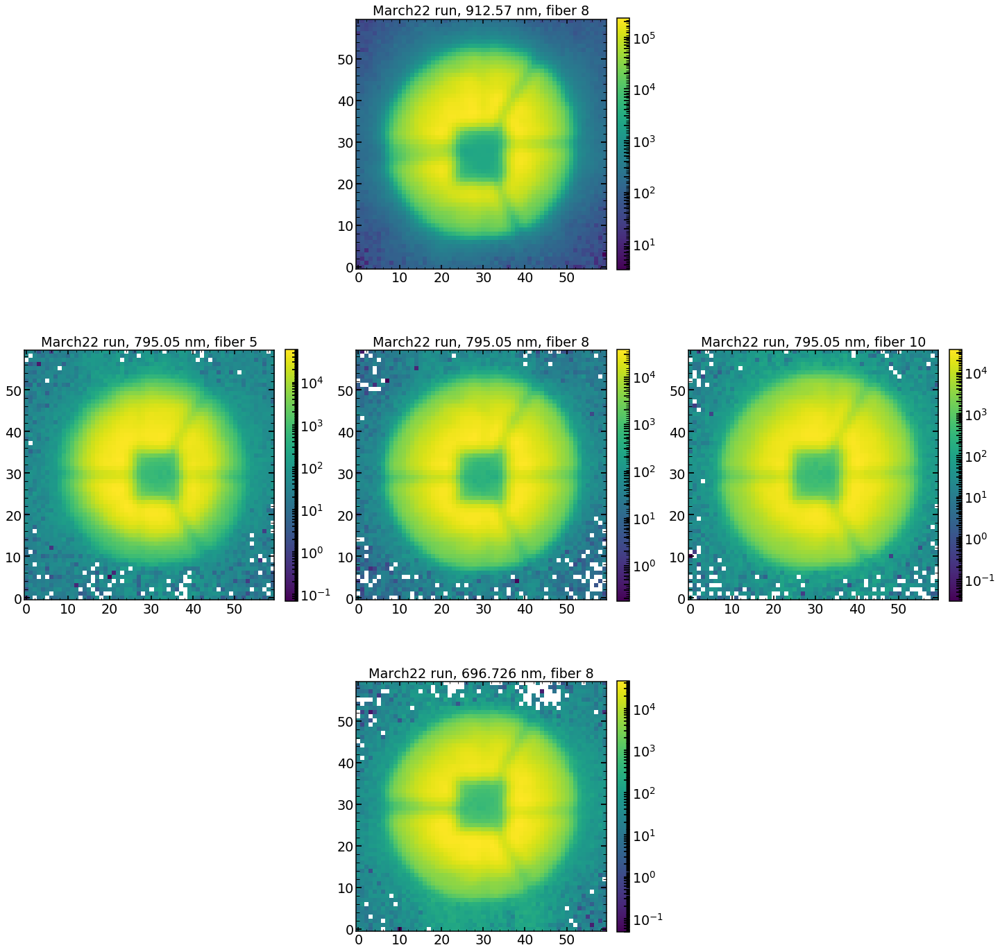

In [470]:
matplotlib.rcParams.update({'font.size':16})
plt.figure(figsize=(20,20))
#plt.suptitle('Residuals - Dec52 run, direct fit to defocused data, scale=5% of max value in the data')

plt.subplot(332)
plt.imshow(sci_image_top,origin='lower',vmax=np.max(np.abs(sci_image_top))/1,norm=LogNorm())
plt.title(date+' run, 912.57 nm, fiber 8')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(338)
plt.title(date+' run, 696.726 nm, fiber 8')
plt.imshow(sci_image_bottom,origin='lower',vmax=np.max(np.abs(sci_image_bottom))/1,norm=LogNorm())
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(334)
plt.title(date+' run, 795.05 nm, fiber 5')
plt.imshow(sci_image_left,origin='lower',vmax=np.max(np.abs(sci_image_left))/1,norm=LogNorm())
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(336)
plt.title(date+' run, 795.05 nm, fiber 10')
plt.imshow(sci_image_right,origin='lower',vmax=np.max(np.abs(sci_image_right))/1,norm=LogNorm())
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(335)
plt.title(date+' run, 795.05 nm, fiber 8')
plt.imshow(sci_image_center,origin='lower',vmax=np.max(np.abs(sci_image_center))/1,norm=LogNorm())
plt.colorbar(fraction=0.046, pad=0.04)

#plt.subplots_adjust(top=0.1)
plt.tight_layout(pad=0.4 ,w_pad=0.5, h_pad=0.4)

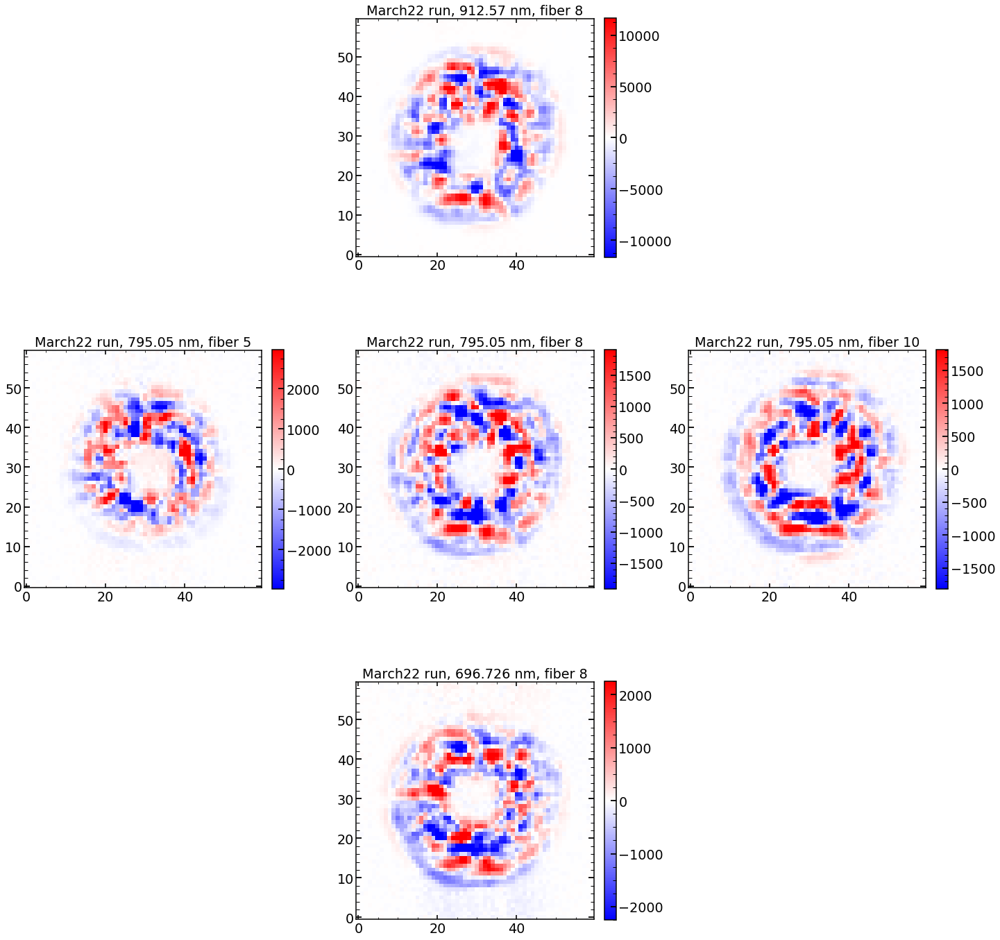

In [471]:
matplotlib.rcParams.update({'font.size':16})
plt.figure(figsize=(20,20))
#plt.suptitle('Residuals - Dec52 run, direct fit to defocused data, scale=5% of max value in the data')

plt.subplot(332)
plt.imshow(test_image_top-sci_image_top,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_top))/20,vmax=np.max(np.abs(sci_image_top))/20)
plt.title(date+' run, 912.57 nm, fiber 8')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(338)
plt.title(date+' run, 696.726 nm, fiber 8')
plt.imshow(test_image_bottom-sci_image_bottom,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_bottom))/20,vmax=np.max(np.abs(sci_image_bottom))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(334)
plt.title(date+' run, 795.05 nm, fiber 5')
plt.imshow(test_image_left-sci_image_left,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_left))/20,vmax=np.max(np.abs(sci_image_left))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(336)
plt.title(date+' run, 795.05 nm, fiber 10')
plt.imshow(test_image_right-sci_image_right,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_right))/20,vmax=np.max(np.abs(sci_image_right))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(335)
plt.title(date+' run, 795.05 nm, fiber 8')
plt.imshow(test_image_center-sci_image_center,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_center))/20,vmax=np.max(np.abs(sci_image_center))/20)
plt.colorbar(fraction=0.046, pad=0.04)

#plt.subplots_adjust(top=0.1)
plt.tight_layout(pad=0.4 ,w_pad=0.5, h_pad=0.4)

In [472]:
single_number=66
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
#allparameters_proposal_left_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31+11]
allparameters_proposal_left_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31]
model = LN_PFS_single(sci_image_left,var_image_left,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_left_int)
test_image_left_Dec23_int=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_left=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
print(np.mean((test_image_left_Dec23_int-sci_image_left)**2/var_image_left))

single_number=105
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
#allparameters_proposal_top_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31+11]
allparameters_proposal_top_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31]
model = LN_PFS_single(sci_image_top,var_image_top,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_top_int)
test_image_top_Dec23_int=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_top=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
print(np.mean((test_image_top_Dec23_int-sci_image_top)**2/var_image_top))

single_number=102
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
#allparameters_proposal_center_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31+11]
allparameters_proposal_center_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31]
model = LN_PFS_single(sci_image_center,var_image_center,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_center_int)
test_image_center_Dec23_int=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_center=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
print(np.mean((test_image_center_Dec23_int-sci_image_center)**2/var_image_center))

single_number=97
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
#allparameters_proposal_bottom_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31+11]
allparameters_proposal_bottom_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31]
model = LN_PFS_single(sci_image_bottom,var_image_bottom,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_bottom_int)
test_image_bottom_Dec23_int=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_bottom=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
print(np.mean((test_image_bottom_Dec23_int-sci_image_bottom)**2/var_image_bottom))


single_number=126
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
#allparameters_proposal_right_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31+11]
allparameters_proposal_right_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31]
model = LN_PFS_single(sci_image_right,var_image_right,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_right_int)
test_image_right_Dec23_int=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_right=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
print(np.mean((test_image_right_Dec23_int-sci_image_right)**2/var_image_right))







(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 47088.05050437304
minimal chi2 reduced is: 26.15480578639778
None
zmax: 11
48.15057621411764
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 297286.19639647106
minimal chi2 reduced is: 165.15340744303555
None
zmax: 11
438.92192680820955
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 56243.51540607001
minimal chi2 reduced is: 31.241247475393063
None
zmax: 11
43.04072924509572
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 58669.65709291429
minimal chi2 reduced is: 32.589067014348586
None
zmax: 11
45.18401165018765
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 56352.222591059544
minimal chi2 reduced is: 31.30165920339211
None
zmax: 11
67.49063419858767


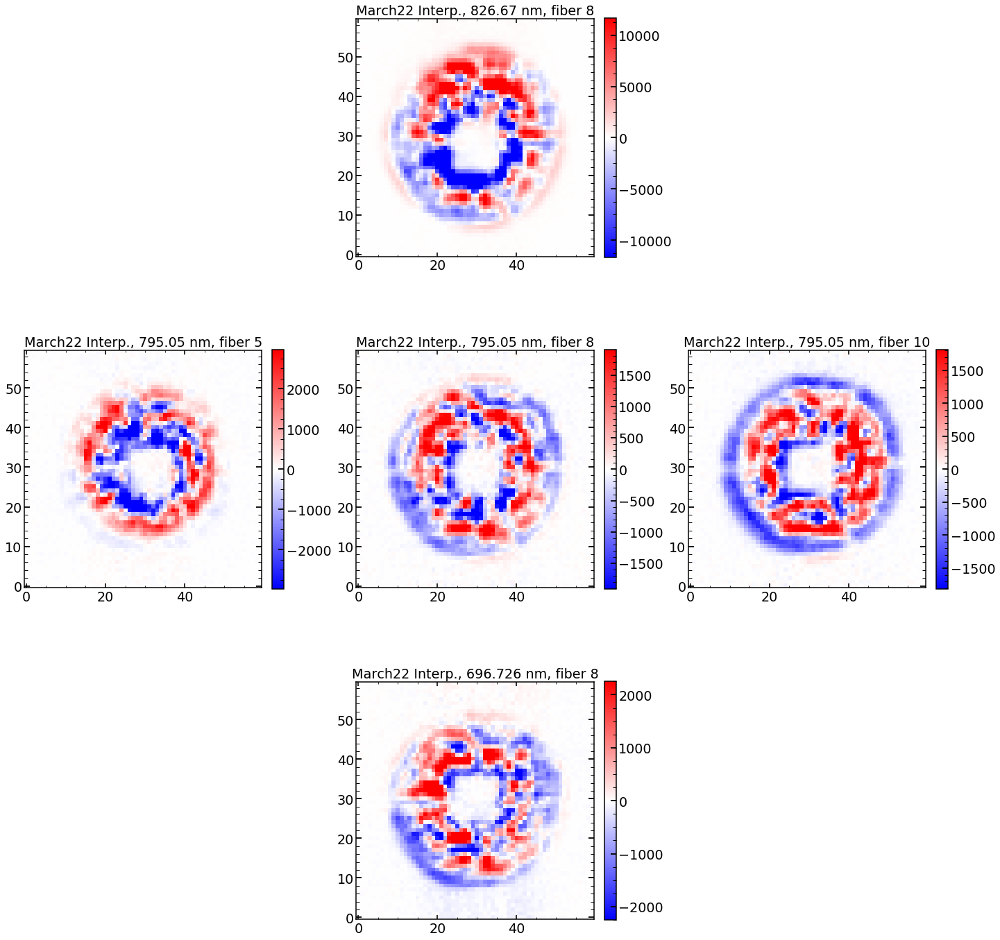

In [473]:
matplotlib.rcParams.update({'font.size':16})
plt.figure(figsize=(20,20))

plt.subplot(332)
plt.imshow(test_image_top_Dec23_int-sci_image_top,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_top))/20,vmax=np.max(np.abs(sci_image_top))/20)
plt.title(date+' Interp., 826.67 nm, fiber 8')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(338)
plt.title(date+' Interp., 696.726 nm, fiber 8')
plt.imshow(test_image_bottom_Dec23_int-sci_image_bottom,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_bottom))/20,vmax=np.max(np.abs(sci_image_bottom))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(334)
plt.title(date+' Interp., 795.05 nm, fiber 5')
plt.imshow(test_image_left_Dec23_int-sci_image_left,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_left))/20,vmax=np.max(np.abs(sci_image_left))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(336)
plt.title(date+' Interp., 795.05 nm, fiber 10')
plt.imshow(test_image_right_Dec23_int-sci_image_right,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_right))/20,vmax=np.max(np.abs(sci_image_right))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(335)
plt.title(date+' Interp., 795.05 nm, fiber 8')
plt.imshow(test_image_center_Dec23_int-sci_image_center,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_center))/20,vmax=np.max(np.abs(sci_image_center))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.tight_layout(pad=0.4 ,w_pad=0.5, h_pad=0.4)

### verification - individual images - Ne

In [474]:
print(results_of_fit_many_Ne['m35'].loc[78][0])
print(results_of_fit_many_Ne['m35'].loc[77][0])
print(results_of_fit_many_Ne['m35'].loc[74][0])
print(results_of_fit_many_Ne['m35'].loc[68][0])
print(results_of_fit_many_Ne['m35'].loc[86][0])

25.55725162122784
25.514411723035888
26.280346104892892
25.997046590568896
25.793044595001042


In [475]:
list_of_single_number_Ne=[68,74,77,78,86]

In [476]:
print([finalNe_Feb2019.loc[68]['xc'],finalNe_Feb2019.loc[68]['yc']])
print([finalNe_Feb2019.loc[78]['xc'],finalNe_Feb2019.loc[78]['yc']])
print([finalNe_Feb2019.loc[77]['xc'],finalNe_Feb2019.loc[77]['yc']])
print([finalNe_Feb2019.loc[74]['xc'],finalNe_Feb2019.loc[74]['yc']])
print([finalNe_Feb2019.loc[86]['xc'],finalNe_Feb2019.loc[86]['yc']])

[1994, 798]
[2122, 1076]
[2122, 797]
[2123, 420]
[2239, 797]


In [477]:
date='March22'

arc='Ne'
obs=12397
single_number=86
sci_image_right =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
var_image_right =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
single_number=68
sci_image_left =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
var_image_left =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
single_number=74
sci_image_bottom =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
var_image_bottom =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
single_number=78
sci_image_top =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
var_image_top =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
single_number=77
sci_image_center =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
var_image_center =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')

In [478]:
single_number=68
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
allparameters_proposal_left=minchain
model = LN_PFS_single(sci_image_left,var_image_left,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_left)
test_image_left=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_left=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')

single_number=78
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
allparameters_proposal_top=minchain
model = LN_PFS_single(sci_image_top,var_image_top,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_top)
test_image_top=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_top=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')

single_number=77
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
allparameters_proposal_center=minchain
model = LN_PFS_single(sci_image_center,var_image_center,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_center)
test_image_center=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_center=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')

single_number=74
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
allparameters_proposal_bottom=minchain
model = LN_PFS_single(sci_image_bottom,var_image_bottom,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_bottom)
test_image_bottom=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_bottom=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')

single_number=86
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
allparameters_proposal_right=minchain
model = LN_PFS_single(sci_image_right,var_image_right,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_right)
test_image_right=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_right=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')

(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 354728.8700465946
minimal chi2 reduced is: 283.7749517716578
None
zmax: 11
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 44384.71402158236
minimal chi2 reduced is: 35.50034158120084
None
zmax: 11
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 240521.05403780245
minimal chi2 reduced is: 192.4087882426754
None
zmax: 11
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 190253.51632222775
minimal chi2 reduced is: 152.1949647442613
None
zmax: 11
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 309014.0126191337
minimal chi2 reduced is: 247.20310624652137
None
zmax: 11


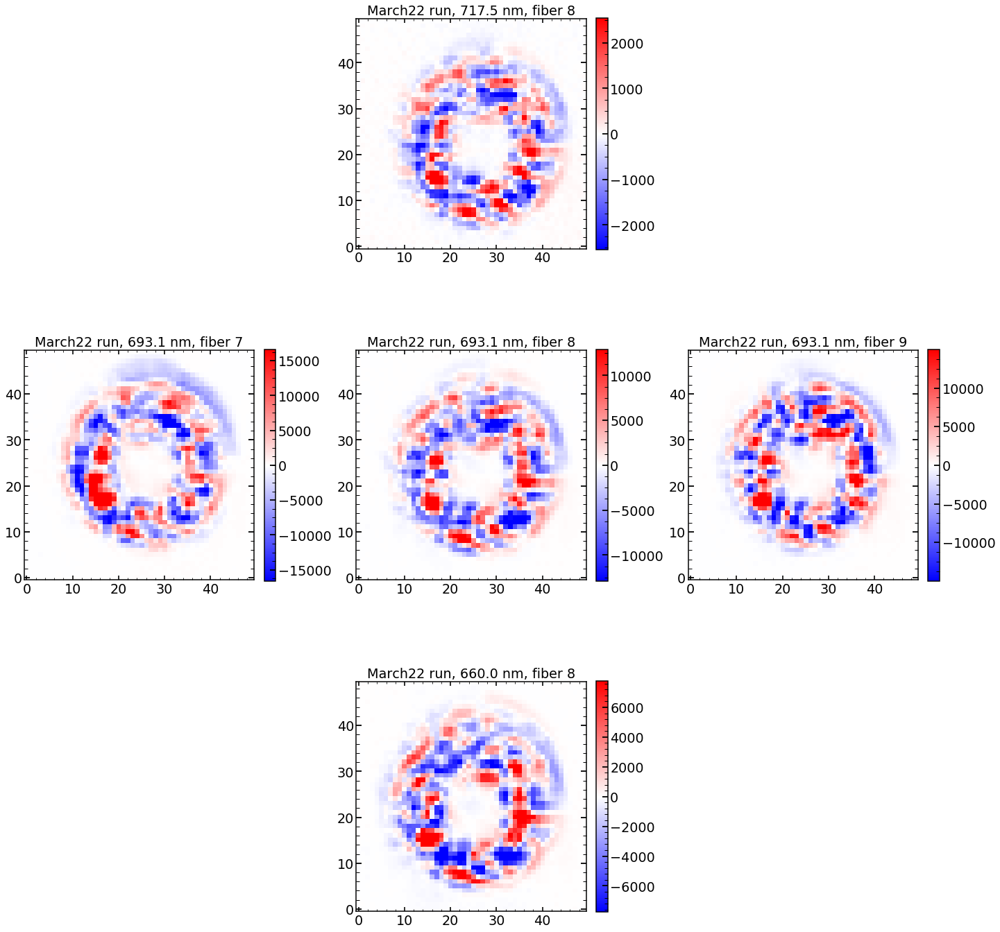

In [479]:
# change titles

matplotlib.rcParams.update({'font.size':16})
plt.figure(figsize=(20,20))
#plt.suptitle('Residuals - Dec52 run, direct fit to defocused data, scale=5% of max value in the data')

plt.subplot(332)
plt.imshow(test_image_top-sci_image_top,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_top))/20,vmax=np.max(np.abs(sci_image_top))/20)
plt.title(date+' run, '+finalNe_Feb2019.loc[list_of_single_number_Ne[3]]['wavelength'][:5]+' nm, fiber '+finalNe_Feb2019.loc[list_of_single_number_Ne[1]]['fiber'])
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(338)
plt.title(date+' run, '+finalNe_Feb2019.loc[list_of_single_number_Ne[1]]['wavelength'][:5]+' nm, fiber '+finalNe_Feb2019.loc[list_of_single_number_Ne[3]]['fiber'])
plt.imshow(test_image_bottom-sci_image_bottom,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_bottom))/20,vmax=np.max(np.abs(sci_image_bottom))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(334)
plt.title(date+' run, '+finalNe_Feb2019.loc[list_of_single_number_Ne[0]]['wavelength'][:5]+' nm, fiber '+finalNe_Feb2019.loc[list_of_single_number_Ne[0]]['fiber'])
plt.imshow(test_image_left-sci_image_left,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_left))/20,vmax=np.max(np.abs(sci_image_left))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(336)
plt.title(date+' run, '+finalNe_Feb2019.loc[list_of_single_number_Ne[4]]['wavelength'][:5]+' nm, fiber '+finalNe_Feb2019.loc[list_of_single_number_Ne[4]]['fiber'])
plt.imshow(test_image_right-sci_image_right,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_right))/20,vmax=np.max(np.abs(sci_image_right))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(335)
plt.title(date+' run, '+finalNe_Feb2019.loc[list_of_single_number_Ne[2]]['wavelength'][:5]+' nm, fiber '+finalNe_Feb2019.loc[list_of_single_number_Ne[2]]['fiber'])
plt.imshow(test_image_center-sci_image_center,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_center))/20,vmax=np.max(np.abs(sci_image_center))/20)
plt.colorbar(fraction=0.046, pad=0.04)

#plt.subplots_adjust(top=0.1)
plt.tight_layout(pad=0.4 ,w_pad=0.5, h_pad=0.4)

#### interpolation

In [480]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Mar220119/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Mar22.pkl', 'rb') as f:
    results_of_fit_many_HgAr=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Mar22.pkl', 'rb') as f:
    results_of_fit_many_Ne=pickle.load(f)

In [481]:
single_number=list_of_single_number_Ne[4]
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
#allparameters_proposal_right_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31+11]
allparameters_proposal_right_int=results_of_fit_many_interpolation_Ne['m35'].loc[single_number][:31]
model = LN_PFS_single(sci_image_right,var_image_right,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_right_int)
test_image_right_Dec23_int=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_right=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
print(np.mean((test_image_right_Dec23_int-sci_image_right)**2/var_image_right))


single_number=list_of_single_number_Ne[0]
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
#allparameters_proposal_left_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31+11]
allparameters_proposal_left_int=results_of_fit_many_interpolation_Ne['m35'].loc[single_number][:31]
model = LN_PFS_single(sci_image_left,var_image_left,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_left_int)
test_image_left_Dec23_int=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_left=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
print(np.mean((test_image_left_Dec23_int-sci_image_left)**2/var_image_left))

single_number=list_of_single_number_Ne[3]
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
#allparameters_proposal_bottom_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31+11]
allparameters_proposal_bottom_int=results_of_fit_many_interpolation_Ne['m35'].loc[single_number][:31]
model = LN_PFS_single(sci_image_bottom,var_image_bottom,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_bottom_int)
test_image_bottom_Dec23_int=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_bottom=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
print(np.mean((test_image_bottom_Dec23_int-sci_image_bottom)**2/var_image_bottom))

single_number=list_of_single_number_Ne[3]
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
#allparameters_proposal_top_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31+11]
allparameters_proposal_top_int=results_of_fit_many_interpolation_Ne['m35'].loc[single_number][:31]
model = LN_PFS_single(sci_image_top,var_image_top,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_top_int)
test_image_top_Dec23_int=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_top=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
print(np.mean((test_image_top_Dec23_int-sci_image_top)**2/var_image_top))

single_number=list_of_single_number_Ne[1]
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()
minchain,like_min=single_analysis.create_likelihood()
#allparameters_proposal_center_int=results_of_fit_many_interpolation_HgAr['p35'].loc[single_number][:31+11]
allparameters_proposal_center_int=results_of_fit_many_interpolation_Ne['m35'].loc[single_number][:31]
model = LN_PFS_single(sci_image_center,var_image_center,dithering=1,save=1,zmax=11)   
res=model(allparameters_proposal_center_int)
test_image_center_Dec23_int=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
pupililluminated_center=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
print(np.mean((test_image_center_Dec23_int-sci_image_center)**2/var_image_center))

(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 309014.0126191337
minimal chi2 reduced is: 247.20310624652137
None
zmax: 11
482.1425345598816
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 354728.8700465946
minimal chi2 reduced is: 283.7749517716578
None
zmax: 11
430.1074584219421
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 44384.71402158236
minimal chi2 reduced is: 35.50034158120084
None
zmax: 11
1152.7327655121373
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 44384.71402158236
minimal chi2 reduced is: 35.50034158120084
None
zmax: 11
56.479583824152904
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 190253.51632222775
minimal chi2 reduced is: 152.1949647442613
None
zmax: 11
646.8578042692726


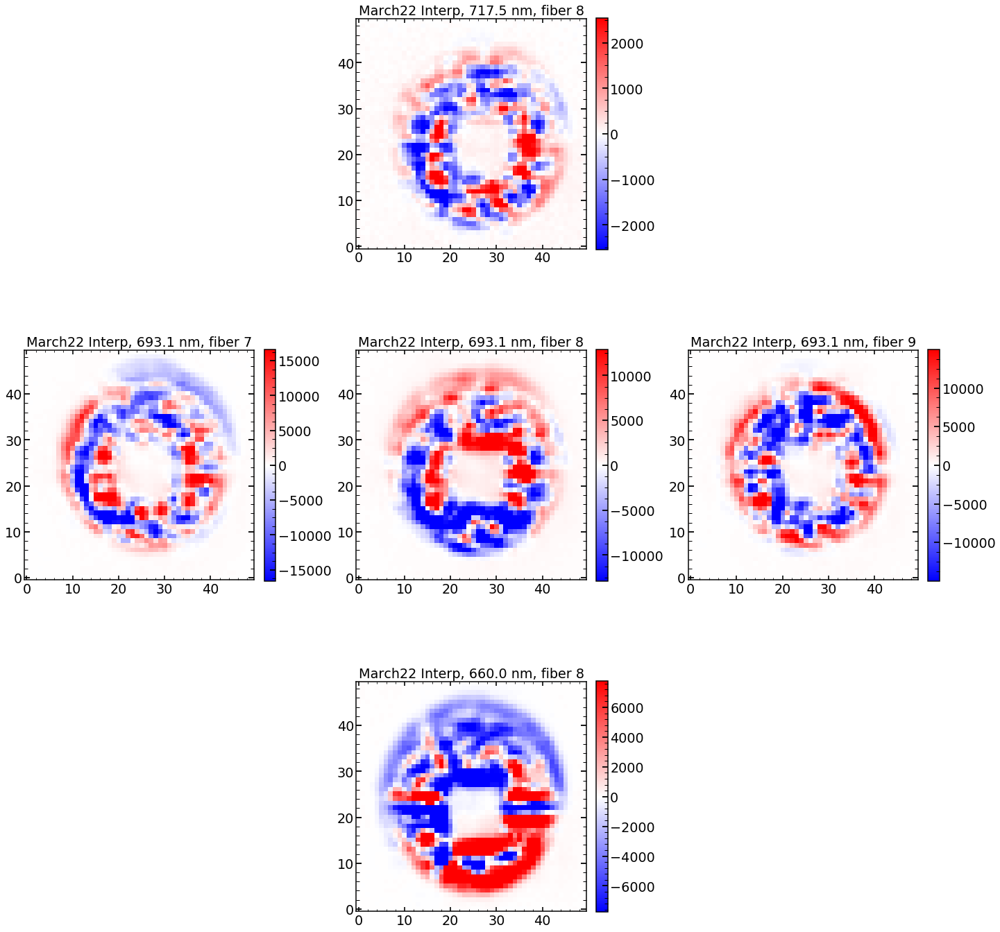

In [482]:
matplotlib.rcParams.update({'font.size':16})
plt.figure(figsize=(20,20))

plt.subplot(332)
plt.imshow(test_image_top_Dec23_int-sci_image_top,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_top))/20,vmax=np.max(np.abs(sci_image_top))/20)
plt.title(date+' Interp, '+finalNe_Feb2019.loc[list_of_single_number_Ne[3]]['wavelength'][:5]+' nm, fiber '+finalNe_Feb2019.loc[list_of_single_number_Ne[1]]['fiber'])
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(338)
plt.title(date+' Interp, '+finalNe_Feb2019.loc[list_of_single_number_Ne[1]]['wavelength'][:5]+' nm, fiber '+finalNe_Feb2019.loc[list_of_single_number_Ne[3]]['fiber'])
plt.imshow(test_image_bottom_Dec23_int-sci_image_bottom,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_bottom))/20,vmax=np.max(np.abs(sci_image_bottom))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(334)
plt.title(date+' Interp, '+finalNe_Feb2019.loc[list_of_single_number_Ne[0]]['wavelength'][:5]+' nm, fiber '+finalNe_Feb2019.loc[list_of_single_number_Ne[0]]['fiber'])
plt.imshow(test_image_left_Dec23_int-sci_image_left,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_left))/20,vmax=np.max(np.abs(sci_image_left))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(336)
plt.title(date+' Interp, '+finalNe_Feb2019.loc[list_of_single_number_Ne[4]]['wavelength'][:5]+' nm, fiber '+finalNe_Feb2019.loc[list_of_single_number_Ne[4]]['fiber'])
plt.imshow(test_image_right_Dec23_int-sci_image_right,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_right))/20,vmax=np.max(np.abs(sci_image_right))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(335)
plt.title(date+' Interp, '+finalNe_Feb2019.loc[list_of_single_number_Ne[2]]['wavelength'][:5]+' nm, fiber '+finalNe_Feb2019.loc[list_of_single_number_Ne[2]]['fiber'])
plt.imshow(test_image_center_Dec23_int-sci_image_center,origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image_center))/20,vmax=np.max(np.abs(sci_image_center))/20)
plt.colorbar(fraction=0.046, pad=0.04)

plt.tight_layout(pad=0.4 ,w_pad=0.5, h_pad=0.4)

# Focus (Mar26)

## Scripts

In [986]:
# select all and then remove the fibers 2 and 3

list_of_HgAr_to_analyze_all=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=15)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=0)
                                        &(finalHgAr_Feb2019['close'].values.astype(int)==1)&(finalHgAr_Feb2019['wavelength'].values.astype(float)<1000)&(finalHgAr_Feb2019['wavelength'].values.astype(float)>600)]
print(len(list_of_HgAr_to_analyze_all))

list_of_HgAr_to_not_analyze_2_3=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['fiber'].values.astype(int)<=3)&(finalHgAr_Feb2019['fiber'].values.astype(int)>=2)
                                        &(finalHgAr_Feb2019['close'].values.astype(int)==1)&(finalHgAr_Feb2019['wavelength'].values.astype(float)<1000)&(finalHgAr_Feb2019['wavelength'].values.astype(float)>600)]


list_of_HgAr_to_not_analyze_727=finalHgAr_Feb2019.index[(finalHgAr_Feb2019['wavelength']=='727.47876')]

# remove the spots from fibers 2 and 3 as they are too close together
list_of_HgAr_to_analyze=np.setdiff1d(list_of_HgAr_to_analyze_all,list_of_HgAr_to_not_analyze_2_3)

# remove the line at 727 nm which I did not clean very well
list_of_HgAr_to_analyze=np.setdiff1d(list_of_HgAr_to_analyze,list_of_HgAr_to_not_analyze_727)

print(len(list_of_HgAr_to_analyze))
list_of_HgAr_to_analyze_10=np.array_split(list_of_HgAr_to_analyze,8)

print(len(list_of_HgAr_to_analyze_10))
print(list_of_HgAr_to_analyze_10)

80
56
8
[array([ 1,  6,  9, 11, 13, 18, 21]), array([23, 49, 54, 57, 59, 61, 66]), array([69, 71, 73, 78, 81, 83, 85]), array([ 90,  93,  95,  97, 102, 105, 107]), array([109, 114, 117, 119, 121, 126, 129]), array([131, 133, 138, 141, 143, 145, 150]), array([153, 155, 157, 162, 165, 167, 169]), array([174, 177, 179, 181, 186, 189, 191])]


In [987]:
list_of_Ne_to_analyze_all=finalNe_Feb2019.index[(finalNe_Feb2019['fiber'].values.astype(int)<=16)&(finalNe_Feb2019['fiber'].values.astype(int)>=0)
                                        &(finalNe_Feb2019['close'].values.astype(int)==1)]


list_of_Ne_to_not_analyze_2_3=finalNe_Feb2019.index[(finalNe_Feb2019['fiber'].values.astype(int)<=3)&(finalNe_Feb2019['fiber'].values.astype(int)>=2)
                                        &(finalNe_Feb2019['close'].values.astype(int)==1)]

# remove the spots from fibers 2 and 3 as they are too close together
list_of_Ne_to_analyze=np.setdiff1d(list_of_Ne_to_analyze_all,list_of_Ne_to_not_analyze_2_3)

print(len(list_of_Ne_to_analyze))

list_of_Ne_to_analyze_10=np.array_split(list_of_Ne_to_analyze,8)

print(list_of_Ne_to_analyze_10)
print(len(list_of_Ne_to_analyze_10))

56
[array([ 2,  5,  6,  7, 11, 14, 15]), array([16, 38, 41, 42, 43, 47, 50]), array([51, 52, 56, 59, 60, 61, 65]), array([68, 69, 70, 74, 77, 78, 79]), array([83, 86, 87, 88, 92, 95, 96]), array([ 97, 101, 104, 105, 106, 110, 113]), array([114, 115, 119, 122, 123, 124, 128]), array([131, 132, 133, 137, 140, 141, 142])]
8


In [988]:
list_of_HgAr_to_analyze_10[0]

array([ 1,  6,  9, 11, 13, 18, 21])

In [989]:
#MPI
for i in range(len(list_of_HgAr_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T01'+str(i)+'Mar_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_HgAr_to_analyze_10[i]:
        for obs in [11748]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI03_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/FebScriptToSubmitScriptsTiger01_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_HgAr_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T01'+str(i)+'Mar_focus.sh \n')

file.close()

In [990]:
#MPI
for i in range(len(list_of_Ne_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T02'+str(i)+'Mar_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_Ne_to_analyze_10[i]:
        for obs in [12355]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI03_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/FebScriptToSubmitScriptsTiger02_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_Ne_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T02'+str(i)+'Mar_focus.sh \n')

file.close()

## Looking at the single image

In [149]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)

with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)    
    
    
date='Mar26'
obs=str(12355)
single_number='101'
image_index=int(single_number)
eps=5
arc='Ne'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=12355    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

0d


fiber                          11
xc                           2647
yc                            424
wavelength               660.0668
close                           1
lamp                           Ne
xc_effective                 2716
old_index_approx               56
superold_index_approx         nan
Name: 101, dtype: object

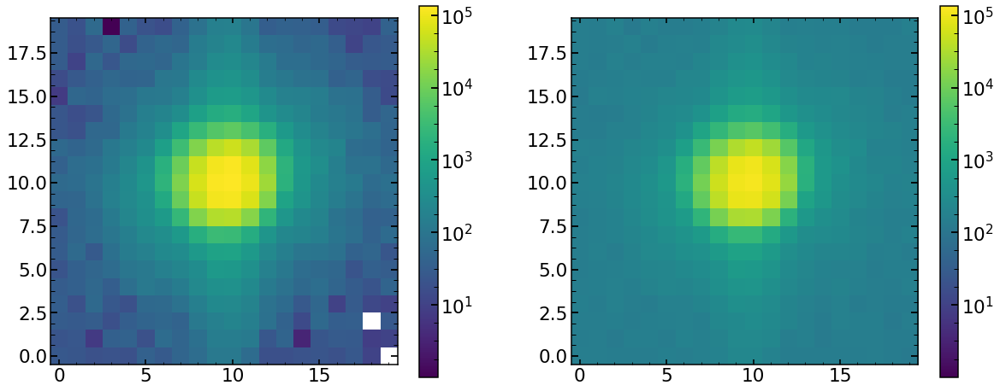

In [114]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [115]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 3648.573343445383
minimal chi2 reduced is: 18.20296588604555


In [116]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)

(31,)
         z4        z5        z6        z7        z8        z9       z10  \
0 -0.527609 -0.367184 -0.976615  0.650336 -0.208819  0.023606 -0.226814   

        z11  
0 -0.288676  
    hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.691139   0.087301  0.044102 -0.114397  0.062567     0.003539   

   radiometricEffect  radiometricExponent    x_ilum    y_ilum  
0           0.000019             0.000019  0.972314  0.948353  
    x_fiber   y_fiber  effective_radius_illumination  frd_sigma  \
0  0.001297 -0.056562                       0.797487   0.079484   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.999804  1.037163           -0.193366   46637.767245   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0           2.35828              0.002386      0.361164  1.814307  0.996472  


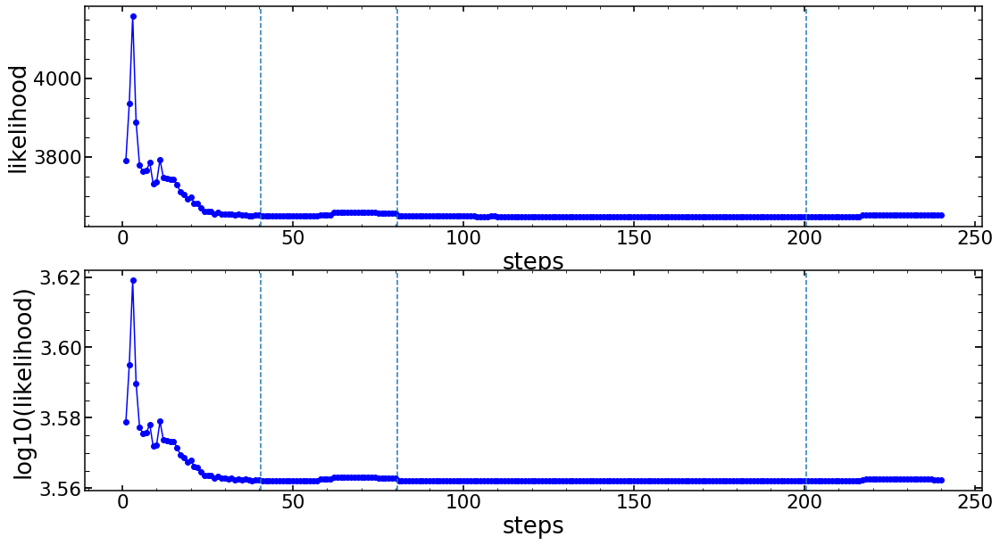

In [117]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [118]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   
       
model(minchain)

None
zmax: 11


-3648.573343452888

In [119]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

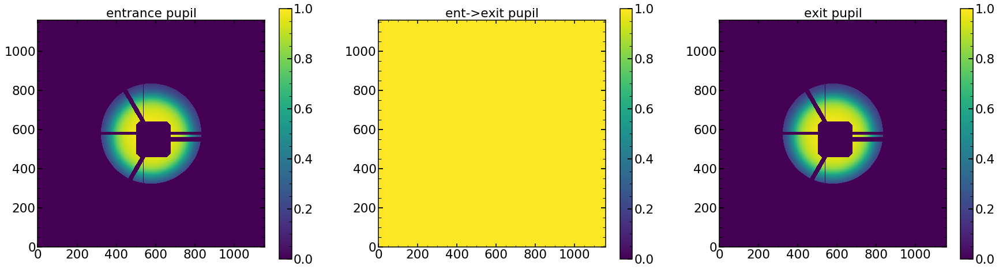

In [120]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

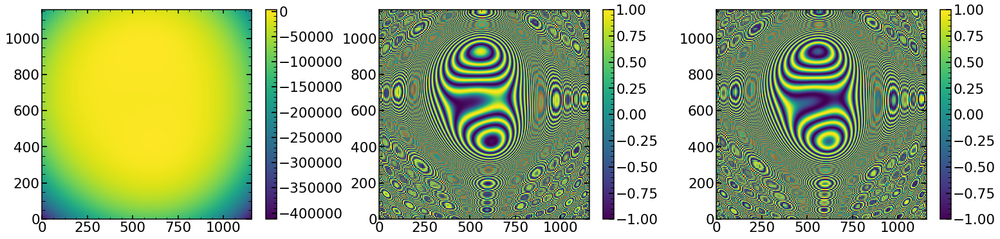

In [121]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

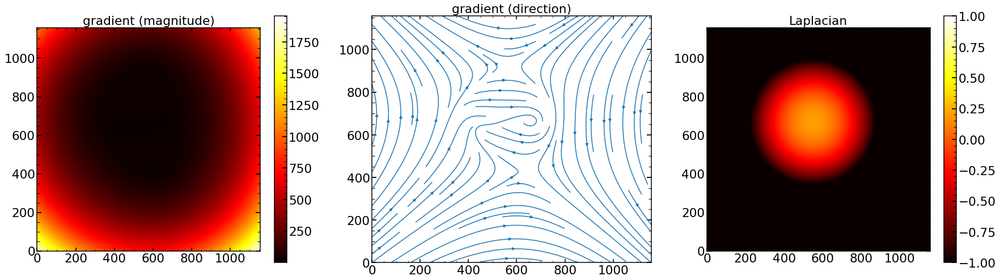

In [122]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

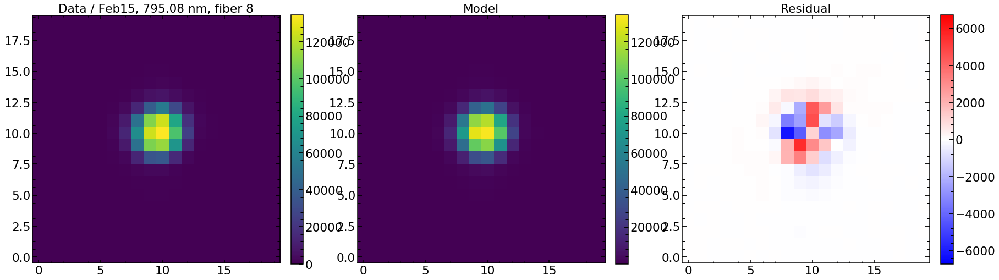

In [123]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / Feb15, 795.08 nm, fiber 8')
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.title('Residual')
plt.colorbar(fraction=0.046, pad=0.04)

chi**2 reduced is: 18.202965814783678
Abs of residual divided by total flux is: 0.04925785577693166
Abs of residual divided by largest value of a flux in the image is: 0.04635784840718337


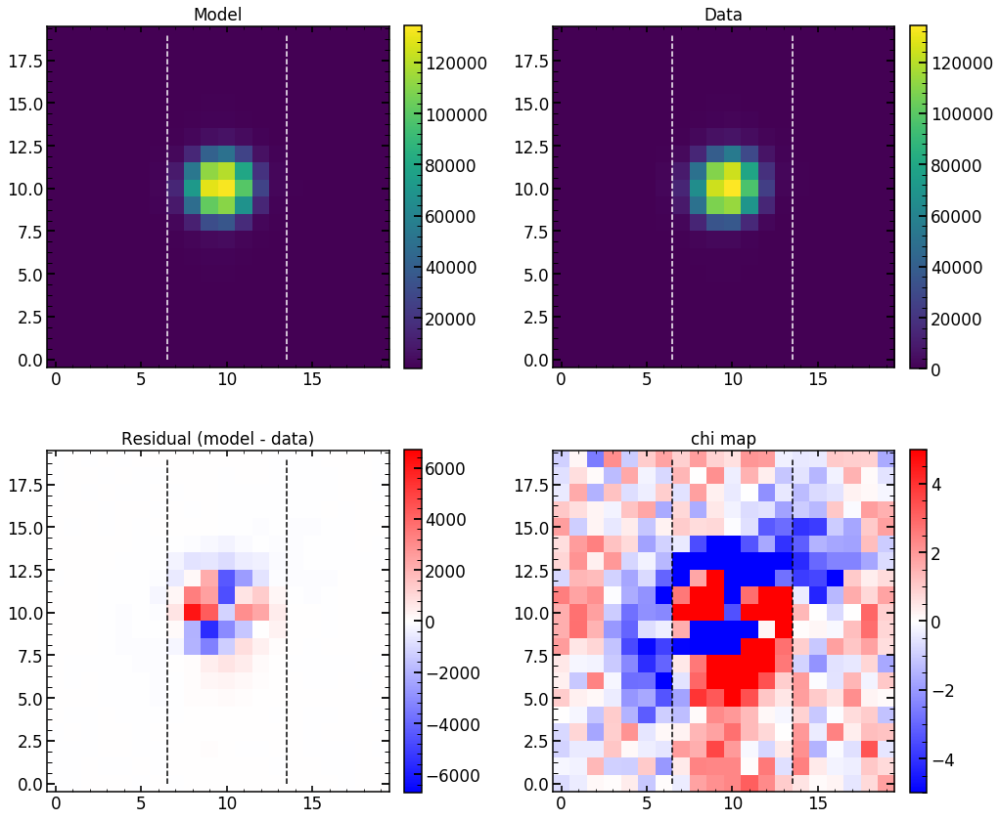

In [124]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

18.202965814783678
chi**2 reduced is: 18.202965814783678
Abs of residual divided by total flux is: 0.04925785577693166
Abs of residual divided by largest value of a flux in the image is: 0.04635784840718337


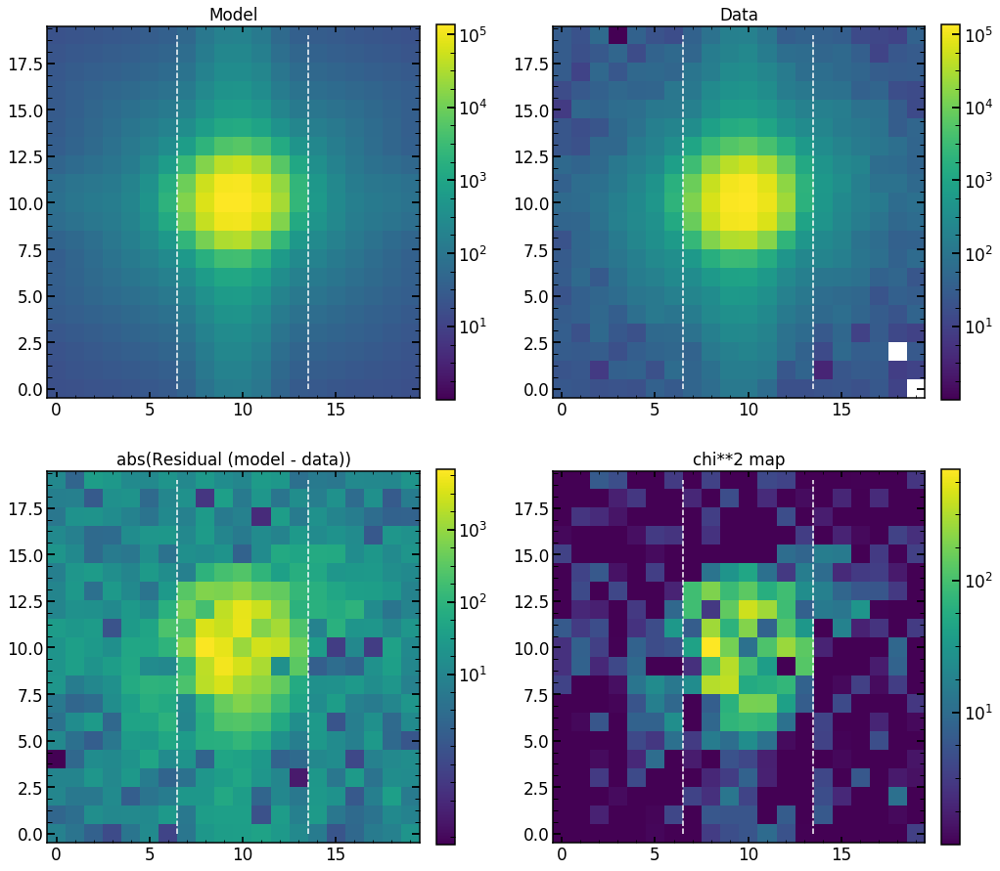

In [125]:
single_analysis.create_basic_comparison_plot_log()

18.202965814783678
chi**2 reduced is: 18.202965814783678
Abs of residual divided by total flux is: 0.04925785577693166
Abs of residual divided by largest value of a flux in the image is: 0.04635784840718337


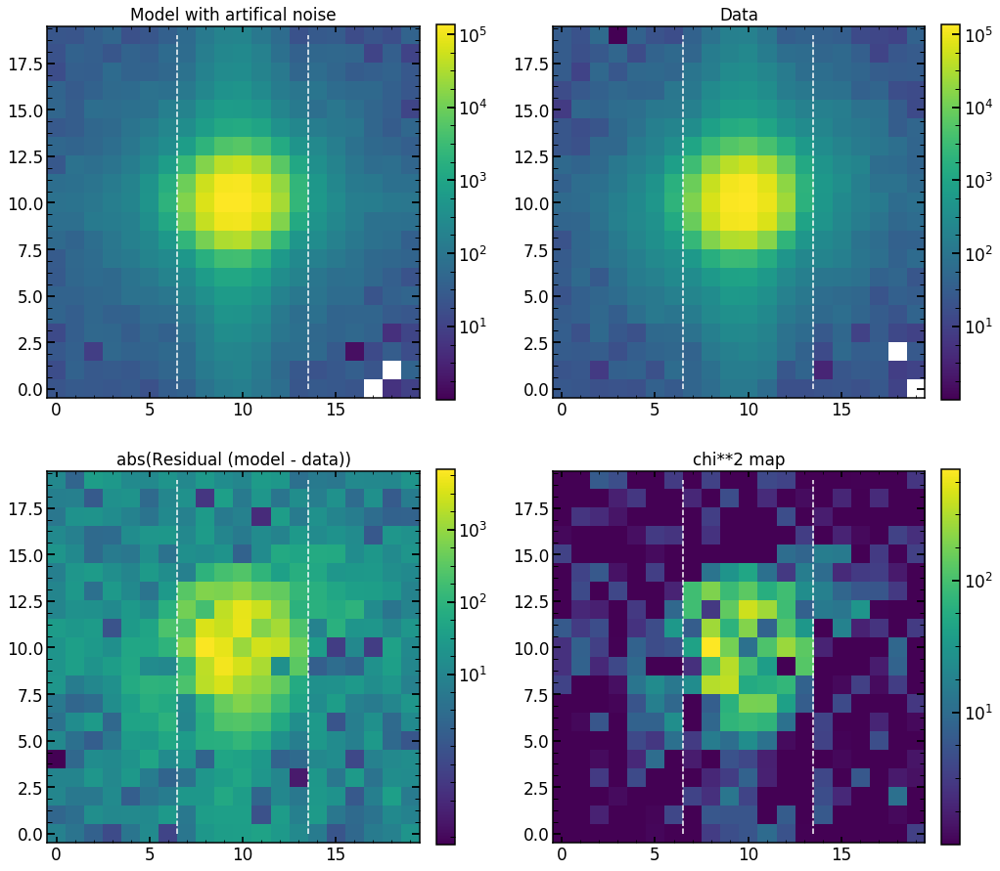

In [126]:
single_analysis.create_basic_comparison_plot_log_artifical()

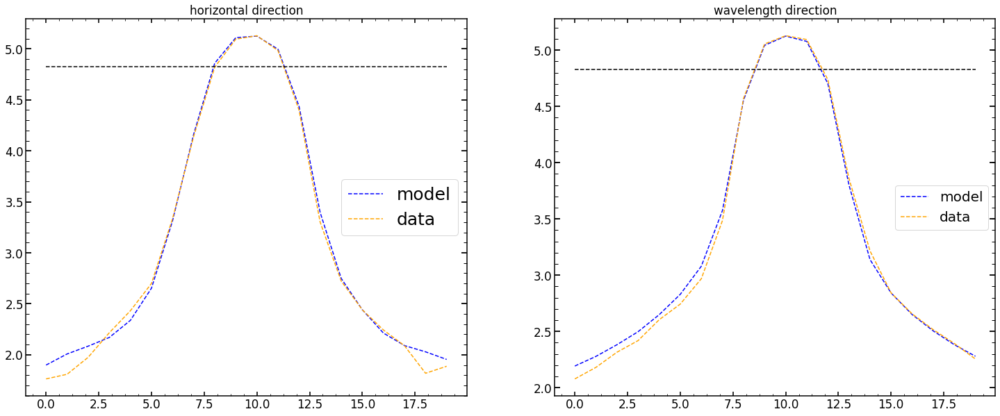

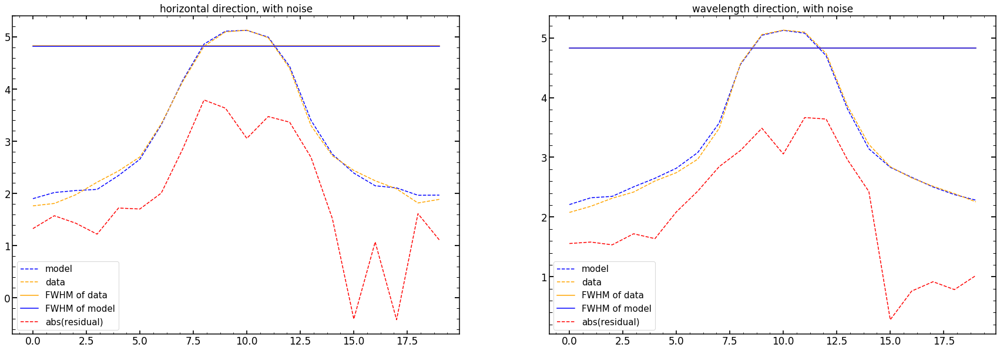

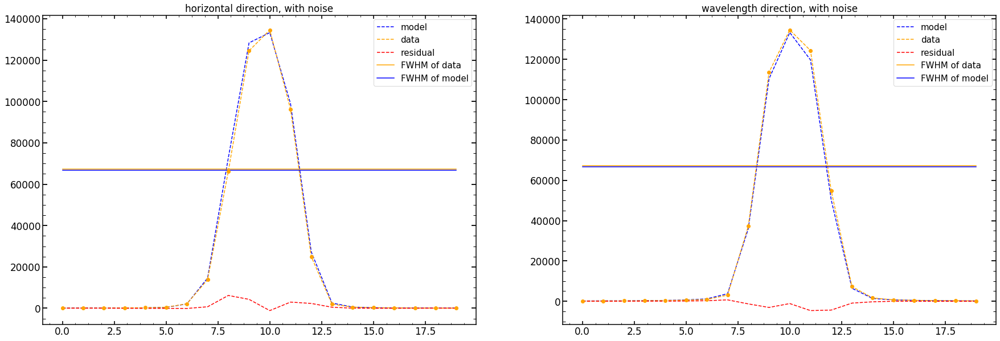

In [127]:
single_analysis.create_cut_plots()

## Creating  results everywhere

In [148]:
date

'Mar30'

In [150]:
assert date=='Mar26'

results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalHgAr_Feb2019.index,columns=columns11_analysis)
err_results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalHgAr_Feb2019.index,columns=columns11_analysis)

results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_focus_HgAr)
err_results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_focus_HgAr)


results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalNe_Feb2019.index,columns=columns11_analysis)
err_results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalNe_Feb2019.index,columns=columns11_analysis)

results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(results_of_fit_many_single_focus_Ne)
err_results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_focus_Ne)

In [151]:
columns_analysis=columns11_analysis

for single_number in range(len(finalHgAr_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus('Mar26',single_number,'HgAr',11)
    results_of_fit_many_single_focus_HgAr_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_HgAr_pd=results_of_fit_many_single_focus_HgAr_pd[np.abs(results_of_fit_many_single_focus_HgAr_pd['z4'])>0]


for single_number in range(len(finalNe_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus('Mar26',single_number,'Ne',11)
    results_of_fit_many_single_focus_Ne_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_Ne_pd=results_of_fit_many_single_focus_Ne_pd[np.abs(results_of_fit_many_single_focus_Ne_pd['z4'])>0]


11
0 11748 HgAr is NOT found or failed!
11
1 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z8: failed!
z10: failed!
z11: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z8: failed!
z10: failed!
z11: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
2 11748 HgAr is NOT found or failed!
11
3 11748 HgAr is NOT found or failed!
11
4 11748 HgAr is NOT found or failed!
11
5 11748 HgAr is NOT found or failed!
11
6 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
hscFrac: failed!
slitFra

slitHolder_frac_dx: failed!
11
55 11748 HgAr is NOT found or failed!
11
56 11748 HgAr is NOT found or failed!
11
57 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
58 11748 HgAr is NOT found or failed!
11
59 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z8: failed!
z9: failed!
z10: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: 

z6: failed!
z7: failed!
z8: failed!
z10: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
11
91 11748 HgAr is NOT found or failed!
11
92 11748 HgAr is NOT found or failed!
11
93 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z9: failed!
z11: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z9: failed!
z11: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11


radiometricExponent: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z6: failed!
z7: failed!
z9: failed!
dxFocal: failed!
radiometricExponent: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
11
132 11748 HgAr is NOT found or failed!
11
133 obs (Emcee3): 11748 is found!
z5: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
sl

166 11748 HgAr is NOT found or failed!
11
167 obs (Emcee3): 11748 is found!
z10: failed!
hscFrac: failed!
strutFrac: failed!
radiometricEffect: failed!
x_fiber: failed!
z10: failed!
hscFrac: failed!
strutFrac: failed!
radiometricEffect: failed!
x_fiber: failed!
11
168 11748 HgAr is NOT found or failed!
11
169 obs (Emcee3): 11748 is found!
z5: failed!
z7: failed!
z8: failed!
z10: failed!
strutFrac: failed!
dyFocal: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z7: failed!
z8: failed!
z10: failed!
strutFrac: failed!
dyFocal: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
170 11748 HgAr is NOT found or failed!
11
171 11748 HgAr is NOT found or failed!
11
172 11748 HgAr is NOT found or failed!
11
173 11

hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z8: failed!
z9: failed!
z10: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
12 12355 Ne is NOT found or failed!
11
13 12355 Ne is NOT found or failed!
11
14 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z10: failed!
z11: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricEffect: failed!
y_ilum: failed!
y_fiber: failed!
effec

effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
52 12355 Ne is NOT found or failed!
11
53 12355 Ne is NOT found or failed!
11
54 12355 Ne is NOT found or failed!
11
55 12355 Ne is NOT found or failed!
11
56 obs (Emcee3): 12355 is found!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: 

83 obs (Emcee3): 12355 is found!
z5: failed!
z7: failed!
z8: failed!
z9: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z7: failed!
z8: failed!
z9: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
84 12355 Ne is NOT found or failed!
11
85 12355 Ne is NOT found or failed!
11
86 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFra

11
113 12355 Ne is NOT found or failed!
11
114 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
strutFrac: failed!
slitFrac: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
strutFrac: failed!
slitFrac: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
115 12355 Ne is NOT found or failed!
11
116 12355 Ne is NOT found or failed!
11
117 12355 Ne is NOT found or failed!
11
118 12355 Ne is NOT found or failed!
11
119 obs (Emcee3): 12355 is found!
z5: failed!
z7: failed!
z8: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z7: failed!
z8: f

z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
11
142 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
slitHolder_frac_dx: failed!
11
143 12355 Ne is NOT found or failed!


In [152]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_HgAr_pd

,z4,z5,z6,z7,z8,z9,z10,z11,hscFrac,strutFrac,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,2.947106,0.310773,0.020996,0.495656,0.805756,-0.028231,-0.231274,-0.002617,0.702989,0.092245,...,1.001907,0.572610,38231.826562,2.233584,0.001220,0.397191,1.783332,0.995270,10.193227,1450.387695
6,2.569803,-0.200432,0.331113,0.153449,0.728270,-0.050772,-0.274653,-0.091119,0.699328,0.090393,...,0.990302,0.572574,45505.681806,2.015653,0.000713,0.410514,1.864065,0.998452,3.089631,1304.506836
9,2.554599,-0.954381,0.085034,-0.219276,0.661461,-0.127710,-0.321590,0.151150,0.699694,0.102154,...,1.026507,0.575702,29991.831893,2.356897,0.002071,0.350000,1.780076,0.995060,42.542234,7273.361328
11,2.609440,-1.358991,-0.265652,-0.377188,0.640020,-0.182248,-0.341337,0.396152,0.701704,0.112952,...,1.062441,0.578220,15717.888370,2.000820,0.001919,0.350000,1.780112,0.994326,3.598313,403.180481
13,2.450192,0.286138,-0.125125,0.529031,0.705838,-0.019390,-0.240061,-0.081183,0.699975,0.090157,...,1.009698,0.506430,46233.349927,2.084541,0.000864,0.387500,1.780100,0.994957,9.164370,1336.133789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,-2.281092,0.148560,-0.675064,-0.214589,-0.300765,-0.244239,-0.301732,0.353514,0.662989,0.091835,...,1.046728,-0.506695,21359.718822,1.500000,0.000268,0.800000,1.979984,0.987613,3.394220,262.233856
181,-2.426415,-0.811561,-0.364879,0.305512,-0.577701,-0.008589,-0.177896,-0.121479,0.692760,0.089080,...,0.978547,-0.568257,119999.993339,2.040072,0.001492,0.350000,1.821860,0.996259,4.064967,757.888306
186,-2.724276,-0.363770,-0.029646,0.077668,-0.503988,-0.064618,-0.221426,-0.156202,0.679047,0.081139,...,0.966489,-0.566055,119999.999909,2.370623,0.003054,0.392170,1.780561,0.994725,4.285274,612.405029
189,-3.020935,0.051000,-0.248757,-0.155913,-0.392971,-0.182618,-0.268302,0.152012,0.667042,0.085452,...,1.002161,-0.566327,119999.999780,2.585284,0.005751,0.542008,1.931738,0.984025,46.867147,2839.623047


In [153]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_Ne_pd

,z4,z5,z6,z7,z8,z9,z10,z11,hscFrac,strutFrac,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
2,3.304791,0.473948,-0.189176,0.623079,0.846514,-0.029856,-0.214015,0.098099,0.705373,0.095565,...,1.014399,0.578275,36777.982891,2.355446,0.002167,0.412498,1.780115,0.991434,52.368400,5756.716797
5,3.087417,0.322433,0.020080,0.500879,0.814834,-0.028812,-0.229609,0.008061,0.703331,0.092556,...,1.001978,0.577316,41803.751505,2.385685,0.001945,0.411244,1.780039,0.992452,75.944970,9594.016602
6,2.980162,0.204104,0.141230,0.413077,0.792846,-0.030686,-0.240830,-0.039892,0.702069,0.091072,...,0.995495,0.576677,32331.483364,2.114923,0.000862,0.406737,1.784539,0.993368,14.094168,1909.174683
11,2.798288,0.429516,-0.338944,0.654777,0.742860,-0.020286,-0.222969,0.017871,0.702534,0.093598,...,1.022426,0.511781,48084.006189,2.260183,0.001706,0.408086,1.780014,0.994073,32.792271,5175.567383
14,2.620565,0.296967,-0.127194,0.534490,0.714562,-0.019869,-0.238503,-0.071174,0.700308,0.090460,...,1.009853,0.511136,46359.134971,2.301183,0.001660,0.378585,1.780059,0.992545,68.946077,8799.631836
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133,-2.232441,-0.590574,-0.319843,0.288374,-0.502188,-0.013697,-0.205525,-0.223021,0.686891,0.084171,...,0.981479,-0.502692,119999.998339,2.128264,0.001195,0.350000,1.791111,0.996797,48.389703,14028.757812
137,-1.975175,-0.993286,-0.613352,0.401871,-0.596609,0.003296,-0.161850,-0.048339,0.698548,0.094483,...,0.993186,-0.564802,72228.802683,2.315843,0.002932,0.350000,1.857443,0.991243,30.579712,3200.388672
140,-2.278311,-0.821475,-0.391766,0.317704,-0.575937,-0.006845,-0.177407,-0.120471,0.693156,0.089408,...,0.980359,-0.563865,119999.986117,2.374329,0.003309,0.350000,1.805128,0.995896,23.578181,5066.739258
141,-2.415860,-0.701309,-0.261161,0.257689,-0.559456,-0.016996,-0.188634,-0.155341,0.689410,0.086393,...,0.973554,-0.563238,119999.998279,2.356164,0.003326,0.350000,1.784560,0.996987,4.604857,978.778259


In [154]:
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar26_Focus/' + 'results_of_fit_many_direct_HgAr_from_Mar26.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_HgAr_pd,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar26_Focus/' + 'results_of_fit_many_direct_Ne_from_Mar26.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_Ne_pd,f, protocol=pickle.HIGHEST_PROTOCOL)

##  verification

In [1003]:

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='March26'
zMax=11
descriptions=results_of_fit_many_HgAr[label[0]].columns


# i runs through all the parameters
for i in range(0,len(descriptions)):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr=np.array(results_of_fit_many_single_focus_HgAr_pd[descriptions[i]])

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_Ne=np.array(results_of_fit_many_single_focus_Ne_pd[descriptions[i]])

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+str(descriptions[i]))

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
    plt.clf()

<Figure size 864x720 with 0 Axes>

## Quality control

In [156]:
assert date=='Mar26'

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Mar26_Focus/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Mar26.pkl', 'rb') as f:
    results_of_fit_many_single_focus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Mar26.pkl', 'rb') as f:
    results_of_fit_many_single_focus_Ne_pd=pickle.load(f)

In [132]:
## just plotting

for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   

    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:31].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar26_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)
   

    plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='initial removal, fiber nr. 2')
    plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='#984ea3',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='initial removal, fiber nr. 2')
    plt.plot(np.zeros(20),'--')
    plt.ylim(-2500,2500)
    plt.ylabel('flux',size=25)
    plt.xlabel('pixel',size=25)
    plt.xticks(range(20))
    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/March26/1D/'+str(obs)+str(image_index)+str(arc))
    plt.clf()
    
    
for image_index in results_of_fit_many_single_focus_Ne_pd.index.values:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   

    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:31].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar26_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)
    
    plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='initial removal, fiber nr. 2')
    plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='#984ea3',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='initial removal, fiber nr. 2')
    plt.plot(np.zeros(20),'--')
    plt.ylim(-2500,2500)
    plt.ylabel('flux',size=25)
    plt.xlabel('pixel',size=25)
    plt.xticks(range(20))
    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/March26/1D/'+str(obs)+str(image_index)+str(arc))
    plt.clf()    

None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
z

<Figure size 864x720 with 0 Axes>

In [157]:
# creating arrays

res_HgAr=[]
res_HgAr_chi=[]

for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   

    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:31].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar26_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)   
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    
    res_HgAr.append(Q)
    res_HgAr_chi.append(chi_50000(sci_image_40000,var_image_40000,res_iapetus_40000))
  
res_Ne=[]
res_Ne_chi=[]
    
for image_index in results_of_fit_many_single_focus_Ne_pd.index.values:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   

    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:31].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
    
    
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar26_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)
    
    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    
    res_Ne.append(Q)
    res_Ne_chi.append(chi_50000(sci_image_40000,var_image_40000,res_iapetus_40000))

None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
z

## Q values global plot 

In [158]:

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='March26'
zMax=11
descriptions='Q'


# i runs through all the parameters
for i in range(0,1):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['yc'].values
    values_HgAr=res_HgAr

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['yc'].values
    values_Ne=res_Ne

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=1
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=1, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+'Q'+' value')

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'Q'+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'Q'+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+'Q'+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+'Q'+" "+str(descriptions[i]))
    plt.clf()

<Figure size 864x720 with 0 Axes>

In [159]:

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='March26'
zMax=11
descriptions=['chi']


# i runs through all the parameters
for i in range(0,1):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['yc'].values
    values_HgAr=res_HgAr_chi

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['yc'].values
    values_Ne=res_Ne_chi

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=1
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=1, vmax=20,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+'res_chi'+' value')

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'res_chi'+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'res_chi'+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+'chi'+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+'chi'+" "+str(descriptions[i]))
    plt.clf()

<Figure size 864x720 with 0 Axes>

In [160]:
res_Ne_chi_Mar26=res_Ne_chi
res_Ne_Mar26=res_Ne
res_HgAr_chi_Mar26=res_HgAr_chi
res_HgAr_Mar26=res_HgAr

Text(0,0.5,'Q')

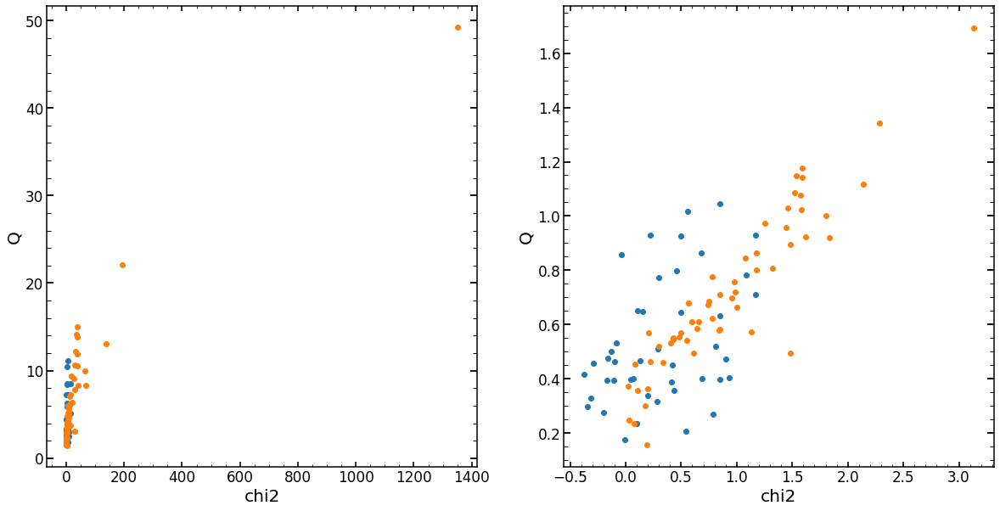

In [161]:
plt.figure(figsize=(20,10))
plt.subplot(121)
plt.scatter(res_Ne_chi,res_Ne)
plt.scatter(res_HgAr_chi,res_HgAr)
plt.xlabel('chi2')
plt.ylabel('Q')
plt.subplot(122)
plt.scatter(np.log10(res_Ne_chi),np.log10(res_Ne))
plt.scatter(np.log10(res_HgAr_chi),np.log10(res_HgAr))
plt.xlabel('chi2')
plt.ylabel('Q')

# Focus (Mar30) - spot each indiviually  - MPI04_focus

## Scripts

In [ ]:
# run 2.1. beforhand to generate list_of_HgAr_to_analyze_10 and list_of_Ne_to_analyze_10

In [991]:
#MPI
for i in range(len(list_of_HgAr_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T03'+str(i)+'Mar_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_HgAr_to_analyze_10[i]:
        for obs in [11748]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI04_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/FebScriptToSubmitScriptsTiger03_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_HgAr_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T03'+str(i)+'Mar_focus.sh \n')

file.close()

In [992]:
#MPI
for i in range(len(list_of_Ne_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T04'+str(i)+'Mar_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_Ne_to_analyze_10[i]:
        for obs in [12355]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Feb_MPI04_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/FebScriptToSubmitScriptsTiger04_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_Ne_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T04'+str(i)+'Mar_focus.sh \n')

file.close()

In [945]:
results_of_fit_many

array([   -0.83590648,    -0.2054081 ,    -0.42008644,     0.29583311,
          -0.0079353 ,     0.00265857,    -0.2645791 ,    -0.43595932,
           0.68081149,     0.07713529,     0.00830818,     0.01148621,
           0.06101173,     0.00871411,     0.00000017,     0.00000016,
           0.97281742,     0.94833808,    -0.0080463 ,    -0.06511615,
           0.82896283,     0.10363419,     0.87279571,     1.02065793,
          -0.04021679, 82615.33725161,     2.41431673,     0.00197545,
           0.35022209,     1.83833508,     0.99851325,     1.        ,
           1.        ])

In [1040]:
results_of_fit_many_interpolation_HgAr['0p']

,z4,z5,z6,z7,z8,z9,z10,z11,hscFrac,strutFrac,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
0,2.447895,0.337822,-0.010776,0.516510,0.811299,-0.028086,-0.228575,0.010853,0.703323,0.092680,...,1.003704,0.572927,100000.000000,2.384728,0.002281,0.380011,1.828885,0.999079,0.0,0.0
1,2.432958,0.310773,0.020996,0.495656,0.805756,-0.028231,-0.231274,-0.002617,0.702989,0.092245,...,1.001907,0.572610,97100.698326,2.392388,0.002293,0.380008,1.828885,0.999080,0.0,0.0
2,2.411026,0.262276,0.074682,0.458694,0.796936,-0.028872,-0.235945,-0.023644,0.702453,0.091578,...,0.998968,0.572605,100000.000000,2.405191,0.002320,0.380003,1.828885,0.999078,0.0,0.0
3,2.371744,0.161408,0.167796,0.385255,0.779713,-0.031349,-0.245234,-0.057724,0.701481,0.090566,...,0.994260,0.572596,100000.000000,2.428503,0.002398,0.379994,1.828885,0.999060,0.0,0.0
4,2.353349,0.105444,0.209505,0.346353,0.770760,-0.033338,-0.250160,-0.071452,0.701020,0.090206,...,0.992402,0.572592,100000.000000,2.439657,0.002454,0.379990,1.828885,0.999042,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
187,-2.739210,-0.239496,-0.020767,0.010697,-0.476678,-0.090702,-0.234599,-0.111814,0.675345,0.080787,...,0.970599,-0.565734,100000.000000,2.529913,0.004044,0.379977,1.832108,0.998170,0.0,0.0
188,-2.796517,-0.145399,-0.049776,-0.041569,-0.453159,-0.114934,-0.244996,-0.055079,0.672590,0.081311,...,0.976869,-0.565726,100000.000000,2.531941,0.004339,0.379985,1.832108,0.998000,0.0,0.0
189,-2.890924,0.051000,-0.248757,-0.155913,-0.392971,-0.182618,-0.268302,0.152012,0.667042,0.085452,...,1.002161,-0.566327,59160.428137,2.514879,0.005250,0.380012,1.832108,0.997475,0.0,0.0
190,-2.900682,0.080721,-0.301106,-0.173921,-0.381981,-0.195537,-0.272130,0.197168,0.666232,0.086557,...,1.007953,-0.566321,100000.000000,2.508957,0.005435,0.380017,1.832108,0.997368,0.0,0.0


In [1044]:
results_of_fit_many_HgAr['0p']

,z4,z5,z6,z7,z8,z9,z10,z11,hscFrac,strutFrac,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,2.553953,0.030202,0.069482,0.530722,0.883043,0.163297,-0.327651,-0.043318,0.693919,0.094473,...,1.003684,0.579235,100434.390840,2.393035,0.002085,0.365170,1.816840,0.998895,1.0,1.0
6,2.628375,-0.117611,0.329555,0.202258,0.727708,0.022558,-0.162775,-0.098521,0.705018,0.090801,...,0.990090,0.585529,64777.864762,2.399669,0.001930,0.371114,1.801013,0.998694,1.0,1.0
9,2.521891,-0.822917,-0.027191,-0.207800,0.694276,-0.199409,-0.223353,0.119579,0.705739,0.101472,...,1.023667,0.580873,44229.489626,2.602629,0.003647,0.402222,1.816813,0.998133,1.0,1.0
11,1.887452,-1.005135,-0.265586,-0.405096,0.823384,-0.426787,-0.505620,0.517871,0.702077,0.114268,...,1.062144,0.553953,23431.390131,2.493753,0.006904,0.411354,1.807413,0.995836,1.0,1.0
13,2.348358,0.452998,-0.146283,0.570373,0.748583,0.095523,-0.436691,-0.096587,0.694786,0.089734,...,1.009247,0.478528,84744.056825,2.301412,0.001664,0.358337,1.786831,0.999344,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,-2.942969,-0.012700,-0.585326,-0.252927,-0.224027,-0.295815,-0.261614,0.380060,0.660578,0.093014,...,1.044084,-0.478340,24364.331695,2.596434,0.006431,0.352111,1.840682,0.994872,1.0,1.0
181,-2.490363,-0.634358,-0.516982,0.265828,-0.705698,0.177381,-0.142806,-0.088371,0.695291,0.089715,...,0.975225,-0.584567,105584.593563,2.539141,0.002915,0.355468,1.813349,0.999080,1.0,1.0
186,-3.210718,-0.067518,-0.437777,-0.110268,-0.578235,0.048443,-0.350276,-0.170143,0.681348,0.081874,...,0.965182,-0.577974,76809.539839,2.604953,0.003277,0.415474,1.805244,0.996841,1.0,1.0
189,-2.958535,-0.302910,-0.703408,-0.152150,-0.502159,-0.347352,-0.288819,0.223474,0.668849,0.086147,...,0.999394,-0.560875,58792.372501,2.578510,0.004473,0.369542,1.824856,0.998397,1.0,1.0


## Looking at the single image

In [162]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)

with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)    
    
    
date='Mar30'
obs=str(12355)
single_number='101'
image_index=int(single_number)
eps=5
arc='Ne'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=12355    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

0d


fiber                          11
xc                           2647
yc                            424
wavelength               660.0668
close                           1
lamp                           Ne
xc_effective                 2716
old_index_approx               56
superold_index_approx         nan
Name: 101, dtype: object

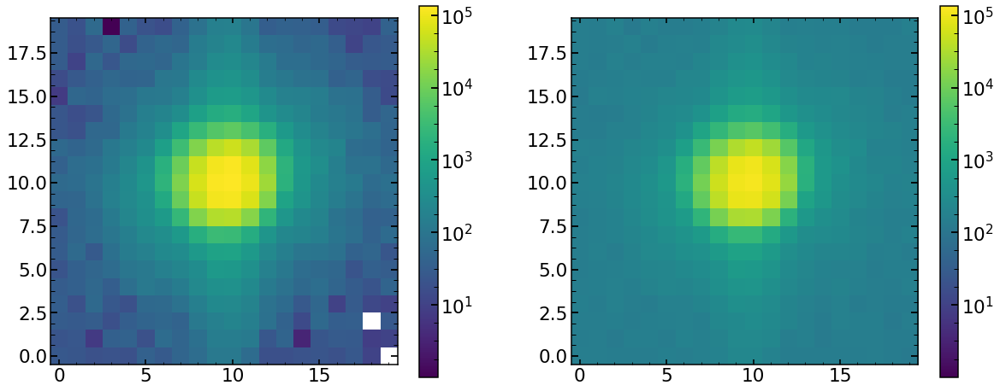

In [68]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [69]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 2654.471874787831
minimal chi2 reduced is: 13.23245854275779


In [70]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)

(31,)
         z4        z5        z6        z7        z8        z9       z10  \
0 -0.665164 -0.453155 -0.880246  0.769558 -0.297597 -0.098772 -0.168677   

        z11  
0 -0.257961  
   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.68945   0.085088  0.048485 -0.114468  0.060701     0.010315   

   radiometricEffect  radiometricExponent    x_ilum    y_ilum  
0           0.000021             0.000021  0.972317  0.948352  
    x_fiber   y_fiber  effective_radius_illumination  frd_sigma  \
0 -0.003823 -0.068759                       0.777994   0.079852   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.964972  1.038411           -0.161835   57843.830767   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.219326              0.001713          0.35  1.804826  0.997683  


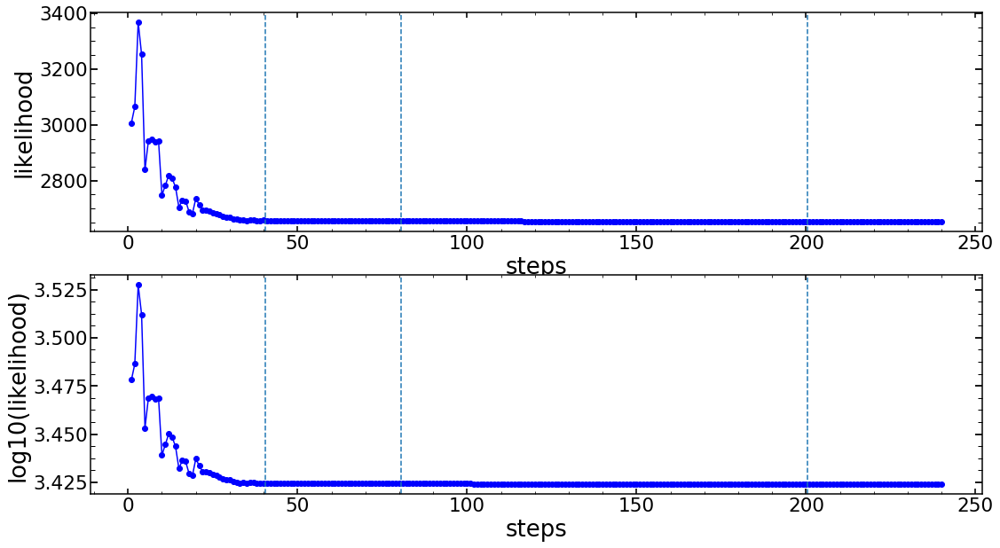

In [71]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [72]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   
       
model(minchain)

None
zmax: 11


-2654.4718747878146

In [73]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

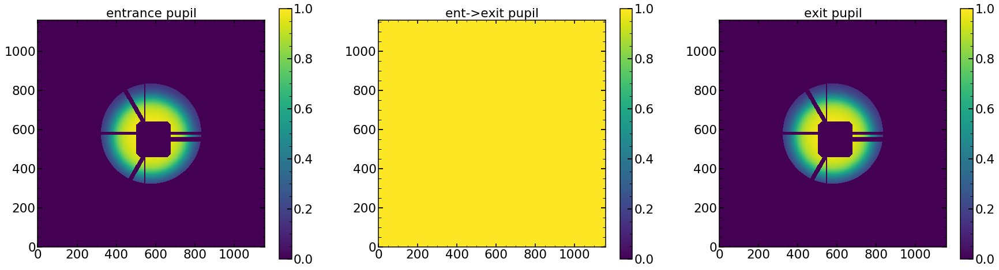

In [74]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

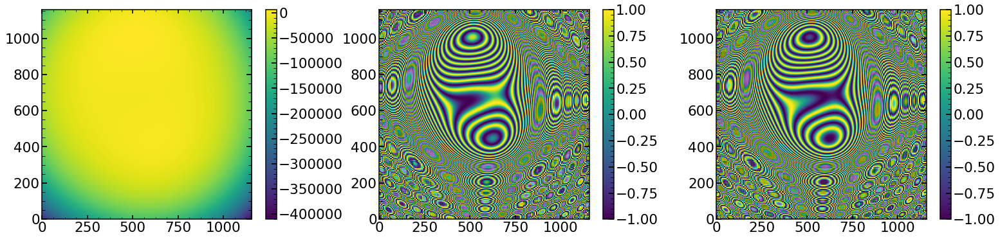

In [75]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

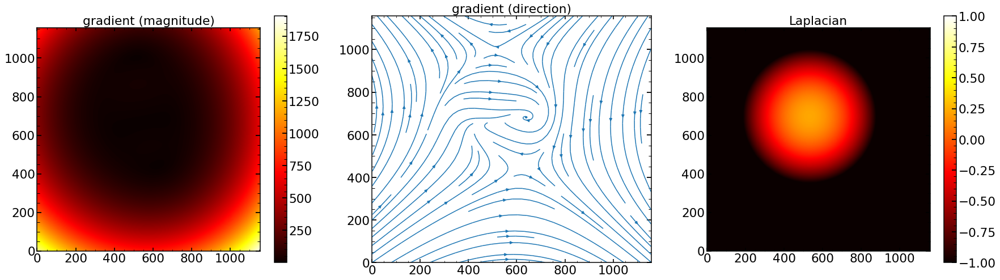

In [76]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

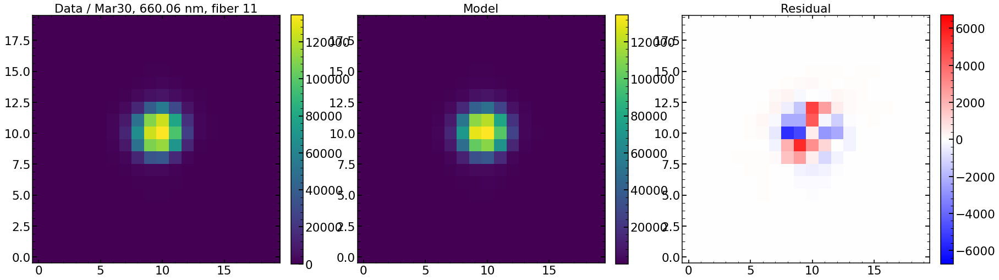

In [77]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', 660.06 nm, fiber 11')
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.title('Residual')
plt.colorbar(fraction=0.046, pad=0.04)

In [57]:
plt.imshow(sci_image_40000/np.sqrt(var_image_40000))
plt.colorbar()

NameError: name 'sci_image_40000' is not defined

In [ ]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image_40000,vmax=np.max(sci_image_40000))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', 660.06 nm, fiber 11')
plt.subplot(1,3,2)
plt.imshow(res_iapetus_40000,vmax=np.max(sci_image_40000))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image_40000-res_iapetus_40000,vmin=-np.max(sci_image_40000)/20,vmax=np.max(sci_image_40000)/20,cmap='bwr')
plt.title('Residual')
plt.colorbar(fraction=0.046, pad=0.04)

In [ ]:
init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
difference_from_max=range(20)-position_of_max_flux
pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
Q

In [ ]:
np.sqrt(40000)

In [ ]:
np.max(sci_image)/np.max(np.sqrt(var_image))

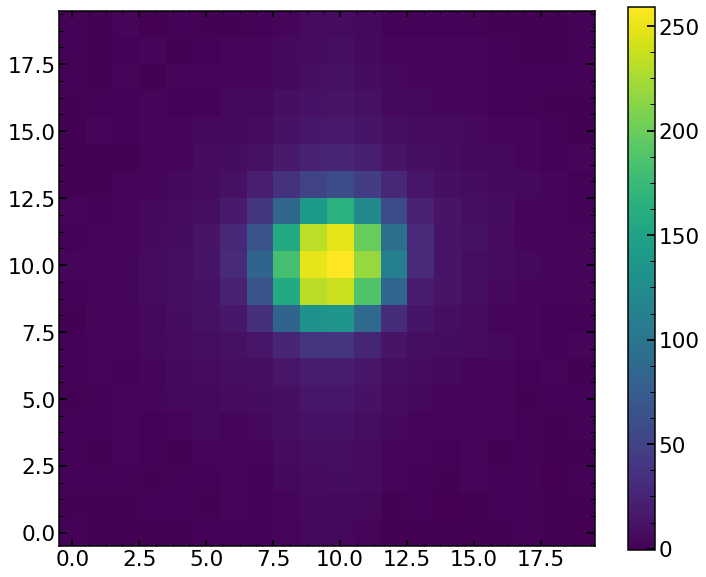

In [58]:
plt.imshow((sci_image)/np.sqrt((var_image*2.4)))
plt.colorbar()

In [59]:
max_flux_cor=np.max(sci_image)/50000
init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image/max_flux_cor,var_image/max_flux_cor,res_iapetus/max_flux_cor)
position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
difference_from_max=range(20)-position_of_max_flux
pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
Q

3.043147933294361

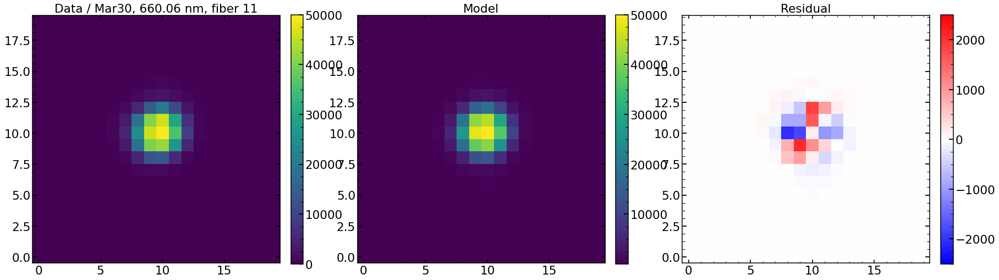

In [60]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image/max_flux_cor,vmax=np.max(sci_image/max_flux_cor))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', 660.06 nm, fiber 11')
plt.subplot(1,3,2)
plt.imshow(res_iapetus/max_flux_cor,vmax=np.max(sci_image/max_flux_cor))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image/max_flux_cor-res_iapetus/max_flux_cor,vmin=-np.max(sci_image/max_flux_cor)/20,vmax=np.max(sci_image/max_flux_cor)/20,cmap='bwr')
plt.title('Residual')
plt.colorbar(fraction=0.046, pad=0.04)

chi**2 reduced is: 13.232458500768274
Abs of residual divided by total flux is: 0.04260416491976011
Abs of residual divided by largest value of a flux in the image is: 0.04161106797231832


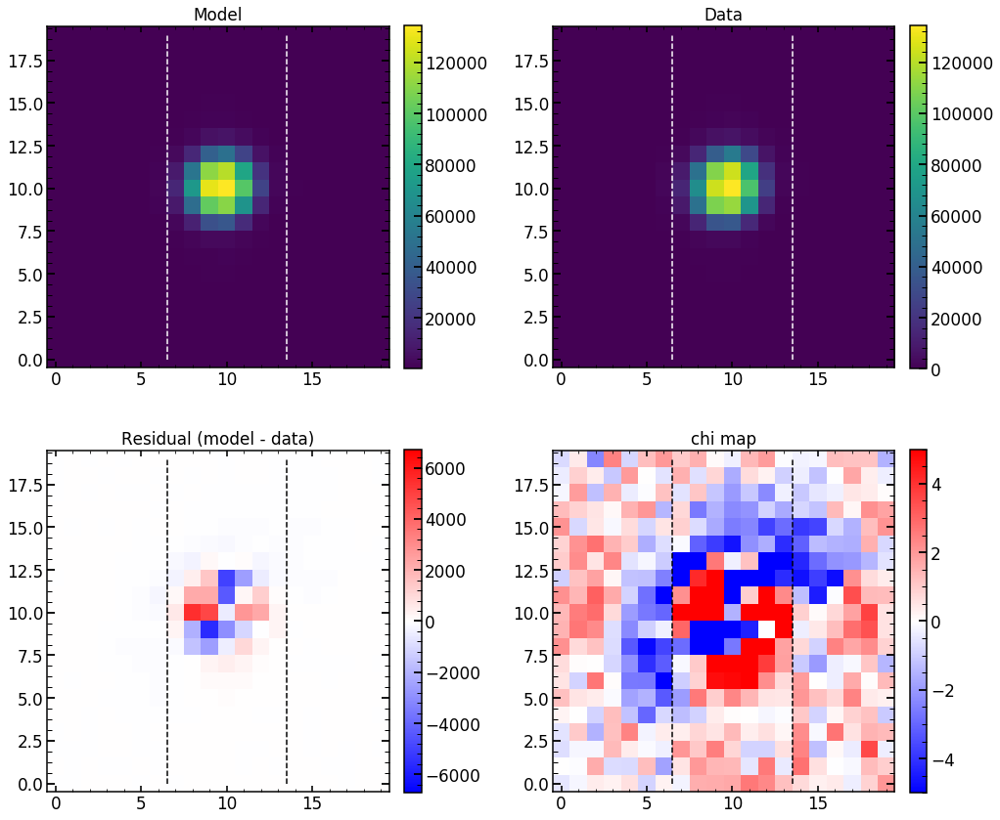

In [1323]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

13.232458500768274
chi**2 reduced is: 13.232458500768274
Abs of residual divided by total flux is: 0.04260416491976011
Abs of residual divided by largest value of a flux in the image is: 0.04161106797231832


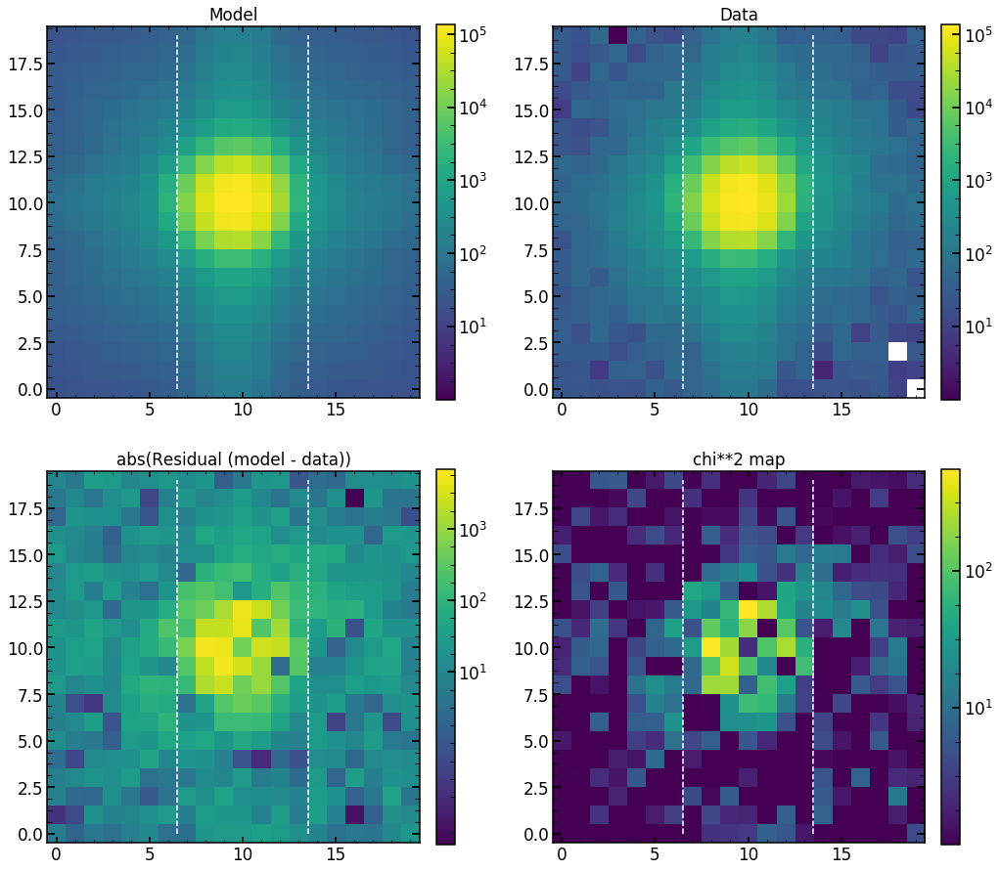

In [1324]:
single_analysis.create_basic_comparison_plot_log()

13.232458500768274
chi**2 reduced is: 13.232458500768274
Abs of residual divided by total flux is: 0.04260416491976011
Abs of residual divided by largest value of a flux in the image is: 0.04161106797231832


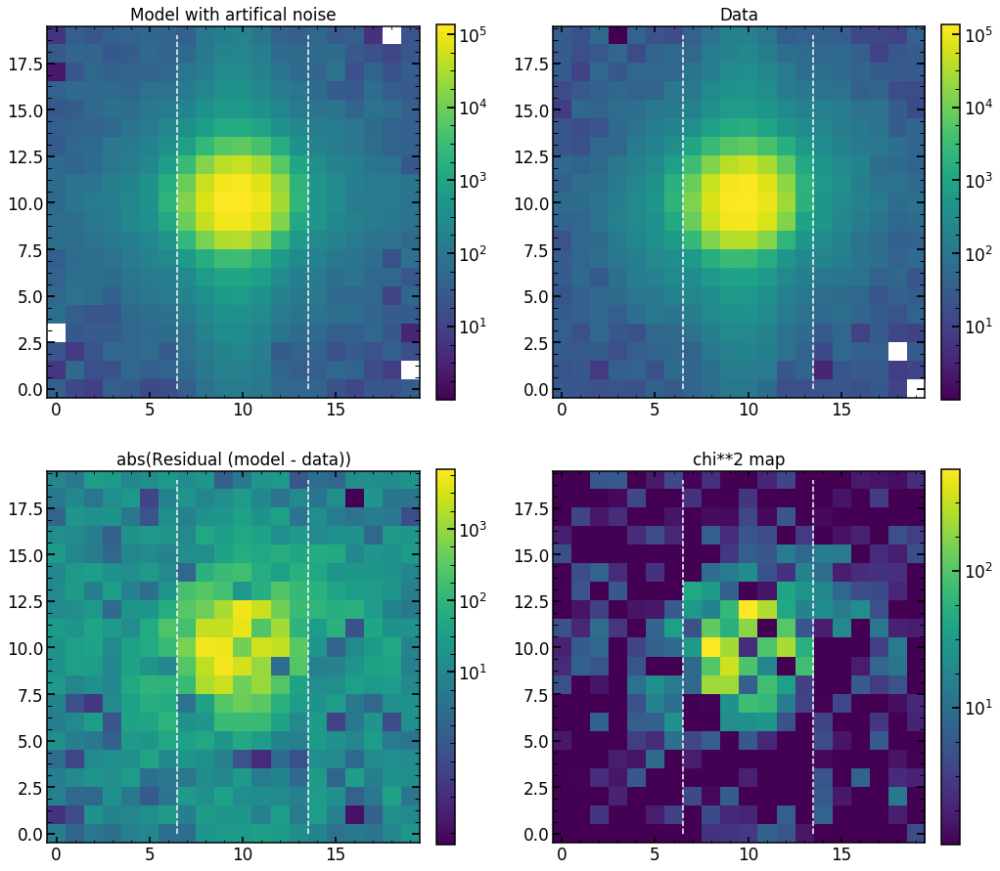

In [1325]:
single_analysis.create_basic_comparison_plot_log_artifical()

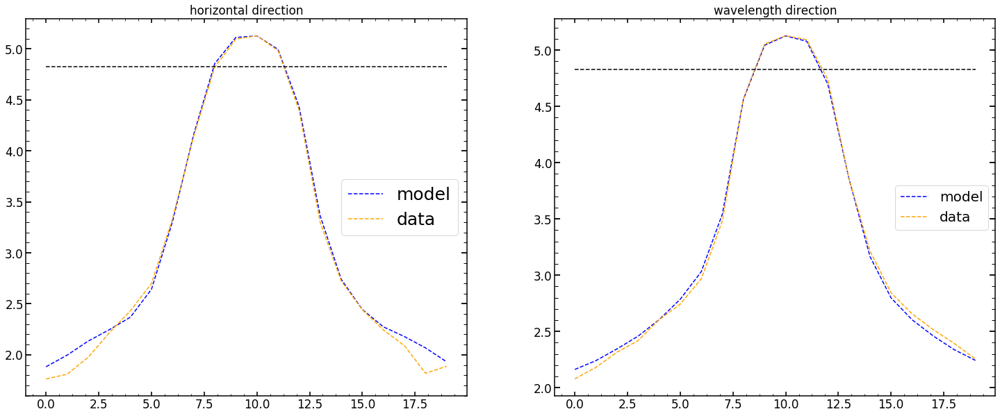

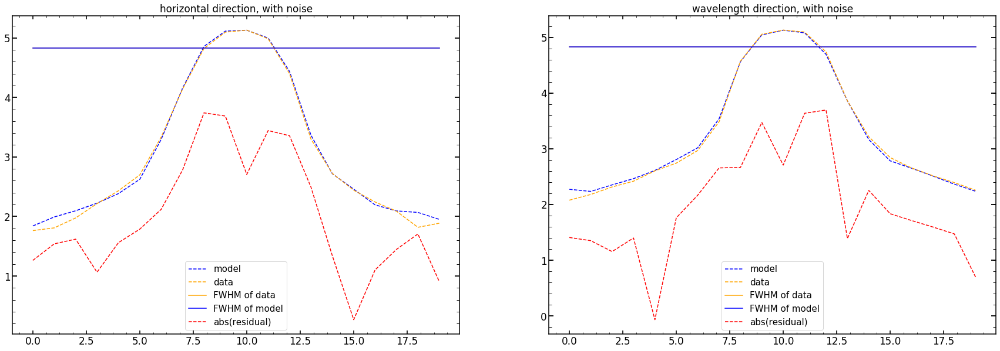

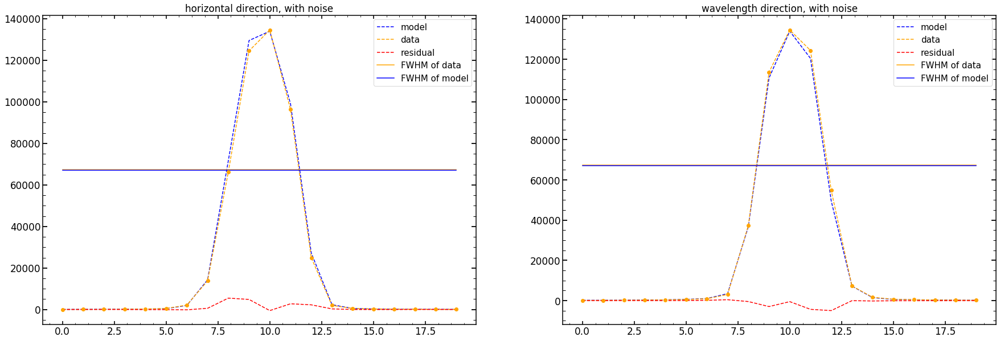

In [1326]:
single_analysis.create_cut_plots()

## Creating  results everywhere

In [163]:
assert date=='Mar30'

results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalHgAr_Feb2019.index,columns=columns11_analysis)
err_results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalHgAr_Feb2019.index,columns=columns11_analysis)

results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_focus_HgAr)
err_results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_focus_HgAr)


results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalNe_Feb2019.index,columns=columns11_analysis)
err_results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_Feb2019),len(columns11_analysis))).reshape(-1,len(columns11_analysis)),index=finalNe_Feb2019.index,columns=columns11_analysis)

results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(results_of_fit_many_single_focus_Ne)
err_results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_focus_Ne)

In [164]:
columns_analysis=columns11_analysis

for single_number in range(len(finalHgAr_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus('Mar30',single_number,'HgAr',11)
    results_of_fit_many_single_focus_HgAr_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_HgAr_pd=results_of_fit_many_single_focus_HgAr_pd[np.abs(results_of_fit_many_single_focus_HgAr_pd['z4'])>0]


for single_number in range(len(finalNe_Feb2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus('Mar30',single_number,'Ne',11)
    results_of_fit_many_single_focus_Ne_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_Ne_pd=results_of_fit_many_single_focus_Ne_pd[np.abs(results_of_fit_many_single_focus_Ne_pd['z4'])>0]


11
0 11748 HgAr is NOT found or failed!
11
1 obs (Emcee3): 11748 is found!
z5: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
2 11748 HgAr is NOT found or failed!
11
3 11748 HgAr is NOT found or failed!
11
4 11748 HgAr is NOT found or failed!
11
5 11748 HgAr is NOT found or failed!
11
6 obs (Emcee3): 11748 is found!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
hscFrac: failed!
strutFrac: failed!
radiometricExponent: failed!
y_ilum: failed!
effective_radius_illum

slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z5: failed!
z6: failed!
z7: failed!
z10: failed!
dxFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
11
60 11748 HgAr is NOT found or failed!
11
61 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: faile

z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
91 11748 HgAr is NOT found or failed!
11
92 11748 HgAr is NOT found or failed!
11
93 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFoca

z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
130 11748 HgAr is NOT found or failed!
11
131 obs (Emcee3): 11748 is found!
z6: failed!
z9: failed!
z10: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z6: failed!
z9: failed!
z10: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: faile

x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
11
166 11748 HgAr is NOT found or failed!
11
167 obs (Emcee3): 11748 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
11
168 11748 HgAr is NOT found or failed!
11
169 obs (Emcee3): 11748 is found!
z5: failed!
z6

z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
12 12355 Ne is NOT found or failed!
11
13 12355 Ne is NOT found or failed!
11
14 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: fail

z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
57 12355 Ne is NOT found or failed!
11
58 12355 Ne is NOT found or failed!
11
59 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_d

y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
11
87 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z1

det_vert: failed!
slitHolder_frac_dx: failed!
11
115 12355 Ne is NOT found or failed!
11
116 12355 Ne is NOT found or failed!
11
117 12355 Ne is NOT found or failed!
11
118 12355 Ne is NOT found or failed!
11
119 obs (Emcee3): 12355 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_si

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
11
142 obs (Emcee3): 12355 is found!
hscFrac: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_fiber: failed!
frd_sigma: failed!
hscFrac: failed!
radiometricEffect: failed!
radiometricExponent: failed!
y_fiber: failed!
frd_sigma: failed!
11
143 12355 Ne is NOT found or failed!


In [165]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_HgAr_pd

,z4,z5,z6,z7,z8,z9,z10,z11,hscFrac,strutFrac,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,2.716648,0.030202,0.069482,0.530722,0.883043,0.163297,-0.327651,-0.043318,0.693919,0.094473,...,1.003684,0.579235,34011.370113,2.105078,0.000883,0.411333,1.814289,0.990802,17.140511,1450.387695
6,2.564138,-0.117611,0.329555,0.202258,0.727708,0.022558,-0.162775,-0.098521,0.705018,0.090801,...,0.990090,0.585529,40091.173550,1.951006,0.000573,0.406754,1.855639,0.998238,2.634333,1304.506836
9,2.518381,-0.822917,-0.027191,-0.207800,0.694276,-0.199409,-0.223353,0.119579,0.705739,0.101472,...,1.023667,0.580873,35268.374030,2.443805,0.002848,0.350000,1.780063,0.994545,45.560385,7273.361328
11,2.720876,-1.005135,-0.265586,-0.405096,0.823384,-0.426787,-0.505620,0.517871,0.702077,0.114268,...,1.062144,0.553953,15747.577641,2.005432,0.001823,0.350000,1.780077,0.991637,4.632227,403.180481
13,2.357658,0.452998,-0.146283,0.570373,0.748583,0.095523,-0.436691,-0.096587,0.694786,0.089734,...,1.009247,0.478528,60263.076941,2.190339,0.001149,0.403088,1.804193,0.998862,2.877677,1336.133789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,-2.441224,-0.012700,-0.585326,-0.252927,-0.224027,-0.295815,-0.261614,0.380060,0.660578,0.093014,...,1.044084,-0.478340,21802.821238,1.500000,0.000278,0.749250,1.979990,0.989434,2.906216,262.233856
181,-2.541120,-0.634358,-0.516982,0.265828,-0.705698,0.177381,-0.142806,-0.088371,0.695291,0.089715,...,0.975225,-0.584567,57183.781920,1.880543,0.000818,0.350000,1.814198,0.996726,3.736511,757.888306
186,-2.395624,-0.067518,-0.437777,-0.110268,-0.578235,0.048443,-0.350276,-0.170143,0.681348,0.081874,...,0.965182,-0.577974,24720.500756,1.500001,0.000128,0.468188,1.854947,0.990801,6.771448,612.405029
189,-2.904470,-0.302910,-0.703408,-0.152150,-0.502159,-0.347352,-0.288819,0.223474,0.668849,0.086147,...,0.999394,-0.560875,37399.537767,1.877305,0.000580,0.541036,1.934797,0.996269,11.805686,2839.623047


In [166]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_Ne_pd

,z4,z5,z6,z7,z8,z9,z10,z11,hscFrac,strutFrac,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
2,3.167279,0.553030,-0.297807,0.766273,1.065719,0.224553,-0.479442,0.140120,0.701642,0.100831,...,1.012662,0.560753,50916.336702,2.365236,0.001950,0.476171,1.816998,0.997798,13.798541,5756.716797
5,2.876357,0.514151,0.062609,0.543104,1.159405,0.324427,-0.255000,-0.337200,0.711100,0.095224,...,1.000466,0.575635,40917.479857,2.539103,0.003028,0.412500,1.780021,0.995080,50.825990,9594.016602
11,2.668662,0.467959,-0.382259,0.750036,0.842110,0.109063,-0.539911,0.041493,0.700038,0.093970,...,1.021055,0.527043,60849.548302,2.305911,0.001948,0.424891,1.825220,0.997958,12.011665,5175.567383
14,2.462050,0.429320,-0.234691,0.590708,0.749498,0.090795,-0.428315,-0.094206,0.704220,0.092176,...,1.007210,0.529935,65179.652894,2.365126,0.002108,0.402484,1.825049,0.998502,15.331971,8799.631836
15,2.418753,0.420266,-0.117284,0.474039,0.688067,0.083045,-0.385959,-0.117594,0.700191,0.089754,...,1.003220,0.518634,52048.813488,2.274286,0.001509,0.394928,1.825188,0.998596,3.208325,1767.616821
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133,-1.836067,-0.436102,-0.458399,0.250443,-0.880923,-0.017045,-0.287460,-0.302126,0.694011,0.085015,...,0.983211,-0.542737,101112.758078,1.805741,0.000426,0.439746,1.878907,0.989361,152.004979,14028.757812
137,-2.161779,-0.591843,-0.646405,0.483886,-0.737147,0.248425,0.006750,0.075029,0.699535,0.095925,...,0.991993,-0.583299,61251.598155,2.142829,0.001707,0.350000,1.780173,0.995269,17.414255,3200.388672
140,-2.340625,-0.624615,-0.550873,0.353762,-0.680991,0.166813,-0.157724,-0.090746,0.701039,0.090839,...,0.981266,-0.577313,62252.732365,2.232717,0.001921,0.350000,1.784565,0.996420,20.475709,5066.739258
141,-2.438993,-0.609985,-0.455772,0.224536,-0.665183,0.137554,-0.193437,-0.106233,0.694712,0.086613,...,0.972072,-0.584207,48651.116829,2.298742,0.002241,0.350000,1.793529,0.995982,5.292266,978.778259


In [167]:
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar30_Focus/' + 'results_of_fit_many_direct_HgAr_from_Mar30.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_HgAr_pd,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar30_Focus/' + 'results_of_fit_many_direct_Ne_from_Mar30.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_Ne_pd,f, protocol=pickle.HIGHEST_PROTOCOL)

## verification

In [87]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='March30'
zMax=11
descriptions=results_of_fit_many_HgAr[label[0]].columns


# i runs through all the parameters
for i in range(0,len(descriptions)):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr=np.array(results_of_fit_many_single_focus_HgAr_pd[descriptions[i]])

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_Ne=np.array(results_of_fit_many_single_focus_Ne_pd[descriptions[i]])

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+str(descriptions[i]))

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
    plt.clf()

KeyError: 'Q'

## Quality control

In [ ]:
assert date=='Mar30'

DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Mar30_Focus/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Mar30.pkl', 'rb') as f:
    results_of_fit_many_single_focus_HgAr_pd=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Mar30.pkl', 'rb') as f:
    results_of_fit_many_single_focus_Ne_pd=pickle.load(f)


In [168]:
## just plotting

for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   

    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:31].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar30_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)    

    
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)
   

    plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='initial removal, fiber nr. 2')
    plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='#984ea3',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='initial removal, fiber nr. 2')
    plt.plot(np.zeros(20),'--')
    plt.ylim(-2500,2500)
    plt.ylabel('flux',size=25)
    plt.xlabel('pixel',size=25)
    plt.xticks(range(20))
    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/March30/1D/'+str(obs)+str(image_index)+str(arc))
    plt.clf()
    
    
for image_index in results_of_fit_many_single_focus_Ne_pd.index.values:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   

    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:31].values

    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar30_Focus/'+str(obs)+str(image_index)+str(arc)+'.npy',res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)
    
    plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='initial removal, fiber nr. 2')
    plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='#984ea3',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='initial removal, fiber nr. 2')
    plt.plot(np.zeros(20),'--')
    plt.ylim(-2500,2500)
    plt.ylabel('flux',size=25)
    plt.xlabel('pixel',size=25)
    plt.xticks(range(20))
    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/March30/1D/'+str(obs)+str(image_index)+str(arc))
    plt.clf()    

None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
z

<Figure size 864x720 with 0 Axes>

In [169]:
res_HgAr=[]
res_HgAr_chi=[]

for image_index in results_of_fit_many_single_focus_HgAr_pd.index.values:
    obs=11748
    eps=5
    arc='HgAr'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   
    minchain=results_of_fit_many_single_focus_HgAr_pd.loc[image_index][:31].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
        
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
    
    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    
    res_HgAr.append(Q)
    res_HgAr_chi.append(chi_50000(sci_image_40000,var_image_40000,res_iapetus_40000))
  
res_Ne=[]
res_Ne_chi=[]
    
for image_index in results_of_fit_many_single_focus_Ne_pd.index.values:
    obs=12355
    eps=5
    arc='Ne'

    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(image_index)+str(arc)+'_Stacked.npy')

    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   
    minchain=results_of_fit_many_single_focus_Ne_pd.loc[image_index][:31].values
    model(minchain)

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    
    sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
    init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)
    
    position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
    difference_from_max=range(20)-position_of_max_flux
    pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
    Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))
    
    res_Ne.append(Q)
    res_Ne_chi.append(chi_50000(sci_image_40000,var_image_40000,res_iapetus_40000))

None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
zmax: 11
None
z

## Q values global plot 

In [170]:
from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='March30'
zMax=11
descriptions='Q'


# i runs through all the parameters
for i in range(0,1):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['yc'].values
    values_HgAr=res_HgAr

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['yc'].values
    values_Ne=res_Ne

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=1
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=1, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+'Q'+' value')

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'Q'+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'Q'+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+'Q'+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+'Q'+" "+str(descriptions[i]))
    plt.clf()

<Figure size 864x720 with 0 Axes>

In [171]:

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='March30'
zMax=11
descriptions='Q'


# i runs through all the parameters
for i in range(0,1):
    # take values for HgAr

    x_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['xc_effective'].values
    y_HgAr=finalHgAr_Feb2019.loc[results_of_fit_many_single_focus_HgAr_pd.index.values]['yc'].values
    values_HgAr=res_HgAr_chi

    # take values for Neon        
    x_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['xc_effective'].values
    y_Ne=finalNe_Feb2019.loc[results_of_fit_many_single_focus_Ne_pd.index.values]['yc'].values
    values_Ne=res_Ne_chi

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=1
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=1, vmax=20,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+'res_chi'+' value')

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'res_chi'+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+'res_chi'+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+'chi_res'+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+'chi_res'+" "+str(descriptions[i]))
    plt.clf()

<Figure size 864x720 with 0 Axes>

In [172]:
res_Ne_chi_Mar30=res_Ne_chi
res_Ne_Mar30=res_Ne
res_HgAr_chi_Mar30=res_HgAr_chi
res_HgAr_Mar30=res_HgAr

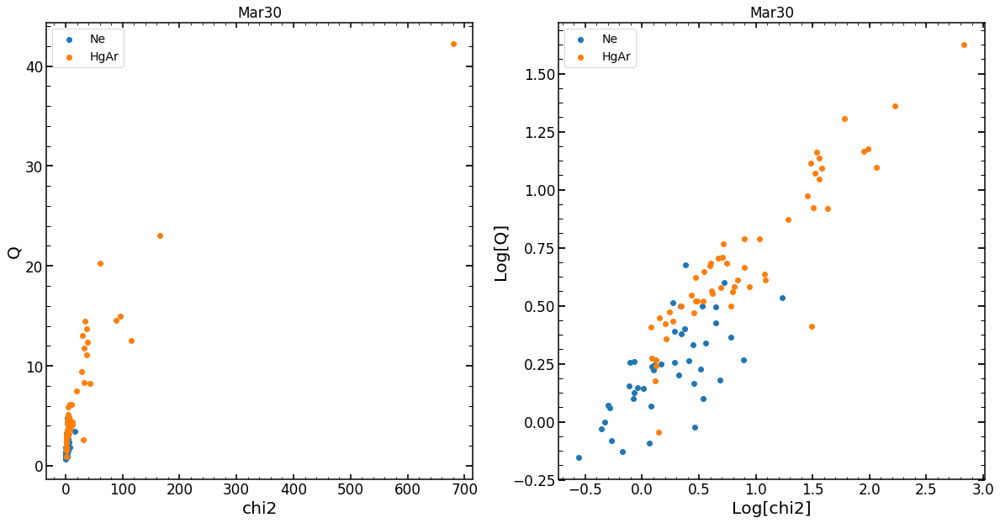

In [173]:
plt.figure(figsize=(20,10))
plt.subplot(121)
plt.scatter(res_Ne_chi_Mar30,res_Ne_Mar30,label='Ne')
plt.scatter(res_HgAr_chi_Mar30,res_HgAr_Mar30,label='HgAr')
plt.xlabel('chi2')
plt.ylabel('Q')
plt.title('Mar30')
plt.legend()

plt.subplot(122)
plt.scatter(np.log10(res_Ne_chi_Mar30),np.log10(res_Ne_Mar30),label='Ne')
plt.scatter(np.log10(res_HgAr_chi_Mar30),np.log10(res_HgAr_Mar30),label='HgAr')
plt.xlabel('Log[chi2]')
plt.ylabel('Log[Q]')
plt.title('Mar30')
plt.legend()

# Comparison of Mar26 and Mar30

In [182]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Mar30_Focus/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Mar30.pkl', 'rb') as f:
    results_of_fit_many_single_focus_HgAr_pd_Mar30=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Mar30.pkl', 'rb') as f:
    results_of_fit_many_single_focus_Ne_pd_Mar30=pickle.load(f)

In [183]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Mar26_Focus/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Mar26.pkl', 'rb') as f:
    results_of_fit_many_single_focus_HgAr_pd_Mar26=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Mar26.pkl', 'rb') as f:
    results_of_fit_many_single_focus_Ne_pd_Mar26=pickle.load(f)

(1, 10)

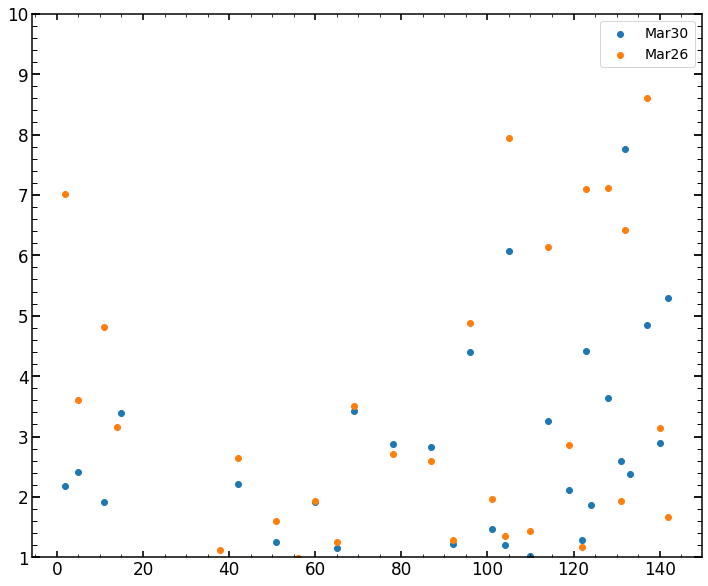

In [206]:
plt.scatter(results_of_fit_many_single_focus_Ne_pd_Mar30.index.values,res_Ne_chi_Mar30,label='Mar30')
plt.scatter(results_of_fit_many_single_focus_Ne_pd_Mar26.index.values,res_Ne_chi_Mar26,label='Mar26')
plt.legend()
plt.ylim(1,10)

(1, 10)

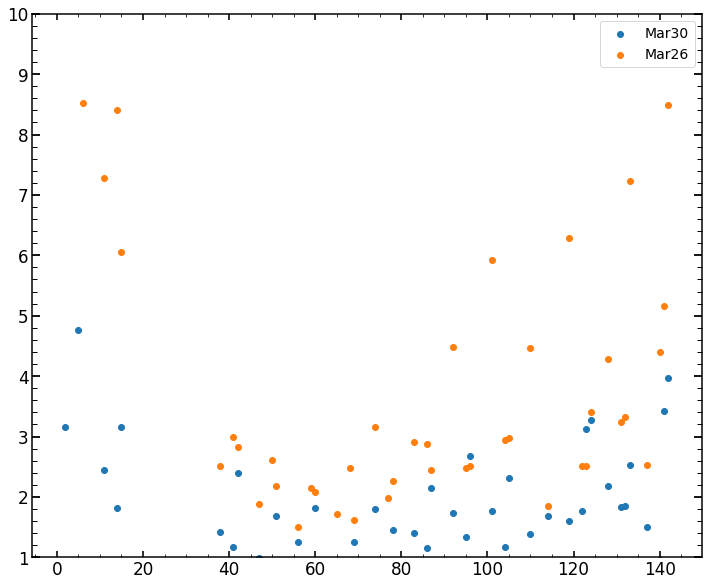

In [205]:
plt.scatter(results_of_fit_many_single_focus_Ne_pd_Mar30.index.values,res_Ne_Mar30,label='Mar30')
plt.scatter(results_of_fit_many_single_focus_Ne_pd_Mar26.index.values,res_Ne_Mar26,label='Mar26')
plt.legend()
plt.ylim(1,10)

(1, 10)

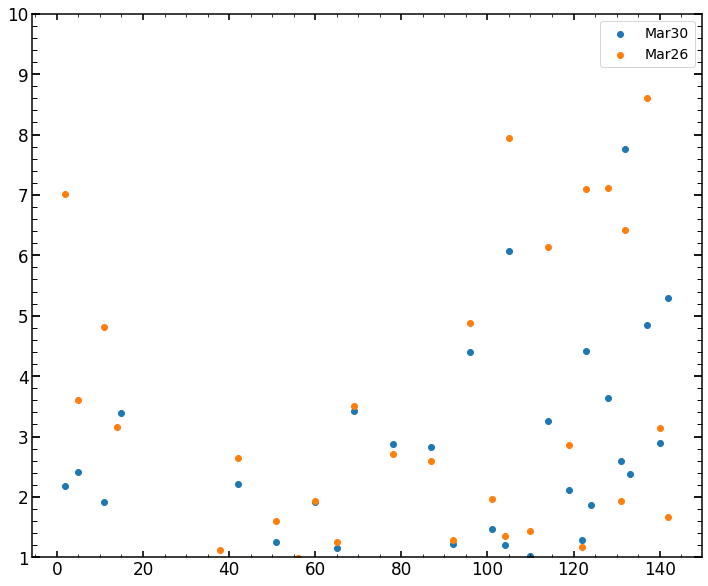

In [202]:
plt.scatter(results_of_fit_many_single_focus_Ne_pd_Mar30.index.values,res_Ne_chi_Mar30,label='Mar30')
plt.scatter(results_of_fit_many_single_focus_Ne_pd_Mar26.index.values,res_Ne_chi_Mar26,label='Mar26')
plt.legend()
plt.ylim(1,10)

In [204]:
len(res_Ne_Mar30)

43

In [192]:
results_of_fit_many_single_focus_HgAr_pd_Mar30.index.values

array([  1,   6,   9,  11,  13,  18,  21,  23,  49,  54,  57,  59,  61,
        66,  69,  71,  73,  78,  81,  83,  85,  90,  93,  95,  97, 102,
       105, 107, 109, 114, 117, 119, 126, 129, 131, 133, 138, 141, 143,
       145, 150, 153, 155, 157, 162, 165, 167, 169, 174, 177, 179, 181,
       186, 189, 191])

# Trying to solve at each spot individually 

## Construct a solution at one spot position 

In [553]:
    single_number=102
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single('March22',single_number,'HgAr',11)
    solution_at_0=solution_at_0_and_plots('March22',single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,11)

11
102 obs (Emcee3): 11796 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 11790 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
102 obs (Emcee3): 11784 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
102 11778 HgAr is NOT found or failed!
102 11772 HgAr is NOT found or failed!
102 11766 HgAr is NOT found or failed!
102 obs (Emcee3): 11760 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 11754 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: 

In [554]:
solution_at_0

array([   -0.83590648,    -0.2054081 ,    -0.42008644,     0.29583311,
          -0.0079353 ,     0.00265857,    -0.2645791 ,    -0.43595932,
           0.68081149,     0.07713529,     0.00830818,     0.01148621,
           0.06101173,     0.00871411,     0.00000017,     0.00000016,
           0.97281742,     0.94833808,    -0.0080463 ,    -0.06511615,
           0.82896283,     0.10363419,     0.87279571,     1.02065793,
          -0.04021679, 82615.33725161,     2.41431673,     0.00197545,
           0.35022209,     1.83833508,     0.99851325])

In [551]:
results_of_fit_many_HgAr['m3'].loc[102]

z4                               2.123754e+01
z5                               5.851835e-02
z6                              -8.138146e-01
z7                               3.333238e-01
z8                              -1.531643e-02
z9                               6.634746e-02
z10                             -2.829050e-01
z11                             -3.204923e-01
hscFrac                          6.878425e-01
strutFrac                        7.179558e-02
dxFocal                          6.305045e-03
dyFocal                          9.566706e-03
slitFrac                         6.065862e-02
slitFrac_dy                      8.778588e-03
radiometricEffect                1.687300e-07
radiometricExponent              1.535500e-07
x_ilum                           9.728174e-01
y_ilum                           9.483381e-01
x_fiber                         -1.122663e-02
y_fiber                         -7.015320e-02
effective_radius_illumination    8.592143e-01
frd_sigma                        9

In [557]:
results_of_fit_many_interpolation_HgAr['m4']

,z4,z5,z6,z7,z8,z9,z10,z11,hscFrac,strutFrac,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
0,31.828563,-1.031753,-0.137096,0.450644,0.737127,-0.031777,-0.217687,0.163929,0.703323,0.092680,...,1.003704,0.572926,100000.000000,2.384730,0.002283,0.380011,1.828885,0.999077,0.0,0.0
1,31.844694,-1.053502,-0.129579,0.433039,0.733474,-0.032394,-0.219781,0.149796,0.702989,0.092245,...,1.001907,0.572610,97100.698326,2.392390,0.002296,0.380008,1.828885,0.999078,0.0,0.0
2,31.877175,-1.093903,-0.118777,0.401722,0.727996,-0.033876,-0.223324,0.127666,0.702453,0.091578,...,0.998968,0.572605,100000.000000,2.405193,0.002323,0.380004,1.828885,0.999076,0.0,0.0
3,31.947649,-1.178440,-0.112165,0.339670,0.717516,-0.038049,-0.230339,0.091363,0.701481,0.090566,...,0.994260,0.572596,100000.000000,2.428506,0.002402,0.379995,1.828885,0.999056,0.0,0.0
4,31.988317,-1.225617,-0.117005,0.306896,0.712192,-0.040950,-0.234042,0.076438,0.701020,0.090206,...,0.992402,0.572592,100000.000000,2.439661,0.002458,0.379990,1.828885,0.999038,0.0,0.0
5,32.088377,-1.337763,-0.150087,0.233680,0.700861,-0.049294,-0.242307,0.054456,0.700128,0.089868,...,0.989930,0.572583,100000.000000,2.461486,0.002623,0.379981,1.828885,0.998975,0.0,0.0
6,32.227324,-1.486376,-0.234378,0.145452,0.688330,-0.063067,-0.252253,0.050628,0.699328,0.090393,...,0.990302,0.572574,74763.523264,2.481610,0.002899,0.379973,1.828885,0.998855,0.0,0.0
7,32.387225,-1.648749,-0.367043,0.059062,0.678304,-0.080903,-0.261764,0.074354,0.698912,0.092022,...,0.994521,0.573196,100000.000000,2.493801,0.003257,0.379967,1.828885,0.998687,0.0,0.0
8,32.530959,-1.789896,-0.512213,-0.009223,0.671565,-0.098394,-0.269222,0.114064,0.698848,0.094171,...,1.000914,0.573820,100000.000000,2.497710,0.003611,0.379964,1.828885,0.998515,0.0,0.0
9,32.915613,-2.152242,-0.985264,-0.161379,0.660887,-0.149936,-0.285608,0.280309,0.699694,0.102154,...,1.026507,0.575702,59160.428137,2.485162,0.004659,0.379964,1.828885,0.997983,0.0,0.0


In [591]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)

date='Mar27'
obs=str(11748)
single_number='102'
image_index=int(single_number)
eps=5
arc='HgAr'


STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Stamps_cleaned/"

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=12355    
else:
    print("Not recognized arc-line")

if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe    
else:
    print("Not recognized arc-line")    
        
finalArc.loc[int(single_number)]

0d


fiber                           8
xc                           2133
yc                           1955
wavelength               795.0522
close                           1
lamp                         HgAr
xc_effective                 2202
old_index_approx               66
superold_index_approx        55.0
Name: 102, dtype: object

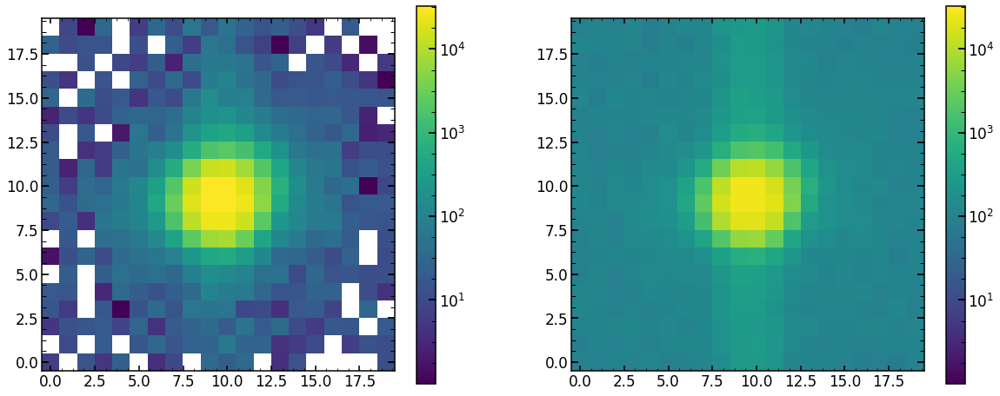

In [592]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])


In [593]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (186, 20, 31)
minimal likelihood is: 685.5368291293883
minimal chi2 reduced is: 3.39107065318522


In [594]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)

(31,)
         z4        z5        z6        z7        z8        z9       z10  \
0 -0.558855 -0.205408 -0.420086  0.295833 -0.007935  0.002659 -0.264579   

        z11  
0 -0.435959  
    hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.680811   0.077135  0.008308  0.011486  0.061012     0.008714   

   radiometricEffect  radiometricExponent    x_ilum    y_ilum  
0       1.700000e-07         1.600000e-07  0.972817  0.948338  
    x_fiber   y_fiber  effective_radius_illumination  frd_sigma  \
0 -0.008046 -0.065116                       0.828963   0.103634   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.872796  1.020658           -0.040217   51379.810479   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.354136                0.0021      0.350006  1.837655  0.998291  


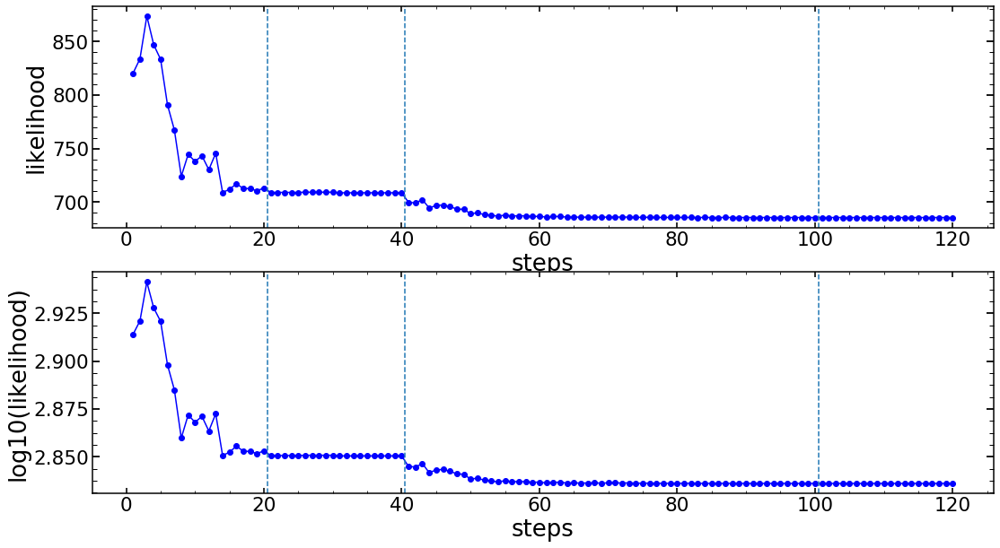

In [595]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [596]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=11)   
       
model(minchain)

None
zmax: 11


-685.5368291293886

In [597]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

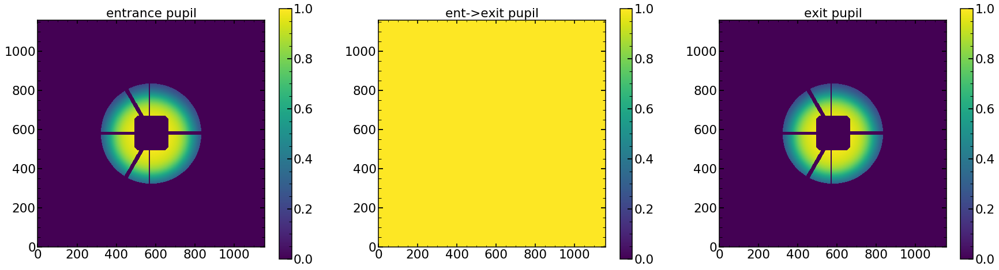

In [598]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

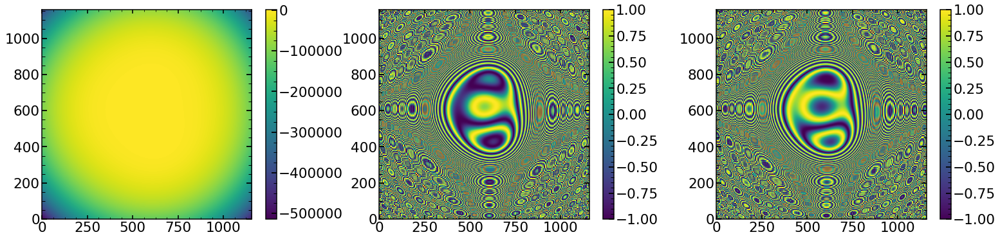

In [599]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

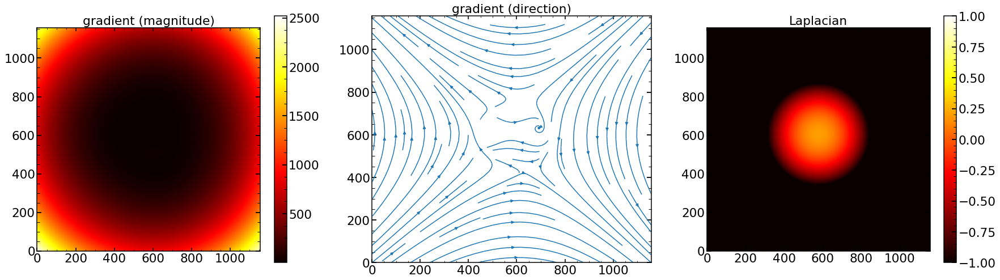

In [600]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

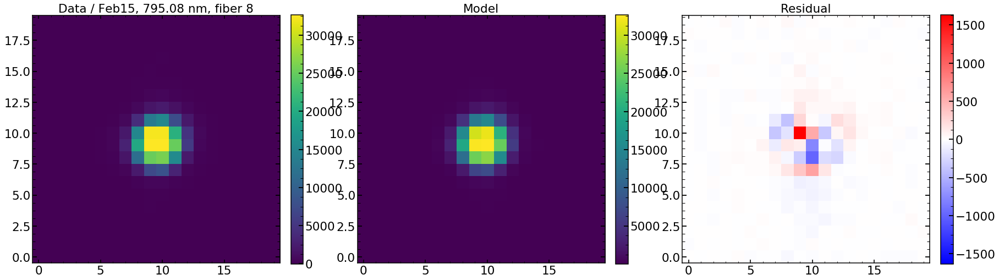

In [601]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / Feb15, 795.08 nm, fiber 8')
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.title('Residual')
plt.colorbar(fraction=0.046, pad=0.04)

chi**2 reduced is: 3.391070626795345
Abs of residual divided by total flux is: 0.03716046639445872
Abs of residual divided by largest value of a flux in the image is: 0.05356968117014513


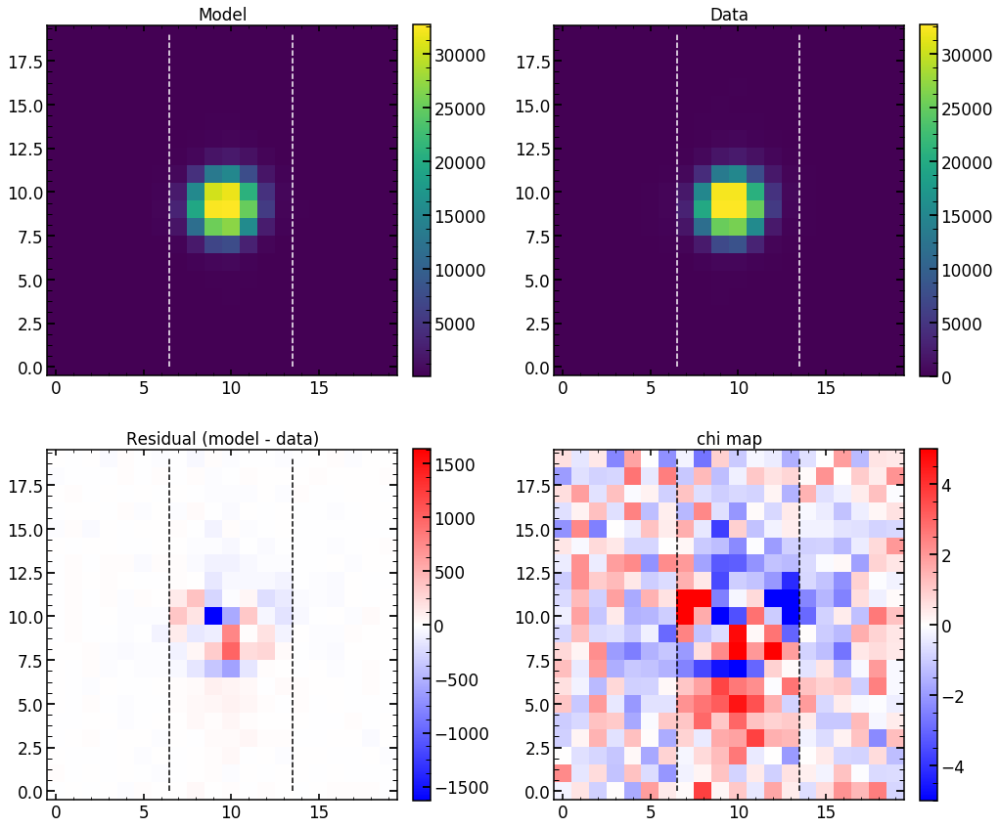

In [602]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

3.391070626795345
chi**2 reduced is: 3.391070626795345
Abs of residual divided by total flux is: 0.03716046639445872
Abs of residual divided by largest value of a flux in the image is: 0.05356968117014513


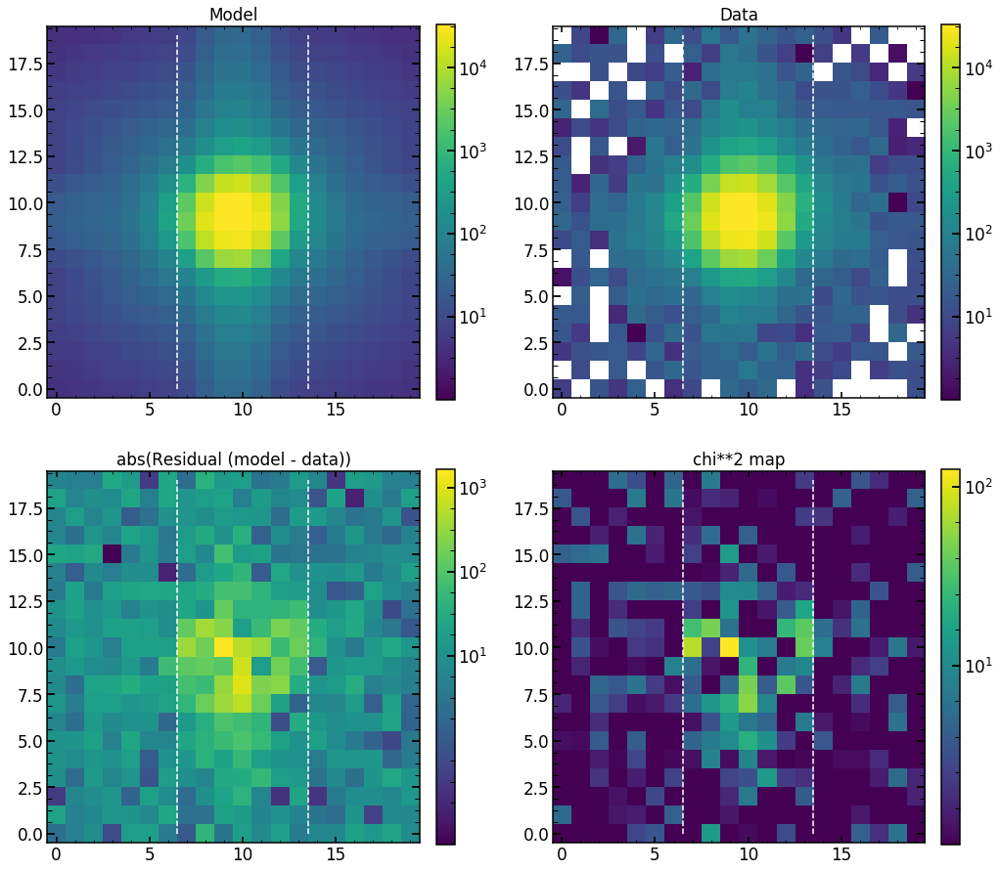

In [603]:
single_analysis.create_basic_comparison_plot_log()

3.391070626795345
chi**2 reduced is: 3.391070626795345
Abs of residual divided by total flux is: 0.03716046639445872
Abs of residual divided by largest value of a flux in the image is: 0.05356968117014513


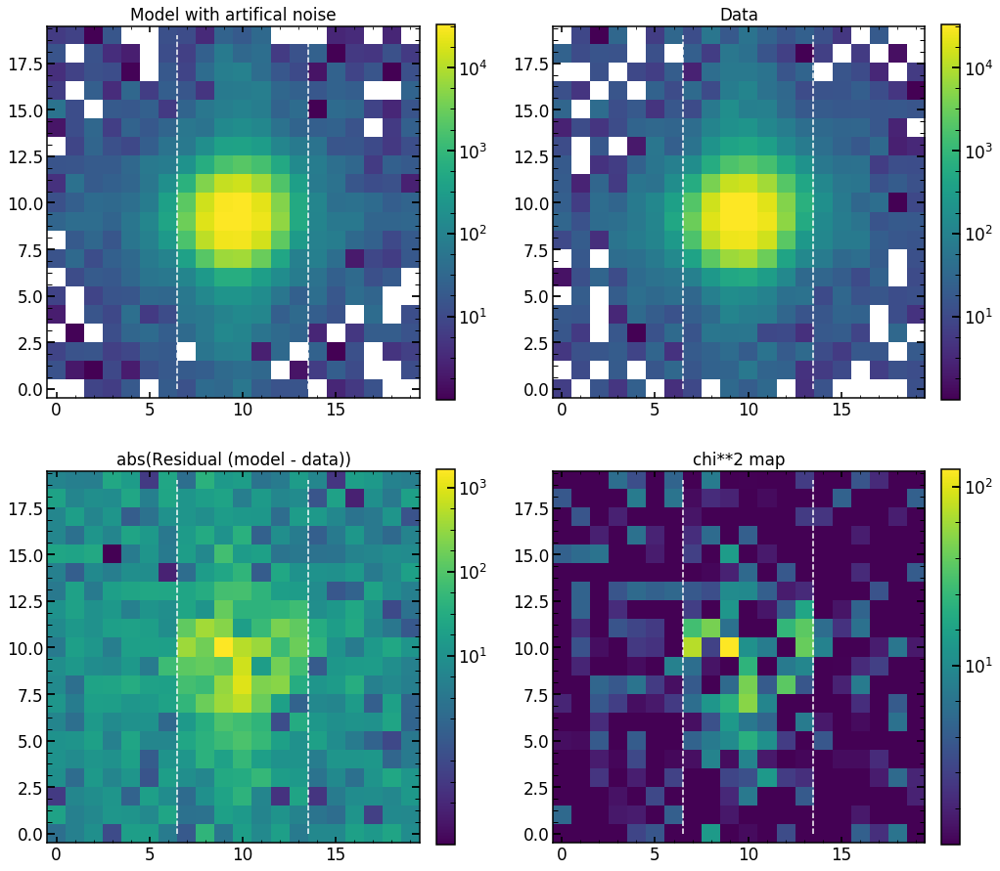

In [604]:
single_analysis.create_basic_comparison_plot_log_artifical()

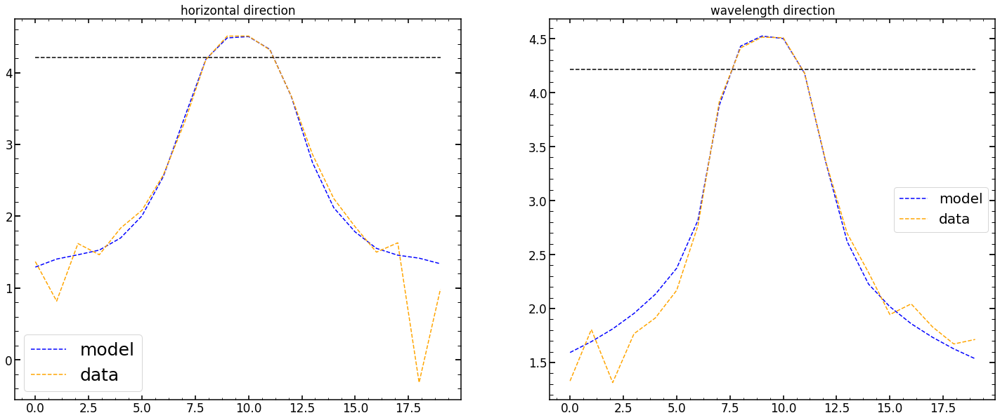

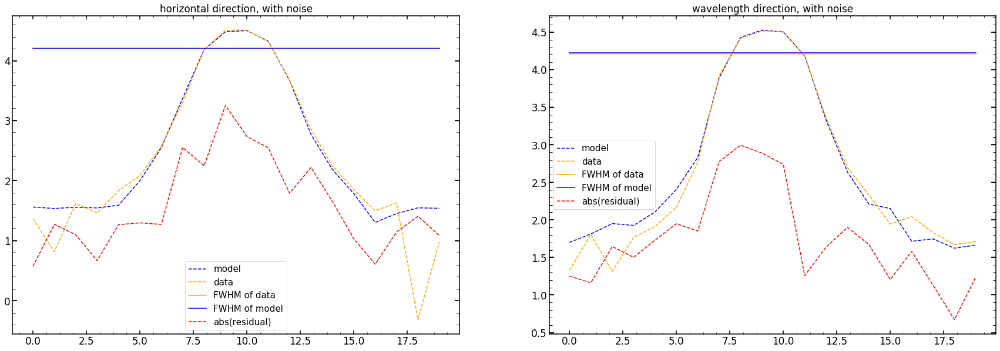

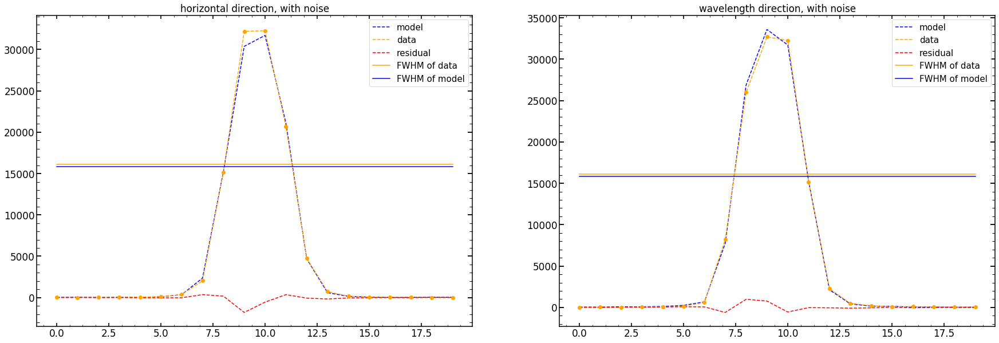

In [605]:
single_analysis.create_cut_plots()

# Trying to solve at each spot individually and more Zernike

## Find solution at each defocus

In [586]:
def solution_at_position_and_plots(date,single_number,arc,results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,plot=True,zMax=None,defocus=None):
    """create solution at the focus and plot dependence with defocu

    @param[in] date             date when the analysis was conducted
    @param[in] single_number    number of the image
    @param[in] arc              which arc was analyzed
  
    """    
    
    label=['m45','m4','m35','m3','m25','m2','m15','m1','m05','0','p05','p1','p15','p2','p25','p3','p35','p4','p45']

    print('defocus: '+str(defocus))
    if defocus is None:
        defocus_index=9
    else:
        defocus_index=list(label).index(defocus)
        print('defocus_index: '+str(defocus_index))
    
    if zMax==22:
        columns_analysis=columns22_analysis
        columns=columns22
        z_addition_factor=11
    else:
        columns_analysis=columns11_analysis
        columns=columns11
        z_addition_factor=0
    
    results_of_fit_single=results_of_fit_single[np.abs(results_of_fit_single['z4'])>0]
    err_results_of_fit_single=err_results_of_fit_single[np.abs(err_results_of_fit_single['z4'])>0]
    err_results_of_fit_single_lower=err_results_of_fit_single_lower[np.abs(err_results_of_fit_single_lower['z4'])>0]
    err_results_of_fit_single_upper=err_results_of_fit_single_upper[np.abs(err_results_of_fit_single_upper['z4'])>0]    
    
    if len(results_of_fit_single)<=6:
        if zMax==22:
            solution_at_0=np.full(31+11,0)

        else:
            solution_at_0=np.full(31,0)       

        return solution_at_0
    else:
        IMAGES_FOLDER='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/'

        solution_at_0=[]

        for q in columns_analysis:

            z4_arr=np.array(results_of_fit_single[q])
            z4_arr_err=np.array(err_results_of_fit_single[q])
            z4_arr_err_up=np.array(err_results_of_fit_single_upper[q])
            z4_arr_err_low=np.array(err_results_of_fit_single_lower[q])
            index_arr=results_of_fit_single[q].index.values.astype(float)
            #print(q)
            #print(index_arr)
            #print(z4_arr)
            #print(z4_arr_err)
            #print(z4_arr_err_up)
            #print(z4_arr_err_low)
            
            z4_arr_no0=z4_arr[np.abs(index_arr)>0.5]
            z4_arr_no0_err=z4_arr_err[np.abs(index_arr)>0.5]
            z4_arr_no0_err_up=z4_arr_err_up[np.abs(index_arr)>0.5]
            z4_arr_no0_err_low=z4_arr_err_low[np.abs(index_arr)>0.5]
            index_arr_no0=index_arr[np.abs(index_arr)>0.5]
            #print(q)
            #print(index_arr_no0)
            #print(z4_arr_no0)
            #print(z4_arr_no0_err)
            #print(z4_arr_no0_err_up)
            #print(z4_arr_no0_err_low)
            
            
            z4_arr_only0=z4_arr[np.abs(index_arr)<=0.5]
            z4_arr_only0_err=z4_arr_err[np.abs(index_arr)<=0.5]
            z4_arr_only0_err_up=z4_arr_err_up[np.abs(index_arr)<=0.5] 
            z4_arr_only0_err_low=z4_arr_err_low[np.abs(index_arr)<=0.5]
            index_arr_only0=index_arr[np.abs(index_arr)<=0.5]

            fit_res=[]
            interim_zero_solutions=[]

            
            if q in columns[:8+z_addition_factor]:
                # these variables are fit via linear fit, without values at focus
                # it is z4-z11
                # for loop below removes 2 points from the fit that create largest deviations from median result in focus
                for l in range(len(index_arr_no0)):
                    #print('good_index'+str(np.delete(index_arr_no0,l)))
                    #print('index_arr_no0'+str(np.delete(z4_arr_no0,l)))
                    #print('z4_arr_no0_err_low'+str(np.delete(z4_arr_no0_err_low,l)))
                    #print('z4_arr_no0_err_up'+str(np.delete(z4_arr_no0_err_up,l)))
                    popt=optimize.leastsq(curve_fit_custom_lin,x0=[1,1],args=(np.delete(index_arr_no0,l),np.delete(z4_arr_no0,l), np.delete(z4_arr_no0_err_low,l),np.delete(z4_arr_no0_err_up,l)))[0]
                    interim_zero_solutions.append([l,lin_fit_1D(0,popt[0],popt[1])])
                interim_zero_solutions_arr=np.array(interim_zero_solutions)
                interim_zero_solutions_arr_dif=np.abs(interim_zero_solutions_arr[:,1]-np.median(interim_zero_solutions_arr[:,1]))
                second_max_dif=np.sort(interim_zero_solutions_arr_dif)[-2]
                interim_zero_solutions_arr=interim_zero_solutions_arr[interim_zero_solutions_arr_dif<second_max_dif]
                #print(interim_zero_solutions_arr[:,0])
                good_index=interim_zero_solutions_arr[:,0].astype(int)
                #print('good_index'+str(good_index))
                #print('index_arr_no0'+str(index_arr_no0))
                #print('z4_arr_no0_err_low'+str(z4_arr_no0_err_low))
                #print('z4_arr_no0_err_up'+str(z4_arr_no0_err_up))
                popt=optimize.leastsq(curve_fit_custom_lin,x0=[1,1],args=(np.array(index_arr_no0)[good_index],np.array(z4_arr_no0)[good_index],np.array(z4_arr_no0_err_low)[good_index],np.array(z4_arr_no0_err_up)[good_index]))[0]
                #print(popt)
                for i in np.linspace(-4.5,4.5,19):
                    fit_res.append(lin_fit_1D(i,popt[0],popt[1]))
                solution_at_0.append(fit_res[defocus_index])

            interim_zero_solutions=[]
            if q in columns[8+z_addition_factor:25+z_addition_factor]:
                # these variables are set at mean value (constant fit), without values at focus
                # these are variables that describe the pupil
                for l in range(len(index_arr_no0)):
                    popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(np.delete(index_arr_no0,l),np.delete(z4_arr_no0,l), np.delete(z4_arr_no0_err_low,l),np.delete(z4_arr_no0_err_up,l)))[0]
                    interim_zero_solutions.append([l,popt[0]])
                interim_zero_solutions_arr=np.array(interim_zero_solutions)
                interim_zero_solutions_arr_dif=np.abs(interim_zero_solutions_arr[:,1]-np.median(interim_zero_solutions_arr[:,1]))
                third_max_dif=np.sort(interim_zero_solutions_arr_dif)[-3]
                interim_zero_solutions_arr=interim_zero_solutions_arr[interim_zero_solutions_arr_dif<=(third_max_dif*1.1)]
                #print(interim_zero_solutions_arr[:,0])
                good_index=interim_zero_solutions_arr[:,0].astype(int)
                popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(np.array(index_arr_no0)[good_index],np.array(z4_arr_no0)[good_index],np.array(z4_arr_no0_err_low)[good_index],np.array(z4_arr_no0_err_up)[good_index]))[0]
                fit_res=lin_fit_1DConstant(np.linspace(-4.5,4.5,19),popt[0])
                solution_at_0.append(fit_res[defocus_index])

            if q in np.concatenate((np.array(columns[25+z_addition_factor:]),np.array(['chi2','chi2max'])),axis=0):
                # these variables are set at value as measured at 0 - (perhaps is should be close to 0)
                if z4_arr_only0.size==1:
                    for i in np.linspace(-4.5,4.5,19):
                        fit_res.append(z4_arr_only0) 
                    solution_at_0.append(fit_res[defocus_index])
                else:
                    # these variables are set at mean value (constant fit), without values at focus
                    popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(index_arr_only0, z4_arr_only0, z4_arr_only0_err_low,z4_arr_only0_err_up))[0]
                    fit_res=lin_fit_1DConstant(np.linspace(-4.5,4.5,19),popt[0])
                    solution_at_0.append(fit_res[defocus_index])


            #making plots here
            ######
            #print(q)
            #print(fit_res)
            plt.figure(figsize=(20,10))
            plt.errorbar(index_arr,z4_arr,yerr=[np.abs(z4_arr_err_low),z4_arr_err_up],color='blue',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='single fit results')
            plt.plot(np.linspace(-4.5,4.5,19),fit_res,color='orange',label='fit')
            if q in columns[:8]:
                plt.plot(np.linspace(-4.5,4.5,19),np.zeros((19,1)),':',color='black')
            plt.plot([0], [fit_res[9]], marker='o', markersize=10, color="red",label='prediction for focus')
            #print('prediction for focus: '+str(q)+' '+str(fit_res[9]))
            plt.title(q,size=40)
            plt.legend(fontsize=25)
            plt.xlabel('defocus lab [mm]',size=30)
            plt.ylabel('defocus model',size=30)
            #print(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/')
            if not os.path.exists(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/'):
                os.makedirs(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/')
            plt.savefig(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/'+str(arc)+str(q))

            if not os.path.exists(IMAGES_FOLDER+'Defocus/'+str(q)+'/'):
                os.makedirs(IMAGES_FOLDER+'Defocus/'+str(q)+'/')
            plt.savefig(IMAGES_FOLDER+'Defocus/'+str(q)+'/'+str(arc)+str(single_number))

            plt.close()   
            ######

        solution_at_0=np.array(solution_at_0)[:len(solution_at_0)-2]
        return solution_at_0

In [587]:
single_number=102
results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single('March22',single_number,'HgAr',11)

11
102 obs (Emcee3): 11796 is found!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 11790 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
102 obs (Emcee3): 11784 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
102 11778 HgAr is NOT found or failed!
102 11772 HgAr is NOT found or failed!
102 11766 HgAr is NOT found or failed!
102 obs (Emcee3): 11760 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 11754 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 11748 is found!
radiometricEffect: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: 

In [588]:
solution_at_m4=solution_at_position_and_plots('March22',single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,False,11,'m4')
solution_at_m35=solution_at_position_and_plots('March22',single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,False,11,'m35')
solution_at_m3=solution_at_position_and_plots('March22',single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,False,11,'m3')

solution_at_p35=solution_at_position_and_plots('March22',single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,False,11,'p35')
solution_at_p4=solution_at_position_and_plots('March22',single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,False,11,'p4')

defocus: m4
defocus_index: 1
defocus: m35
defocus_index: 2
defocus: m3
defocus_index: 3
defocus: p35
defocus_index: 16
defocus: p4
defocus_index: 17


In [607]:
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar262019_Test/solution_at_m4',solution_at_m4)
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar262019_Test/solution_at_m35',solution_at_m35)
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar262019_Test/solution_at_m3',solution_at_m3)
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar262019_Test/solution_at_p35',solution_at_p35)
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar262019_Test/solution_at_p4',solution_at_p4)

## First try with the most naive interpretation of averaging both

In [622]:
improved_solution_at_p4=np.load('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar262019_Test/Test_Results/initial_input_parameters_8117961025HgAr.npy')
improved_solution_at_m4=np.load('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar262019_Test/Test_Results/initial_input_parameters_3117361025HgAr.npy')

In [631]:
improved_solution_at_0=np.mean((improved_solution_at_p4,improved_solution_at_m4),axis=0)
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Mar262019_Test/improved_solution_at_0',improved_solution_at_0)

In [633]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(improved_solution_at_0)

None
zmax: 22


-1467.8097510041591

In [634]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

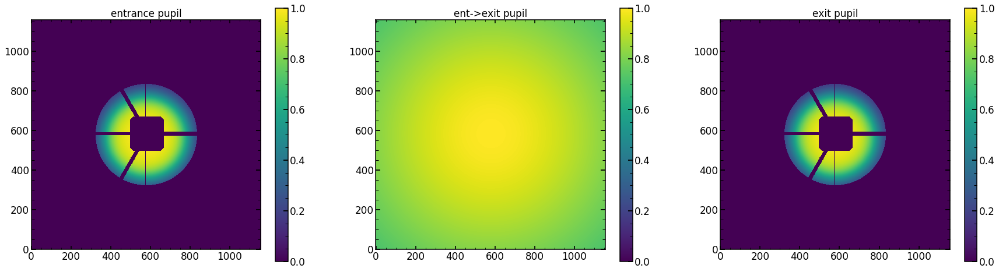

In [635]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

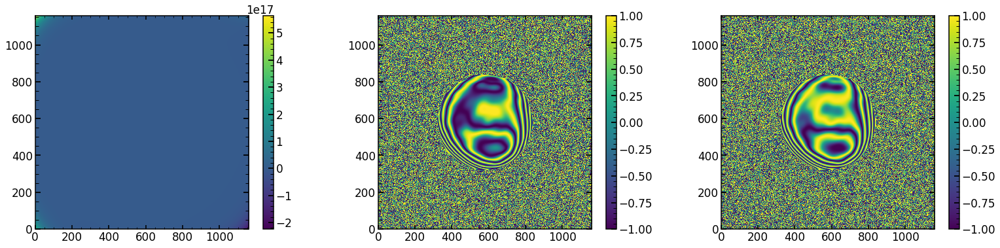

In [636]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

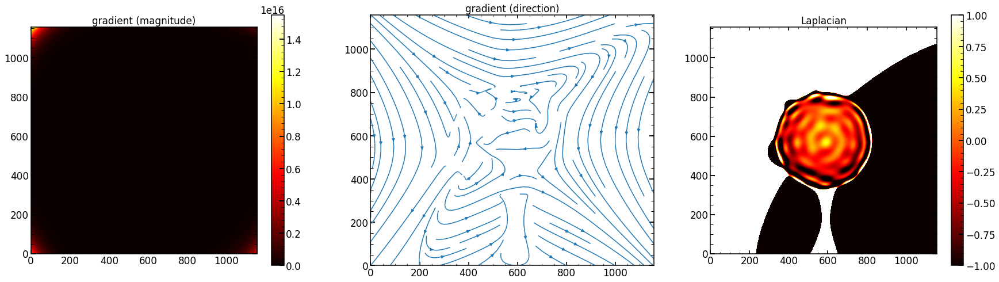

In [637]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

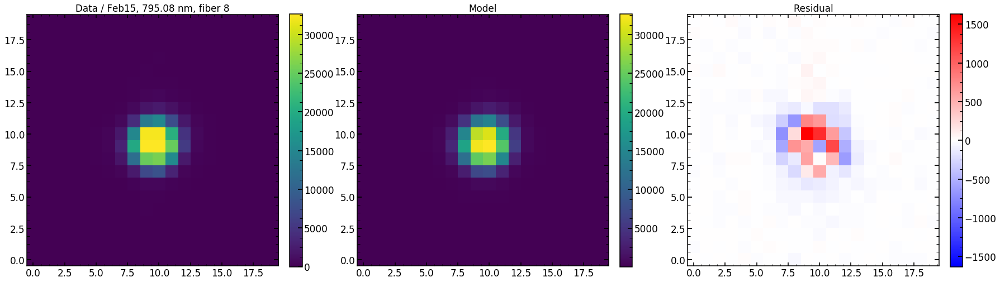

In [638]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / Feb15, 795.08 nm, fiber 8')
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.title('Residual')
plt.colorbar(fraction=0.046, pad=0.04)

chi**2 reduced is: 7.302435165691168
Abs of residual divided by total flux is: 0.05719868501659392
Abs of residual divided by largest value of a flux in the image is: 0.08449266819720481


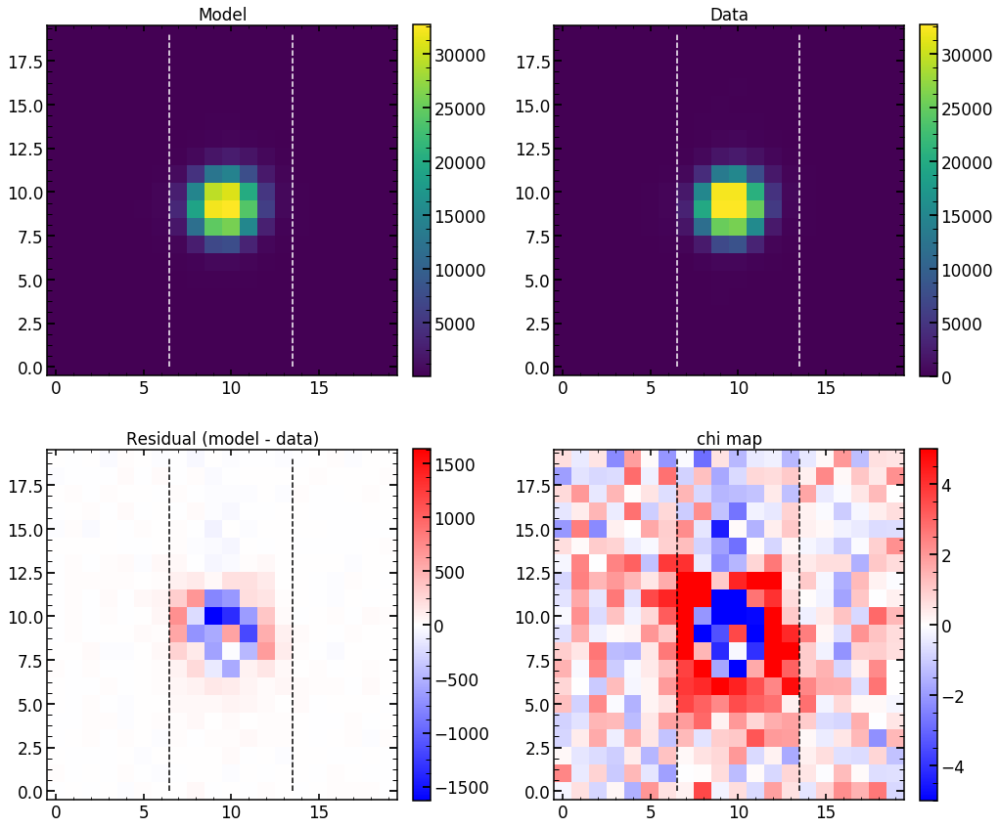

In [639]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

7.302435165691168
chi**2 reduced is: 7.302435165691168
Abs of residual divided by total flux is: 0.05719868501659392
Abs of residual divided by largest value of a flux in the image is: 0.08449266819720481


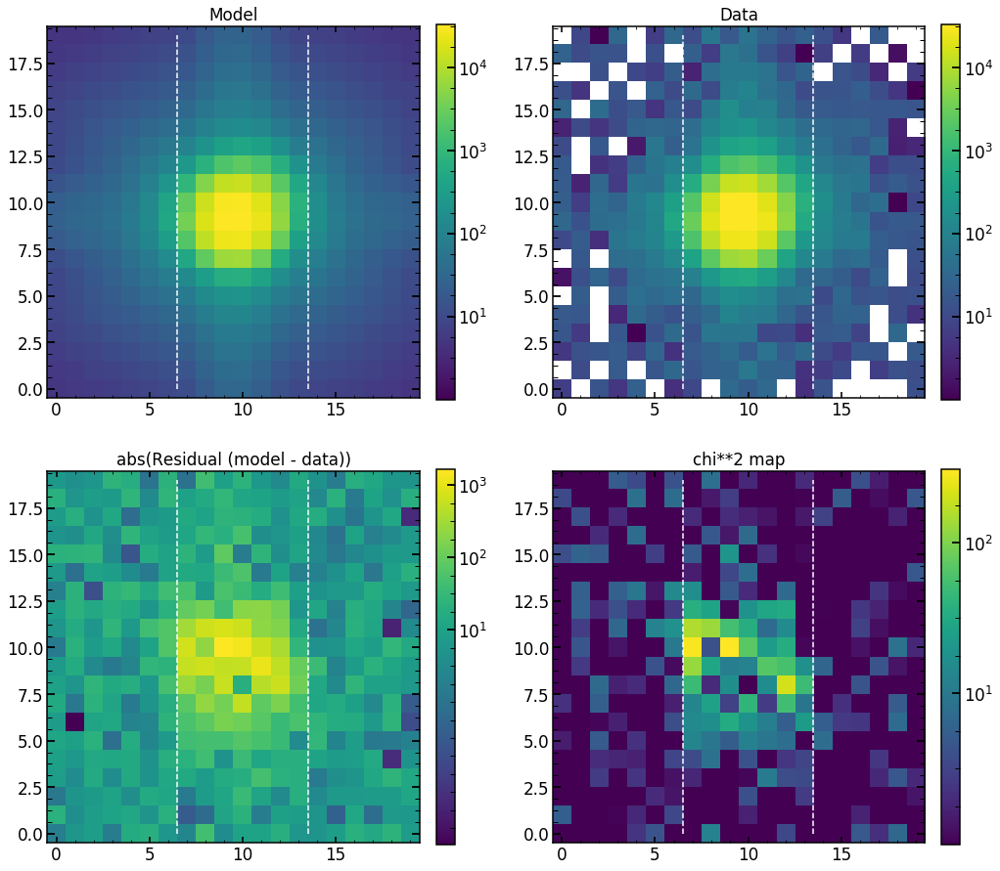

In [640]:
single_analysis.create_basic_comparison_plot_log()

7.302435165691168
chi**2 reduced is: 7.302435165691168
Abs of residual divided by total flux is: 0.05719868501659392
Abs of residual divided by largest value of a flux in the image is: 0.08449266819720481


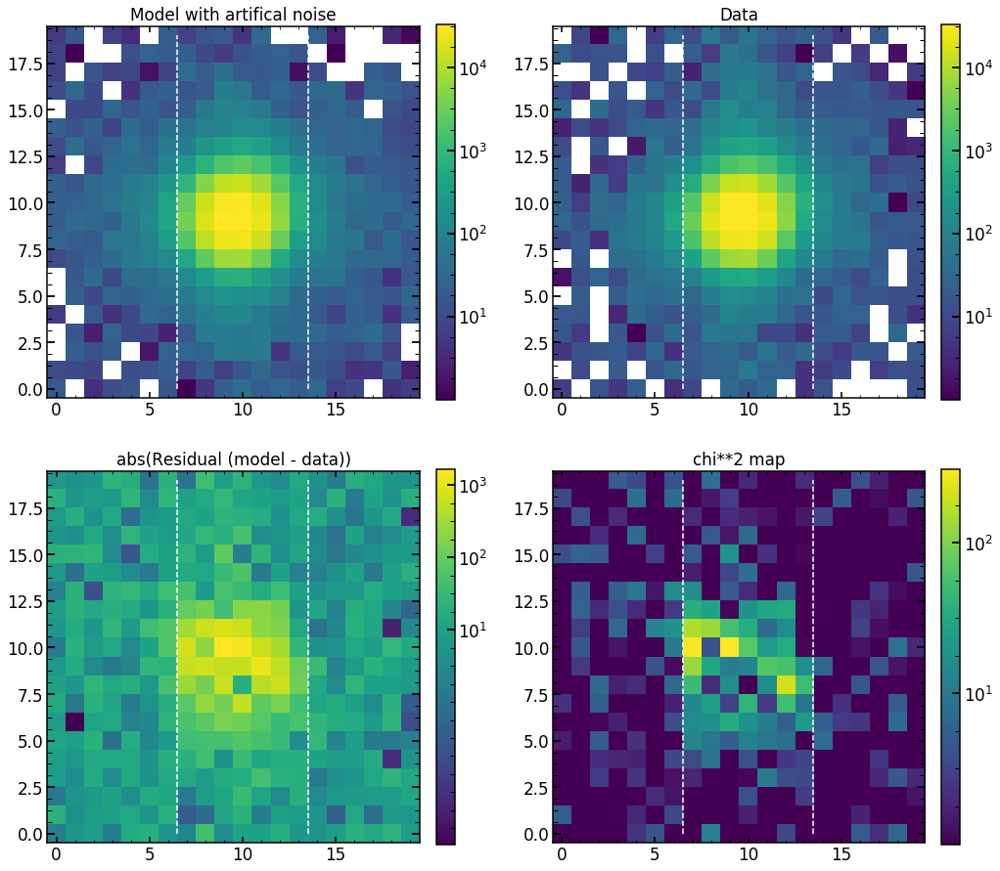

In [641]:
single_analysis.create_basic_comparison_plot_log_artifical()

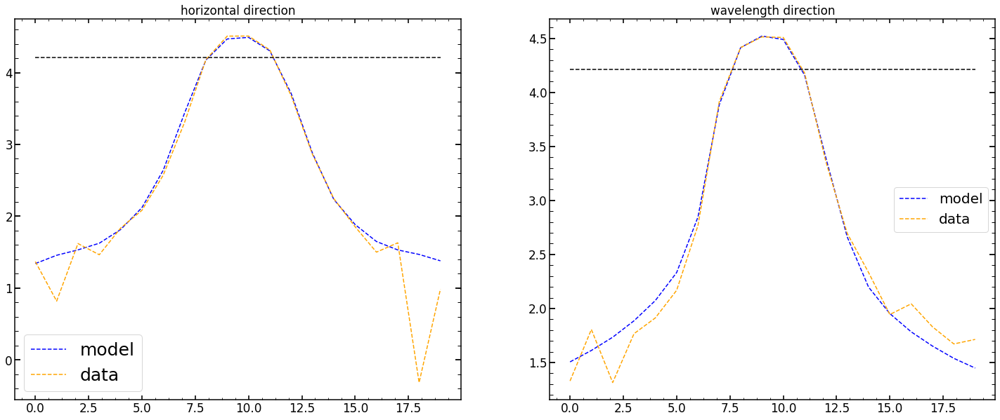

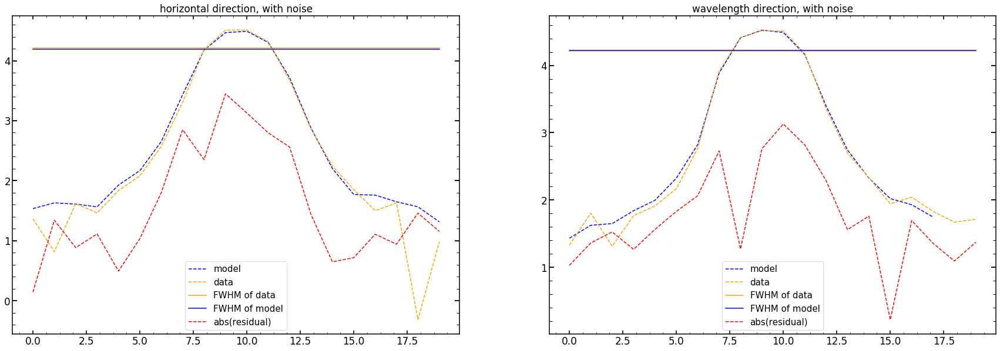

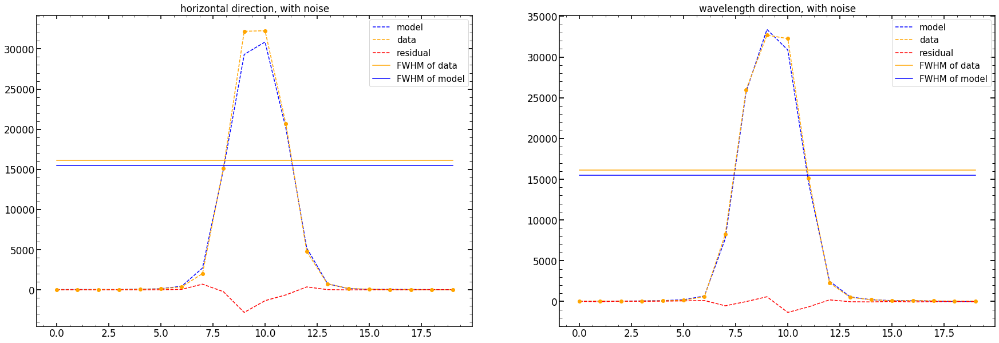

In [642]:
single_analysis.create_cut_plots()

In [647]:
#cosmohammer
import cosmoHammer

from Zernike_Module import LNP_PFS,LN_PFS_single,create_parInit,add_pupil_parameters_to_all_parameters,PFSLikelihoodModule,create_mask,create_res_data

chain = cosmoHammer.LikelihoodComputationChain()
chain.addLikelihoodModule(PFSLikelihoodModule(model))

In [732]:

class PFSLikelihoodModule_focus(object):
    """
    PFSLikelihoodModule object for calculating a likelihood for cosmoHammer.ParticleSwarmOptimizer
    """

    def __init__(self,model):
        """
        
        Constructor of the PFSLikelihoodModule
        """
        self.model=model

    def computeLikelihood(self, ctx):
        """
        Computes the likelihood using information from the context
        """
        # Get information from the context. This can be results from a core
        # module or the parameters coming from the sampler
        
        
        params = ctx.getParams()
        print(params)        
        
        #print(params)
        # Calculate a likelihood up to normalization
        lnprob = self.model(params)
        #print(str(current_process())+str(lnprob))
        #sys.stdout.flush()
        # Return the likelihood
        return lnprob

    def setup(self):
        """
        Sets up the likelihood module.
        Tasks that need to be executed once per run
        """
        #e.g. load data from files

        print("PFSLikelihoodModule setup done")

In [741]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(improved_solution_at_0)

None
zmax: 22


-1467.8097510041591

In [753]:
improved_solution_at_0

array([   -0.6930485 ,    -0.2435662 ,    -0.42058263,     0.39019694,
           0.04560375,     0.0009321 ,    -0.28103441,    -0.41745871,
          -0.00458334,     0.00044704,    -0.00015442,     0.00000687,
          -0.00176279,     0.00210806,     0.0007145 ,     0.00556391,
          -0.00019451,     0.00071254,     0.00009009,     0.66979165,
           0.07457931,     0.01202197,     0.01649825,     0.05965166,
           0.01855571,     0.10270464,     0.45932596,     0.91563827,
           1.03230622,    -0.00418714,    -0.0596994 ,     0.81774876,
           0.10465251,     0.70874995,     1.01445295,    -0.02243728,
       81530.44641561,     2.54274381,     0.00490075,     0.4197587 ,
           1.8123618 ,     0.99579095,     0.00303343,     0.00348446,
           0.00160433,     0.00176749,     0.00050919,     0.00111482,
           0.003698  ,    -0.0004507 ,     0.00687837,     0.00032366,
          -0.00412309,     0.0009032 ,    -0.00038218,     0.00128856,
      

In [746]:
def model_focus_var(allparameters_focus_proposal):
    allparameters_proposal_focus=np.copy(improved_solution_at_0)
    allparameters_proposal_focus[0]=allparameters_focus_proposal[0]
    allparameters_proposal_focus[36]=allparameters_focus_proposal[1]
    allparameters_proposal_focus[37]=allparameters_focus_proposal[2]
    allparameters_proposal_focus[38]=allparameters_focus_proposal[3]
    allparameters_proposal_focus[39]=allparameters_focus_proposal[4]
    allparameters_proposal_focus[40]=allparameters_focus_proposal[5]
    allparameters_proposal_focus[41]=allparameters_focus_proposal[6]
    return model(allparameters_proposal_focus)

In [747]:
allparameters_focus_proposal=np.array([improved_solution_at_0[0],improved_solution_at_0[36],improved_solution_at_0[37],improved_solution_at_0[38],improved_solution_at_0[39],
                             improved_solution_at_0[40],improved_solution_at_0[41]])

In [748]:
chain = cosmoHammer.LikelihoodComputationChain()
chain.addLikelihoodModule(PFSLikelihoodModule_focus(model_focus_var))

In [749]:
model_focus_var(allparameters_focus_proposal)

-1467.8097510041591

In [756]:
lower_limits=np.array(allparameters_focus_proposal)-np.array([1,20000,0.5,0.0049,0.2,0.1,0.03])
higher_limits=np.array(allparameters_focus_proposal)+np.array([1,20000,0.5,0.0049,0.2,0.1,0.03])

In [757]:
pso = cosmoHammer.ParticleSwarmOptimizer(chain, low=lower_limits, high=higher_limits,particleCount=4)

In [773]:
swarms=[]
gbests=[]
nsteps=40
num_iter = 0
for swarm in pso.sample(nsteps):
    swarms.append(swarm)
    gbests.append(pso.gbest.copy())
    num_iter += 1
    if pso.isMaster():
        if num_iter % 2 == 0:
            print("First swarm: "+str(100*num_iter/nsteps))
            sys.stdout.flush()

[   -0.33915915 90800.92842722     2.96327957     0.00843679
     0.36171488     1.86950952     1.01240194]
[   -0.16924225 94742.49681165     2.9244756      0.00826424
     0.32465118     1.83043741     1.00807824]
globalparameters[20] outside limits
[   -0.39294267 96984.02221005     2.95838089     0.00857907
     0.35410354     1.83896107     1.01120041]
[   -0.20699153 99073.67839341     2.95687616     0.00832408
     0.36067948     1.83655744     1.009205  ]
[   -0.41064242 92853.70667066     2.95877543     0.00812622
     0.35206342     1.84715526     1.0106336 ]
[    0.0117055  96784.65466696     2.94646116     0.00826793
     0.36316357     1.83158027     1.00557381]
[   -0.39321992 96912.72770445     2.95851437     0.00857013
     0.35224819     1.83813739     1.0111826 ]
[    -0.21670654 100161.13639137      2.92332424      0.00823383
      0.35475983      1.83748445      1.00906647]
[   -0.47516503 97894.34946067     2.95443084     0.00814219
     0.34751682     1.82376248  

[   -0.51409827 97839.52136336     2.91694143     0.00893563
     0.36287835     1.83681405     1.00294504]
[    -0.58108304 100193.99766326      2.91672512      0.00894911
      0.35920889      1.83513902      1.00370617]
[   -0.50527746 99015.01348175     2.91941041     0.00894157
     0.36117588     1.83671803     1.00295648]
[   -0.48882764 98446.77335331     2.91758901     0.00889026
     0.36289886     1.83746219     1.00323764]
[   -0.50689336 98165.1651521      2.91817409     0.00901956
     0.36180633     1.83745013     1.00269065]
First swarm: 45.0
[    -0.53382157 100174.06767371      2.91736909      0.00895573
      0.35734935      1.84205173      1.00236133]
[   -0.50418809 99086.91086328     2.91996579     0.00894885
     0.36104635     1.83704773     1.00367152]
[   -0.47743135 98627.17102172     2.9154324      0.0088955
     0.36290456     1.83626557     1.00283858]
[   -0.50074429 99539.97748481     2.92146325     0.0090485
     0.36062923     1.83757818     1.00275032

[   -0.44231851 98898.1199165      2.90685023     0.00869304
     0.36241418     1.83023123     0.99490982]
[   -0.4464363  98921.65159514     2.9070686      0.00869541
     0.36169927     1.83033286     0.99446951]
[   -0.45929307 99520.95254414     2.90643173     0.00866425
     0.36274296     1.8303432      0.99730003]
First swarm: 90.0
[   -0.42497872 98713.26322201     2.90708355     0.00871973
     0.36182104     1.83032608     0.99558217]
[   -0.44301121 98968.86462361     2.90782904     0.00871392
     0.36153218     1.83042849     0.994623  ]
[   -0.44079051 99000.25795902     2.90759761     0.00869592
     0.36063507     1.83030083     0.99370063]
[   -0.44625416 99875.19852529     2.90764147     0.00869128
     0.36142482     1.83012215     0.99556445]
[   -0.44101069 98909.72666085     2.90723759     0.00870912
     0.3614437      1.83007588     0.99529133]
[   -0.4464193  99035.66481028     2.90814727     0.00871315
     0.36077591     1.83056659     0.99427843]
[   -0.437

In [774]:
minchain=gbests[-1].position
minln=gbests[-1].fitness
minln

-646.7922431862523

In [775]:
    allparameters_focus_proposal=minchain
    allparameters_proposal_focus=np.copy(improved_solution_at_0)
    allparameters_proposal_focus[0]=allparameters_focus_proposal[0]
    allparameters_proposal_focus[36]=allparameters_focus_proposal[1]
    allparameters_proposal_focus[37]=allparameters_focus_proposal[2]
    allparameters_proposal_focus[38]=allparameters_focus_proposal[3]
    allparameters_proposal_focus[39]=allparameters_focus_proposal[4]
    allparameters_proposal_focus[40]=allparameters_focus_proposal[5]
    allparameters_proposal_focus[41]=allparameters_focus_proposal[6]

In [776]:
allparameters_proposal_focus

array([   -0.44831887,    -0.2435662 ,    -0.42058263,     0.39019694,
           0.04560375,     0.0009321 ,    -0.28103441,    -0.41745871,
          -0.00458334,     0.00044704,    -0.00015442,     0.00000687,
          -0.00176279,     0.00210806,     0.0007145 ,     0.00556391,
          -0.00019451,     0.00071254,     0.00009009,     0.66979165,
           0.07457931,     0.01202197,     0.01649825,     0.05965166,
           0.01855571,     0.10270464,     0.45932596,     0.91563827,
           1.03230622,    -0.00418714,    -0.0596994 ,     0.81774876,
           0.10465251,     0.70874995,     1.01445295,    -0.02243728,
       99076.36061479,     2.90836844,     0.0087124 ,     0.36014341,
           1.83066827,     0.99393711,     0.00303343,     0.00348446,
           0.00160433,     0.00176749,     0.00050919,     0.00111482,
           0.003698  ,    -0.0004507 ,     0.00687837,     0.00032366,
          -0.00412309,     0.0009032 ,    -0.00038218,     0.00128856,
      

In [777]:
minchain

array([   -0.44831887, 99076.36061479,     2.90836844,     0.0087124 ,
           0.36014341,     1.83066827,     0.99393711])

In [778]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(allparameters_proposal_focus)

None
zmax: 22


-646.7922431862523

In [779]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

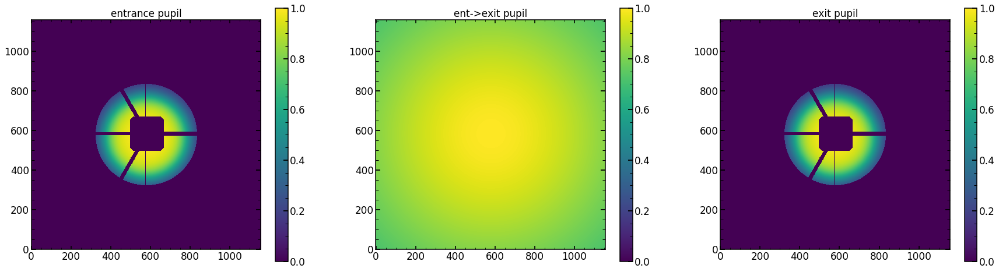

In [780]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

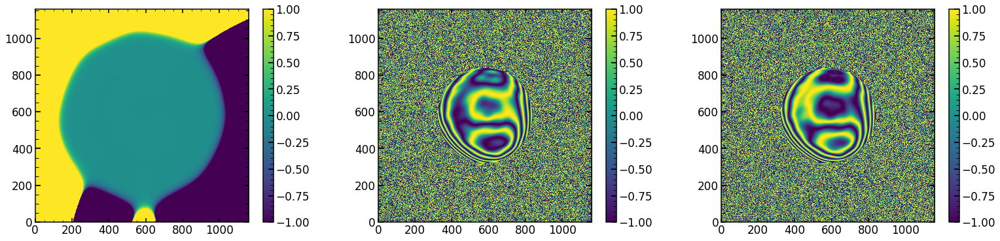

In [792]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full/np.median(np.abs(wf_full)),vmax=1,vmin=-1)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

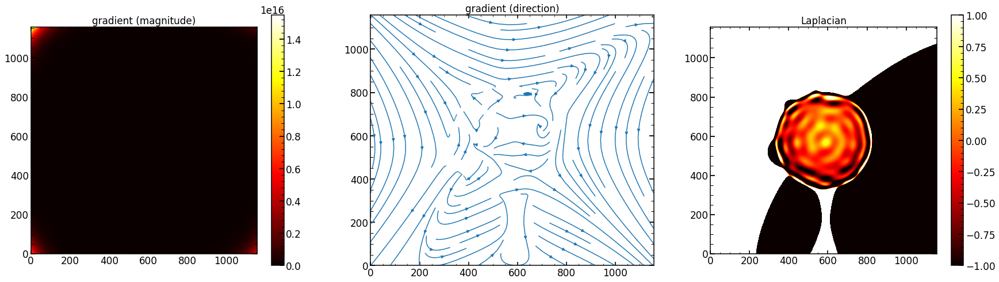

In [782]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

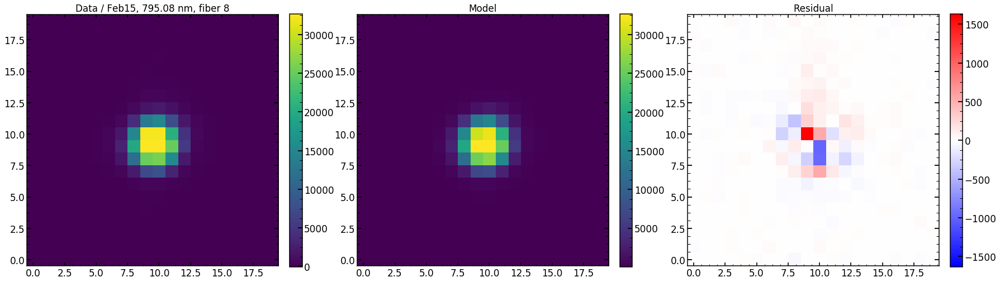

In [783]:
plt.figure(figsize=(30,10))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / Feb15, 795.08 nm, fiber 8')
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.title('Residual')
plt.colorbar(fraction=0.046, pad=0.04)

chi**2 reduced is: 3.197347684883052
Abs of residual divided by total flux is: 0.03581603615139529
Abs of residual divided by largest value of a flux in the image is: 0.0551829827605332


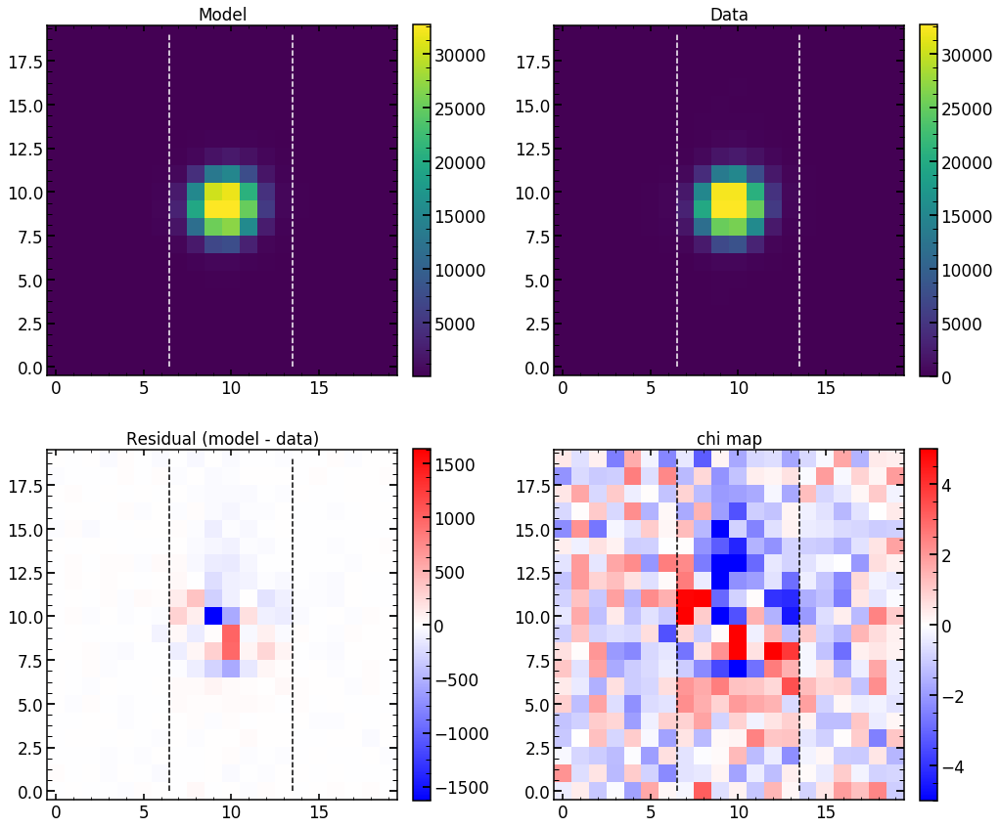

In [784]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

3.197347684883052
chi**2 reduced is: 3.197347684883052
Abs of residual divided by total flux is: 0.03581603615139529
Abs of residual divided by largest value of a flux in the image is: 0.0551829827605332


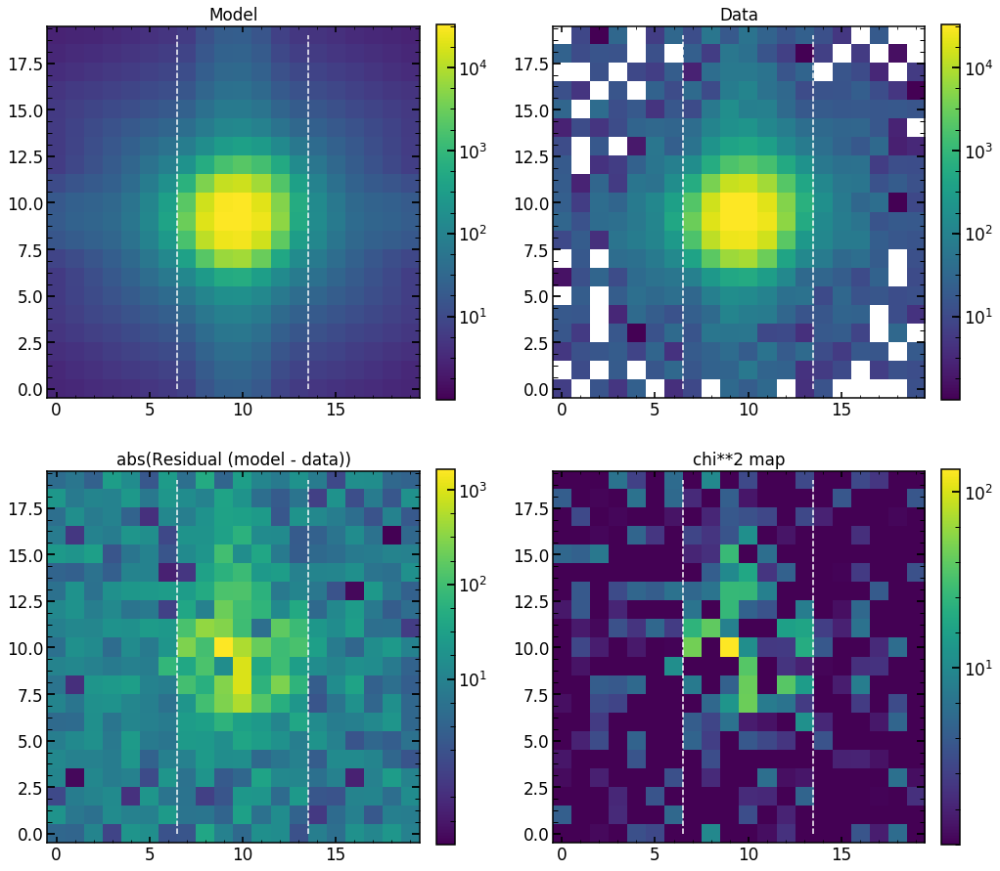

In [785]:
single_analysis.create_basic_comparison_plot_log()

3.197347684883052
chi**2 reduced is: 3.197347684883052
Abs of residual divided by total flux is: 0.03581603615139529
Abs of residual divided by largest value of a flux in the image is: 0.0551829827605332


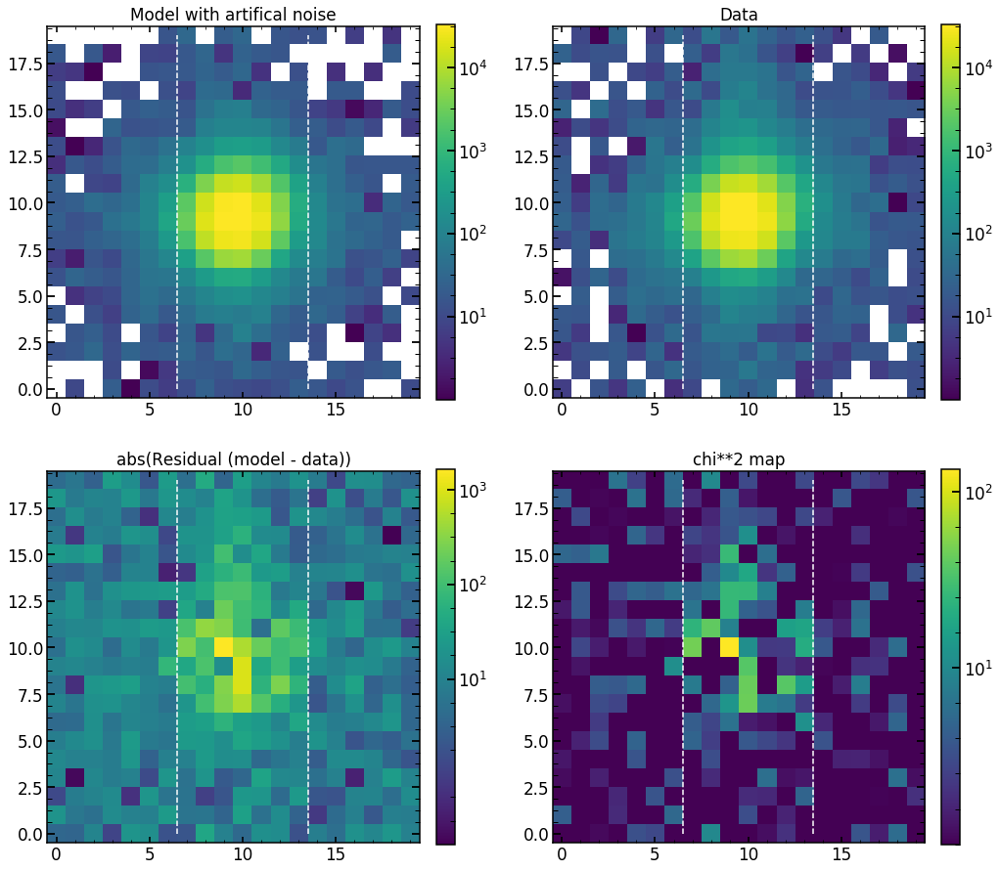

In [786]:
single_analysis.create_basic_comparison_plot_log_artifical()

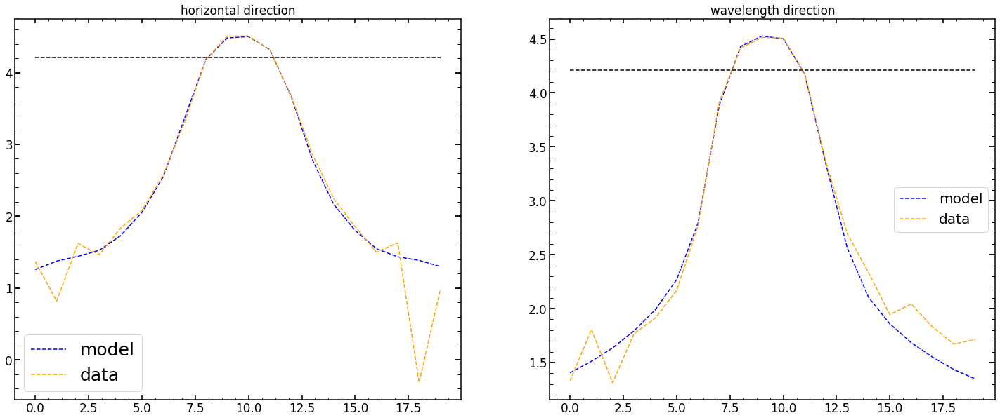

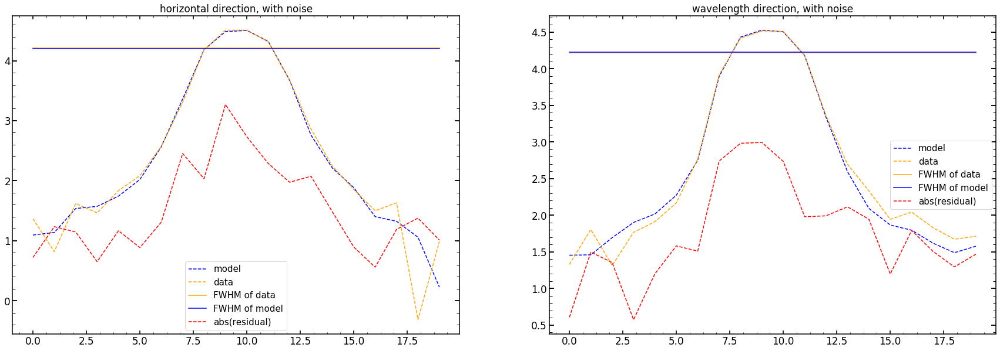

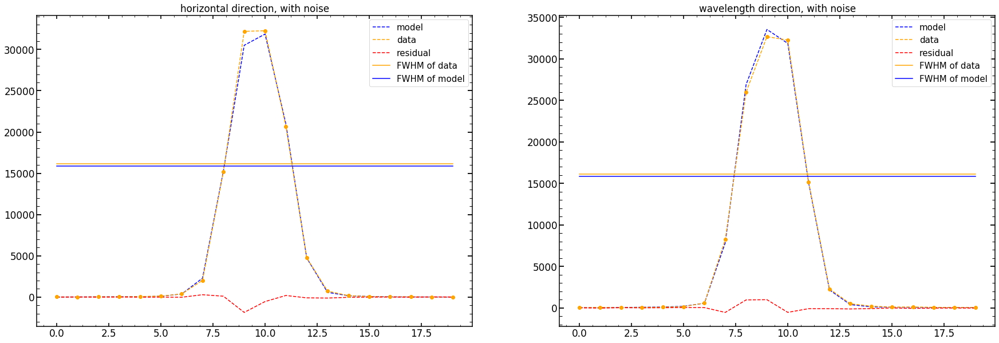

In [787]:
single_analysis.create_cut_plots()

## comparison many and up to z22

In [831]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   

allparameters_proposal_focus_test=np.copy(allparameters_proposal_focus)

None
zmax: 22


In [832]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   


model(allparameters_proposal_focus_test)

optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_many=np.copy(optPsf_cut_fiber_convolved_downsampled)
print(res_iapetus_many[0][0])

None
zmax: 22
3.051652963334891


In [833]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   

model(allparameters_proposal_focus[:42])

optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_42=np.copy(optPsf_cut_fiber_convolved_downsampled)
print(res_iapetus_42[0][0])

None
zmax: 22
3.047441108216116


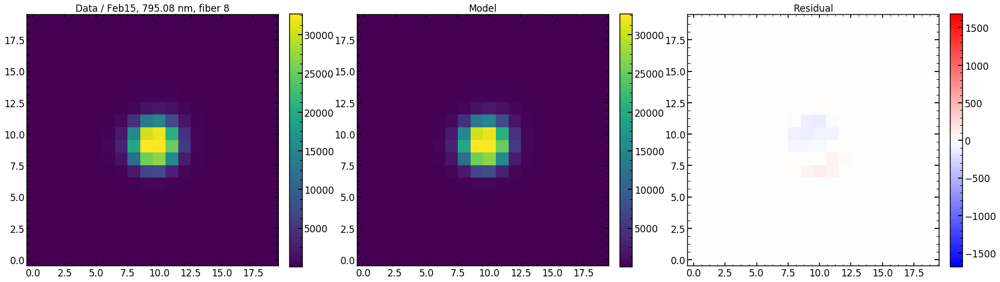

In [834]:
plt.figure(figsize=(30,10))

plt.subplot(1,3,1)

plt.imshow(res_iapetus_42,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / Feb15, 795.08 nm, fiber 8')
plt.subplot(1,3,2)
plt.imshow(res_iapetus_many,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus_many-res_iapetus_42,vmin=-np.max(res_iapetus_many)/20,vmax=np.max(res_iapetus_many)/20,cmap='bwr')
plt.title('Residual')
plt.colorbar(fraction=0.046, pad=0.04)

In [836]:
np.mean((res_iapetus_many-res_iapetus_42)**2/var_image)

0.043009275256568405

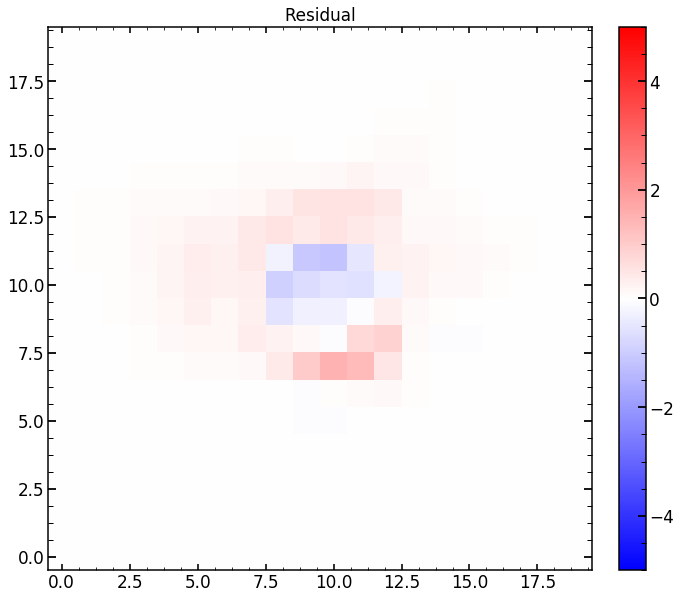

In [838]:
plt.imshow((res_iapetus_many-res_iapetus_42)/np.sqrt(var_image),vmin=-5,vmax=5,cmap='bwr')
plt.title('Residual')
plt.colorbar(fraction=0.046, pad=0.04)

In [876]:
finalHgAr_Feb2019[finalHgAr_Feb2019.fiber=='8']

,fiber,xc,yc,wavelength,close,lamp,xc_effective,old_index_approx,superold_index_approx
96,8,2137,762,690.9346,0,HgAr,2206,60,nan
97,8,2136,828,696.7261,1,HgAr,2205,61,95.0
98,8,2136,944,706.8989,0,HgAr,2205,62,nan
99,8,2135,1179,727.47876,1,HgAr,2204,63,nan
100,8,2135,1307,738.6248,0,HgAr,2204,64,85.0
101,8,2134,1595,763.74286,0.5,HgAr,2203,65,75.0
102,8,2133,1955,795.0522,1,HgAr,2202,66,55.0
103,8,2131,2322,826.6699,0.5,HgAr,2200,67,45.0
104,8,2131,2621,852.4029,0.5,HgAr,2200,68,35.0
105,8,2128,3328,912.5693,1,HgAr,2197,69,25.0


In [877]:
finalNe_Feb2019[finalNe_Feb2019.fiber=='8']

,fiber,xc,yc,wavelength,close,lamp,xc_effective,old_index_approx,superold_index_approx
72,8,2123,315,650.84186,0,Ne,2192,45,nan
73,8,2123,345,653.4774,0,Ne,2192,46,nan
74,8,2123,420,660.0668,1,Ne,2192,47,nan
75,8,2122,511,668.01764,0,Ne,2191,48,nan
76,8,2122,555,671.9268,0,Ne,2191,49,nan
77,8,2122,797,693.13116,1,Ne,2191,50,nan
78,8,2122,1076,717.59015,1,Ne,2191,51,nan
79,8,2122,1157,724.72437,1,Ne,2191,52,nan
80,8,2122,1379,744.1276,0,Ne,2191,53,nan


# Zemax

## Zemax with detector

In [1349]:
for i in range(11):
    print(int(4096/2+i*(4096/2)/10))

2048
2252
2457
2662
2867
3072
3276
3481
3686
3891
4096


In [1358]:
for i in range(11):
    print(int(0/2+i*(4096/2)/10))

0
204
409
614
819
1024
1228
1433
1638
1843
2048


In [1376]:
field_position[20-1]

204

In [1377]:
wave_position=[100,425,840,1230,1650,2020,2400,2740,3200,3600,4000]
field_position=[2048,2252,2457,2662,2867,3072,3276,3481,3686,3891,4096,0,1843,1638,1433,1228,1024,819,614,409,204]

postion_res=[]
WaveField_res=[]
for wave in [1,2,3,4,5,6,7,8,9,10,11]:
    for field in [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21]:
        f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/March282019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
        lines=f.read()
        # Reading of file
        #WaveField = np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter=b'\t')
        WaveField = np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
        WaveField_res.append(WaveField)
        postion_res.append([wave_position[wave-1],field_position[field-1]])
        

In [1378]:
Zemax_number=4
single_Zernike_res_z4=[]
single_Zernike_res_z5=[]
single_Zernike_res_z6=[]
single_Zernike_res_z7=[]
single_Zernike_res_z8=[]
single_Zernike_res_z9=[]
single_Zernike_res_z10=[]
single_Zernike_res_z11=[]
single_Zernike_res_z12=[]
single_Zernike_res_z13=[]
single_Zernike_res_z14=[]
single_Zernike_res_z15=[]
single_Zernike_res_z16=[]
single_Zernike_res_z17=[]
single_Zernike_res_z18=[]
single_Zernike_res_z19=[]
single_Zernike_res_z20=[]
single_Zernike_res_z21=[]
single_Zernike_res_z22=[]






position_Zernike_res=[]
for i in range(len(WaveField_res)):
    single_Zernike_res_z4.append(WaveField_res[i][4-1])
    position_Zernike_res.append(postion_res[i])
 
for i in range(len(WaveField_res)):
    single_Zernike_res_z5.append(WaveField_res[i][5-1])
    position_Zernike_res.append(postion_res[i])
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z6.append(WaveField_res[i][6-1])
    position_Zernike_res.append(postion_res[i])
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z7.append(WaveField_res[i][7-1])
    position_Zernike_res.append(postion_res[i])
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z8.append(WaveField_res[i][8-1])
    position_Zernike_res.append(postion_res[i])
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z9.append(WaveField_res[i][9-1])
    position_Zernike_res.append(postion_res[i])
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z10.append(WaveField_res[i][10-1])
    position_Zernike_res.append(postion_res[i])
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z11.append(WaveField_res[i][11-1])
    position_Zernike_res.append(postion_res[i])

for i in range(len(WaveField_res)):
    single_Zernike_res_z12.append(WaveField_res[i][12-1])
    position_Zernike_res.append(postion_res[i])   

for i in range(len(WaveField_res)):
    single_Zernike_res_z13.append(WaveField_res[i][13-1])
    position_Zernike_res.append(postion_res[i])   
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z14.append(WaveField_res[i][14-1])
    position_Zernike_res.append(postion_res[i])   
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z15.append(WaveField_res[i][15-1])
    position_Zernike_res.append(postion_res[i])   
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z16.append(WaveField_res[i][16-1])
    position_Zernike_res.append(postion_res[i])   
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z17.append(WaveField_res[i][17-1])
    position_Zernike_res.append(postion_res[i])   
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z18.append(WaveField_res[i][18-1])
    position_Zernike_res.append(postion_res[i])   
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z19.append(WaveField_res[i][19-1])
    position_Zernike_res.append(postion_res[i])   
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z20.append(WaveField_res[i][20-1])
    position_Zernike_res.append(postion_res[i])   
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z21.append(WaveField_res[i][21-1])
    position_Zernike_res.append(postion_res[i])   
    
position_Zernike_res=[]   
for i in range(len(WaveField_res)):
    single_Zernike_res_z22.append(WaveField_res[i][22-1])
    position_Zernike_res.append(postion_res[i])   
       
    
position_Zernike_res=np.array(position_Zernike_res)

In [1379]:
x=np.array(position_Zernike_res[:,1])
y=np.array(position_Zernike_res[:,0])
colors=np.array(single_Zernike_res_z4)

median_color=np.median(colors)
up_limit=np.abs(max(colors)-median_color)
low_limit=np.abs(min(colors)-median_color)
max_dif=np.max([low_limit,up_limit])
min_dif=np.min([low_limit,up_limit])
max_colors=median_color+(min_dif+max_dif)/2
min_colors=median_color-(min_dif+max_dif)/2

area=250

In [1380]:
colors

array([ 0.08535999,  0.13893885,  0.17781079,  0.32997983,  0.46544156,
        0.58136339,  0.45578316,  0.30293818,  0.07638705, -0.12030584,
       -0.19089892, -0.42774938,  0.05953572, -0.01486265, -0.16250744,
       -0.27148601, -0.46523905, -0.42672172, -0.48588814, -0.42193314,
       -0.35203746,  0.01128784,  0.02186603,  0.02878677,  0.10674358,
        0.21272853,  0.39329342,  0.36791981,  0.23568943,  0.08210277,
       -0.11853247, -0.19271953, -0.24475705,  0.00421235, -0.00254668,
       -0.06208914, -0.15834263, -0.41620401, -0.45750034, -0.56549252,
       -0.46255385, -0.24859116, -0.12742631, -0.15143495, -0.23479447,
       -0.30788954, -0.2595684 , -0.13407346, -0.07884968, -0.11198646,
       -0.19674557, -0.32470056, -0.36868496, -0.18066557, -0.06419608,
        0.02718956,  0.13157861,  0.05938523, -0.1324352 , -0.26485559,
       -0.43593304, -0.49534815, -0.29533598, -0.22763221, -0.26864782,
       -0.4209498 , -0.58454991, -0.58982743, -0.53629617, -0.44

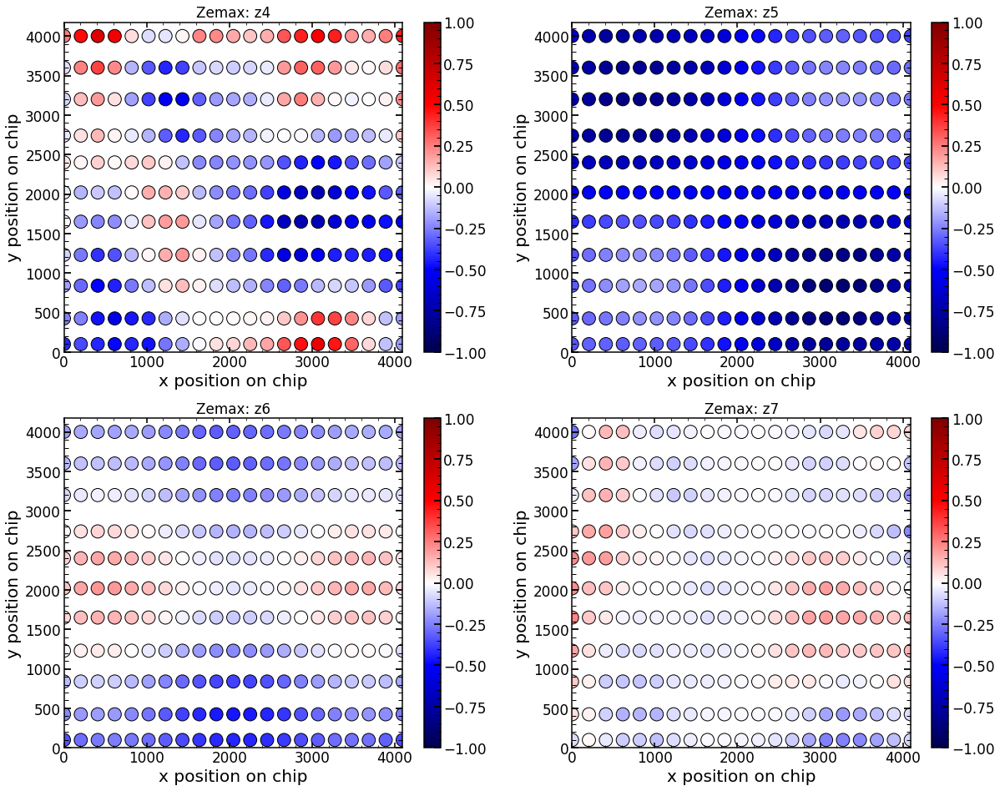

In [1381]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(4))
plt.colorbar()

plt.subplot(2,2,2)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z5), cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(5))
plt.colorbar()

plt.subplot(2,2,3)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z6), cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(6))
plt.colorbar()

plt.subplot(2,2,4)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z7), cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(7))
plt.colorbar()

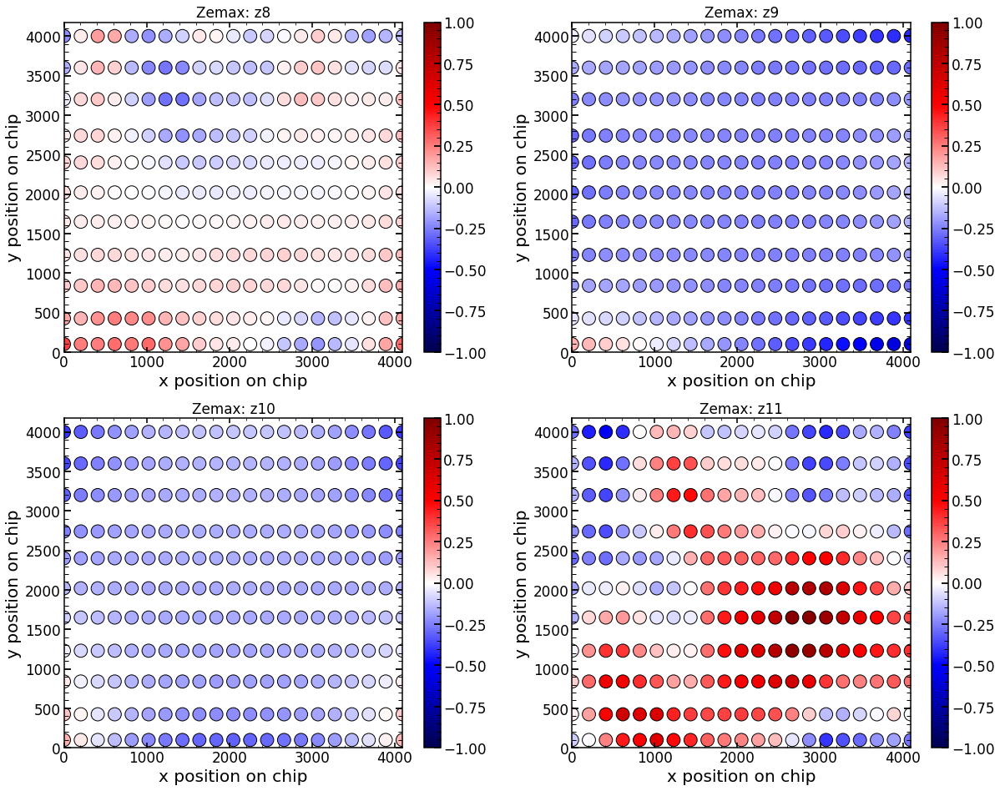

In [1382]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z8), cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(8))
plt.colorbar()

plt.subplot(2,2,2)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z9), cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(9))
plt.colorbar()

plt.subplot(2,2,3)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z10), cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(10))
plt.colorbar()

plt.subplot(2,2,4)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z11), cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(11))
plt.colorbar()

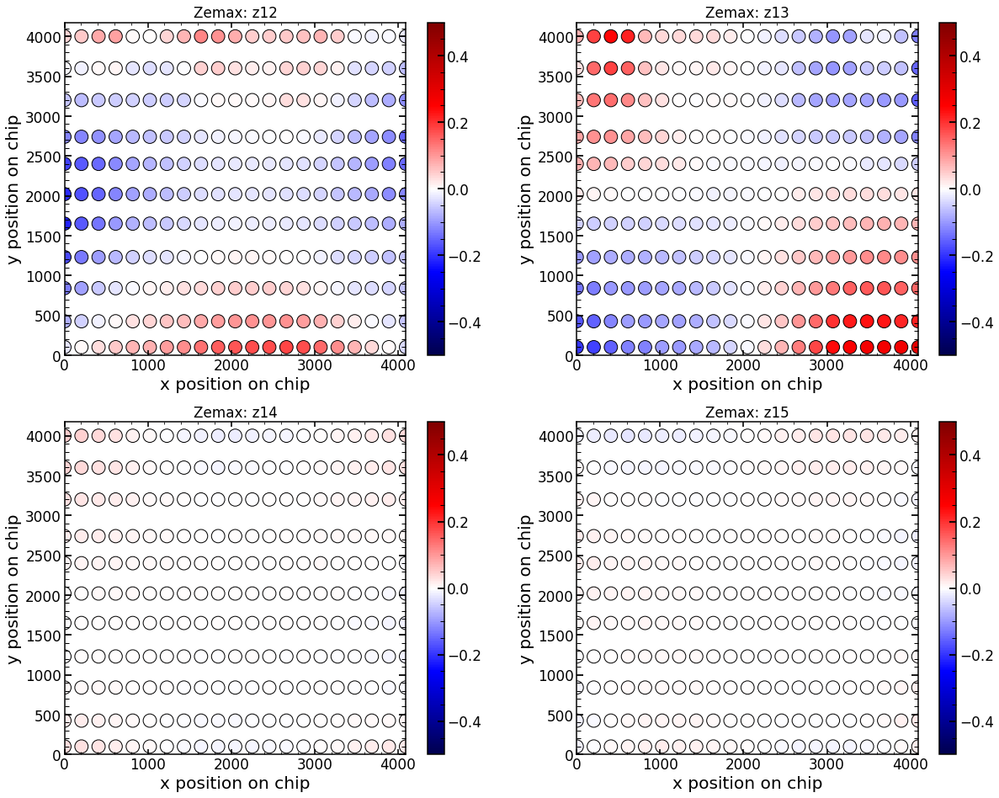

In [1383]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z12), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(12))
plt.colorbar()

plt.subplot(2,2,2)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z13), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(13))
plt.colorbar()

plt.subplot(2,2,3)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z14), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(14))
plt.colorbar()

plt.subplot(2,2,4)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z15), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(15))
plt.colorbar()

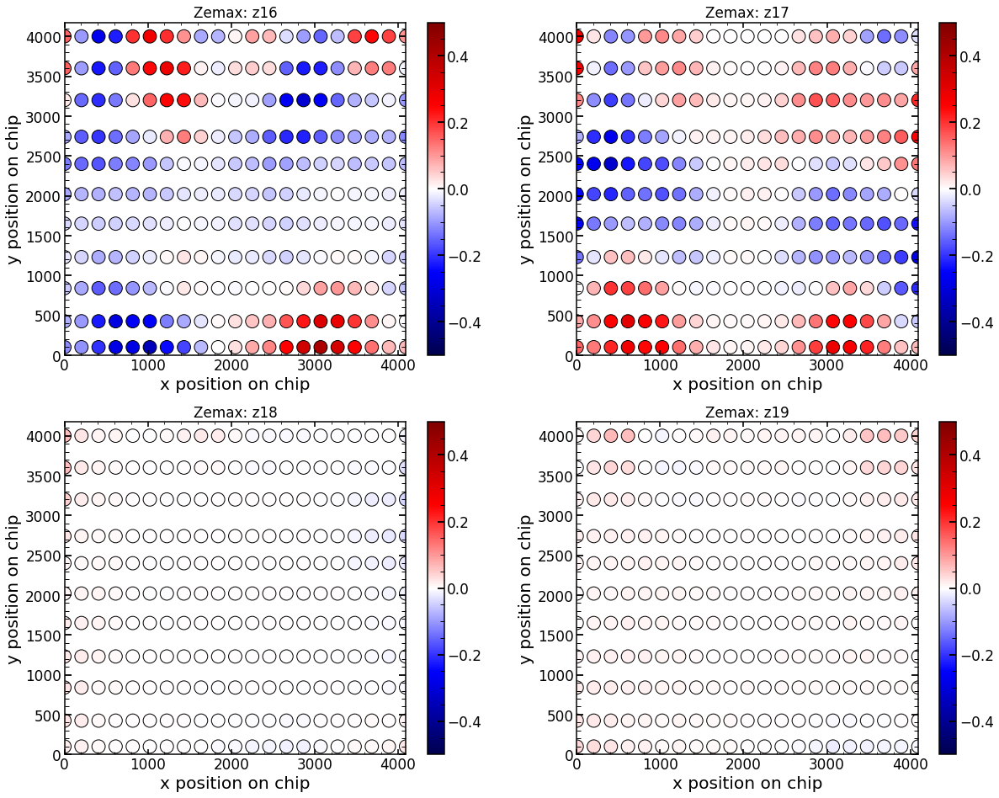

In [1384]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z16), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(16))
plt.colorbar()

plt.subplot(2,2,2)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z17), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(17))
plt.colorbar()

plt.subplot(2,2,3)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z18), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(18))
plt.colorbar()

plt.subplot(2,2,4)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z19), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(19))
plt.colorbar()

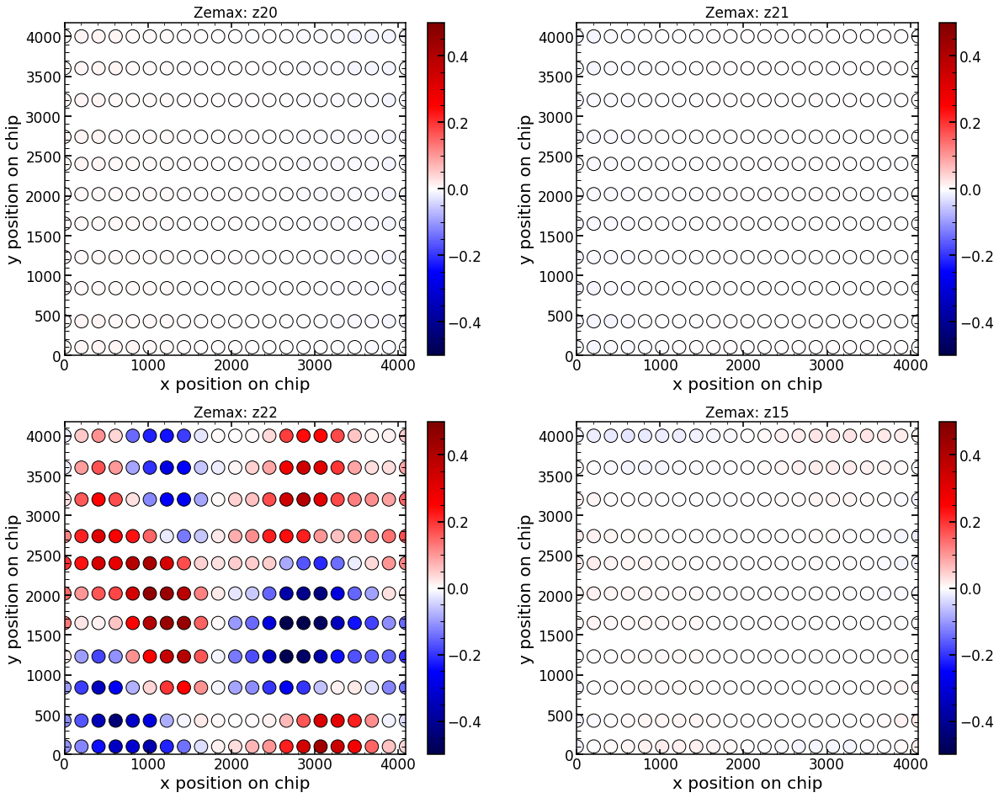

In [1385]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z20), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(20))
plt.colorbar()

plt.subplot(2,2,2)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z21), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(21))
plt.colorbar()

plt.subplot(2,2,3)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z22), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(22))
plt.colorbar()

plt.subplot(2,2,4)
plt.scatter(x, y, s=area, c=np.array(single_Zernike_res_z15), cmap='seismic', alpha=1,vmin=-0.5, vmax=0.5,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(15))
plt.colorbar()

## Zemax without detector

In [1418]:
from astropy.io import fits
detectorMapOriginal=fits.open('/Users/nevencaplar/Documents/PFS/DetectorMap/detectorMap-sim-1-r.fits')

hdu = detectorMapOriginal["FIBERID"]
fiberIds = hdu.data
fiberIds = fiberIds.astype(np.int32) 
fiberIds.shape

list_of_illuminated_slit_fibers_in_January_24_data=[32,63,111,192,223,255,289,308,342,401,418,464,518,525,587,620]

list_of_illuminated_science_fibers_in_January_24_data=[]
for i in list_of_illuminated_slit_fibers_in_January_24_data:
    list_of_illuminated_science_fibers_in_January_24_data.append(np.where(fiberIds==i)[0][0])
    
list_of_illuminated_science_fibers_in_January_24_data


detectorMapOriginal_for_illuminated_fiber_Jan_24_2019_as_list_x=[]
detectorMapOriginal_for_illuminated_fiber_Jan_24_2019_as_list_y=[]
for j in list_of_illuminated_science_fibers_in_January_24_data:
    print(j)
    detectorMapOriginal_single_fiber_x=detectorMapOriginal[3].data[detectorMapOriginal[3].data['index']==j]    
    detectorMapOriginal_single_fiber_y=detectorMapOriginal[4].data[detectorMapOriginal[4].data['index']==j]
    
    detectorMapOriginal_single_fiber_as_list_x=[]
    detectorMapOriginal_single_fiber_as_list_y=[]
    # because I do not know how to work with numpy.record
    for i in range(len(detectorMapOriginal_single_fiber_y)):
        detectorMapOriginal_single_fiber_as_list_x.append(list(detectorMapOriginal_single_fiber_x[i]))
        detectorMapOriginal_single_fiber_as_list_y.append(list(detectorMapOriginal_single_fiber_y[i]))
        
    detectorMapOriginal_single_fiber_as_array_x=np.array(detectorMapOriginal_single_fiber_as_list_x)
    detectorMapOriginal_single_fiber_as_array_y=np.array(detectorMapOriginal_single_fiber_as_list_y)
    detectorMapOriginal_for_illuminated_fiber_Jan_24_2019_as_list_x.append(detectorMapOriginal_single_fiber_as_array_x)
    detectorMapOriginal_for_illuminated_fiber_Jan_24_2019_as_list_y.append(detectorMapOriginal_single_fiber_as_array_y)

30
59
104
180
211
241
273
292
305
362
379
423
472
479
538
569


In [1506]:


np.array(detectorMapOriginal[4].data[detectorMapOriginal[3].data['index']==578])['value']

array([620.6146 , 620.69995, 620.78534, ..., 976.8246 , 976.91   ,
       976.9953 ], dtype=float32)

In [1579]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]


list_of_dy_values_in_fibers=[]
for fibers in [303,271,239,209,176,146,116,84,52,22,5,595,328,359,390,423,453,484,514,547,578]:
    list_of_values=[]
    for wavelengths in [630,664,698,732,766,800,834,868,902,936,970]:
        nearest_value=find_nearest(np.array(detectorMapOriginal[4].data[detectorMapOriginal[3].data['index']==fibers])['value'],wavelengths)
        index_of_value=list(np.array(detectorMapOriginal[4].data[detectorMapOriginal[3].data['index']==fibers])['value']).index(nearest_value)
        list_of_values.append(index_of_value)
    list_of_dy_values_in_fibers.append(list_of_values)

In [1580]:
np.array(list_of_dy_values_in_fibers)

array([[  82,  478,  873, 1269, 1664, 2060, 2455, 2851, 3246, 3642, 4037],
       [  83,  478,  874, 1269, 1665, 2060, 2456, 2851, 3247, 3643, 4038],
       [  84,  480,  875, 1271, 1667, 2062, 2458, 2853, 3249, 3645, 4040],
       [  86,  482,  877, 1273, 1669, 2065, 2460, 2856, 3252, 3648, 4044],
       [  88,  484,  880, 1276, 1672, 2068, 2464, 2860, 3256, 3652, 4048],
       [  91,  488,  884, 1280, 1677, 2073, 2469, 2866, 3262, 3658, 4054],
       [  95,  492,  888, 1285, 1682, 2078, 2475, 2872, 3268, 3665, 4062],
       [ 100,  497,  894, 1291, 1688, 2085, 2483, 2880, 3277, 3674, 4071],
       [ 105,  502,  900, 1298, 1695, 2093, 2490, 2888, 3286, 3683, 4081],
       [ 110,  508,  906, 1305, 1703, 2101, 2499, 2898, 3296, 3694, 4093],
       [ 113,  511,  910, 1309, 1707, 2106, 2505, 2903, 3302, 3701, 4099],
       [ 113,  512,  910, 1309, 1708, 2106, 2505, 2904, 3302, 3701, 4100],
       [  83,  478,  874, 1269, 1665, 2060, 2456, 2851, 3247, 3643, 4038],
       [  84,  480,  875,

In [1581]:
list_of_dy_values_in_fibers=np.transpose(np.array(list_of_dy_values_in_fibers)).ravel()
list_of_dy_values_in_fibers

array([  82,   83,   84,   86,   88,   91,   95,  100,  105,  110,  113,
        113,   83,   84,   86,   88,   91,   95,  100,  105,  110,  478,
        478,  480,  482,  484,  488,  492,  497,  502,  508,  511,  512,
        478,  480,  482,  484,  488,  492,  497,  502,  508,  873,  874,
        875,  877,  880,  884,  888,  894,  900,  906,  910,  910,  874,
        875,  877,  880,  884,  889,  894,  900,  907, 1269, 1269, 1271,
       1273, 1276, 1280, 1285, 1291, 1298, 1305, 1309, 1309, 1269, 1271,
       1273, 1276, 1280, 1285, 1291, 1298, 1305, 1664, 1665, 1667, 1669,
       1672, 1677, 1682, 1688, 1695, 1703, 1707, 1708, 1665, 1666, 1669,
       1672, 1677, 1682, 1688, 1695, 1703, 2060, 2060, 2062, 2065, 2068,
       2073, 2078, 2085, 2093, 2101, 2106, 2106, 2060, 2062, 2065, 2068,
       2073, 2079, 2085, 2093, 2101, 2455, 2456, 2458, 2460, 2464, 2469,
       2475, 2483, 2490, 2499, 2505, 2505, 2456, 2458, 2460, 2464, 2469,
       2475, 2482, 2490, 2500, 2851, 2851, 2853, 28

In [1582]:
wave_position=[100,425,840,1230,1650,2020,2400,2740,3200,3600,4000]
field_position=[2048,2252,2457,2662,2867,3072,3276,3481,3686,3891,4096,0,1843,1638,1433,1228,1024,819,614,409,204]

postion_res=[]
WaveField_res=[]
for wave in [1,2,3,4,5,6,7,8,9,10,11]:
    for field in [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21]:
        f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/April22019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
        lines=f.read()
        # Reading of file
        #WaveField = np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter=b'\t')
        WaveField = np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
        WaveField_res.append(WaveField)
        postion_res.append([wave_position[wave-1],field_position[field-1]])

In [1680]:
Zemax_number=4
single_Zernike_res_z2=[]
single_Zernike_res_z3=[]
single_Zernike_res_z4=[]
single_Zernike_res_z5=[]
single_Zernike_res_z6=[]
single_Zernike_res_z7=[]
single_Zernike_res_z8=[]
single_Zernike_res_z9=[]
single_Zernike_res_z10=[]
single_Zernike_res_z11=[]
single_Zernike_res_z12=[]
single_Zernike_res_z13=[]
single_Zernike_res_z14=[]
single_Zernike_res_z15=[]
single_Zernike_res_z16=[]
single_Zernike_res_z17=[]
single_Zernike_res_z18=[]
single_Zernike_res_z19=[]
single_Zernike_res_z20=[]
single_Zernike_res_z21=[]
single_Zernike_res_z22=[]
single_Zernike_res_z74=[]
single_Zernike_res_z159=[]





position_Zernike_res=[]

for i in range(len(WaveField_res)):
    single_Zernike_res_z2.append(WaveField_res[i][2-1])   
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z2_wavelength_corrected=wavelength_correction(single_Zernike_res_z2)

for i in range(len(WaveField_res)):
    single_Zernike_res_z3.append(WaveField_res[i][3-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z3_wavelength_corrected=wavelength_correction(single_Zernike_res_z3)


for i in range(len(WaveField_res)):
    single_Zernike_res_z4.append(WaveField_res[i][4-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z4_wavelength_corrected=wavelength_correction(single_Zernike_res_z4)

    
for i in range(len(WaveField_res)):
    single_Zernike_res_z5.append(WaveField_res[i][5-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z5_wavelength_corrected=wavelength_correction(single_Zernike_res_z5)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z6.append(WaveField_res[i][6-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z6_wavelength_corrected=wavelength_correction(single_Zernike_res_z6)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z7.append(WaveField_res[i][7-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z7_wavelength_corrected=wavelength_correction(single_Zernike_res_z7)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z8.append(WaveField_res[i][8-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z8_wavelength_corrected=wavelength_correction(single_Zernike_res_z8)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z9.append(WaveField_res[i][9-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z9_wavelength_corrected=wavelength_correction(single_Zernike_res_z9)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z10.append(WaveField_res[i][10-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z10_wavelength_corrected=wavelength_correction(single_Zernike_res_z10)

    
for i in range(len(WaveField_res)):
    single_Zernike_res_z11.append(WaveField_res[i][11-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z11_wavelength_corrected=wavelength_correction(single_Zernike_res_z11)

for i in range(len(WaveField_res)):
    single_Zernike_res_z12.append(WaveField_res[i][12-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z12_wavelength_corrected=wavelength_correction(single_Zernike_res_z12)

for i in range(len(WaveField_res)):
    single_Zernike_res_z13.append(WaveField_res[i][13-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z13_wavelength_corrected=wavelength_correction(single_Zernike_res_z13)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z14.append(WaveField_res[i][14-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z14_wavelength_corrected=wavelength_correction(single_Zernike_res_z14)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z15.append(WaveField_res[i][15-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z15_wavelength_corrected=wavelength_correction(single_Zernike_res_z15)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z16.append(WaveField_res[i][16-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z16_wavelength_corrected=wavelength_correction(single_Zernike_res_z16)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z17.append(WaveField_res[i][17-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z17_wavelength_corrected=wavelength_correction(single_Zernike_res_z17)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z18.append(WaveField_res[i][18-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z18_wavelength_corrected=wavelength_correction(single_Zernike_res_z18)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z19.append(WaveField_res[i][19-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z19_wavelength_corrected=wavelength_correction(single_Zernike_res_z19)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z20.append(WaveField_res[i][20-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z20_wavelength_corrected=wavelength_correction(single_Zernike_res_z20)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z21.append(WaveField_res[i][21-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z21_wavelength_corrected=wavelength_correction(single_Zernike_res_z21)

for i in range(len(WaveField_res)):
    single_Zernike_res_z159.append(WaveField_res[i][159-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z159_wavelength_corrected=wavelength_correction(single_Zernike_res_z159)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z74.append(WaveField_res[i][74-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z74_wavelength_corrected=wavelength_correction(single_Zernike_res_z74)    
    
position_Zernike_res=[]   
for i in range(len(WaveField_res)):
    single_Zernike_res_z22.append(WaveField_res[i][22-1])
    position_Zernike_res.append(postion_res[i])   

single_Zernike_res_z22_wavelength_corrected=wavelength_correction(single_Zernike_res_z22)
    
    
position_Zernike_res=np.array(position_Zernike_res)

In [1584]:
x=np.array(position_Zernike_res[:,1])
#y=np.array(position_Zernike_res[:,0])
y=list_of_dy_values_in_fibers
colors=np.array(single_Zernike_res_z4)

median_color=np.median(colors)
up_limit=np.abs(max(colors)-median_color)
low_limit=np.abs(min(colors)-median_color)
max_dif=np.max([low_limit,up_limit])
min_dif=np.min([low_limit,up_limit])
max_colors=median_color+(min_dif+max_dif)/2
min_colors=median_color-(min_dif+max_dif)/2

area=250

In [1662]:
def wavelength_correction(single_Zernike_res_z5):

    res=[]
    wavelengths=[630,664,698,732,766,800,834,868,902,936,970]
    for i in range(11):
        wavelength=wavelengths[i]
        res.append((np.split(np.array(single_Zernike_res_z5),11)[i])*(wavelength/800))
    res=np.array(res)
    return res.ravel()

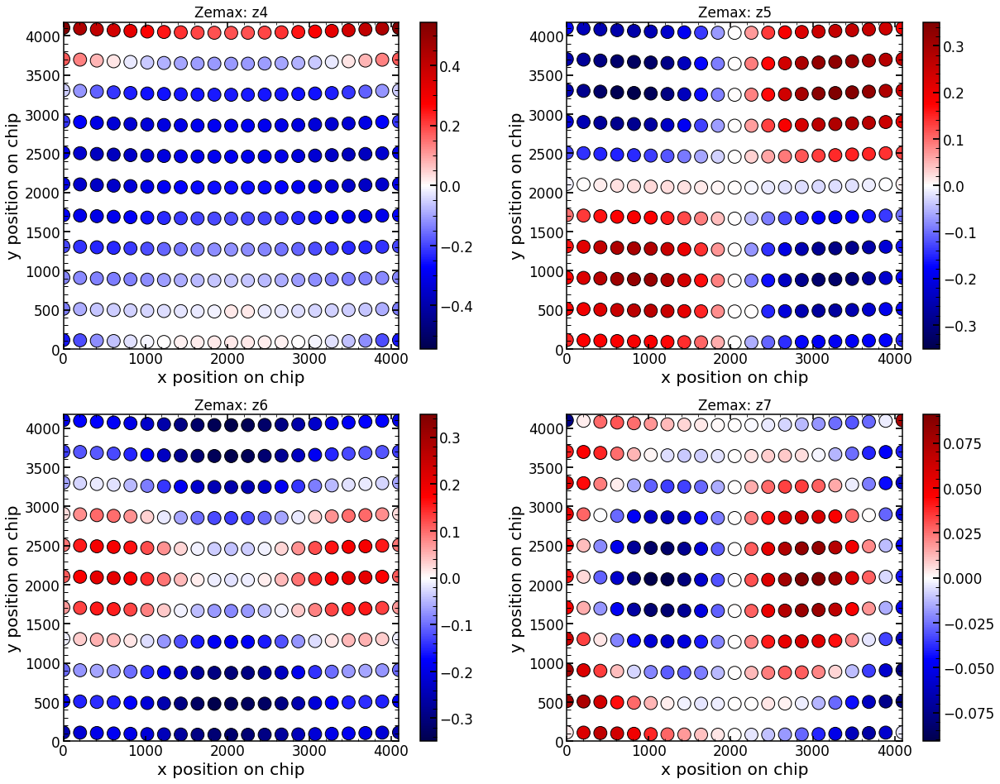

In [1675]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
values=np.array(wavelength_correction(single_Zernike_res_z4))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(4))
plt.colorbar()

plt.subplot(2,2,2)
values=np.array(wavelength_correction(single_Zernike_res_z5))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(5))
plt.colorbar()

plt.subplot(2,2,3)
values=np.array(wavelength_correction(single_Zernike_res_z6))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(6))
plt.colorbar()

plt.subplot(2,2,4)
values=np.array(wavelength_correction(single_Zernike_res_z7))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(7))
plt.colorbar()

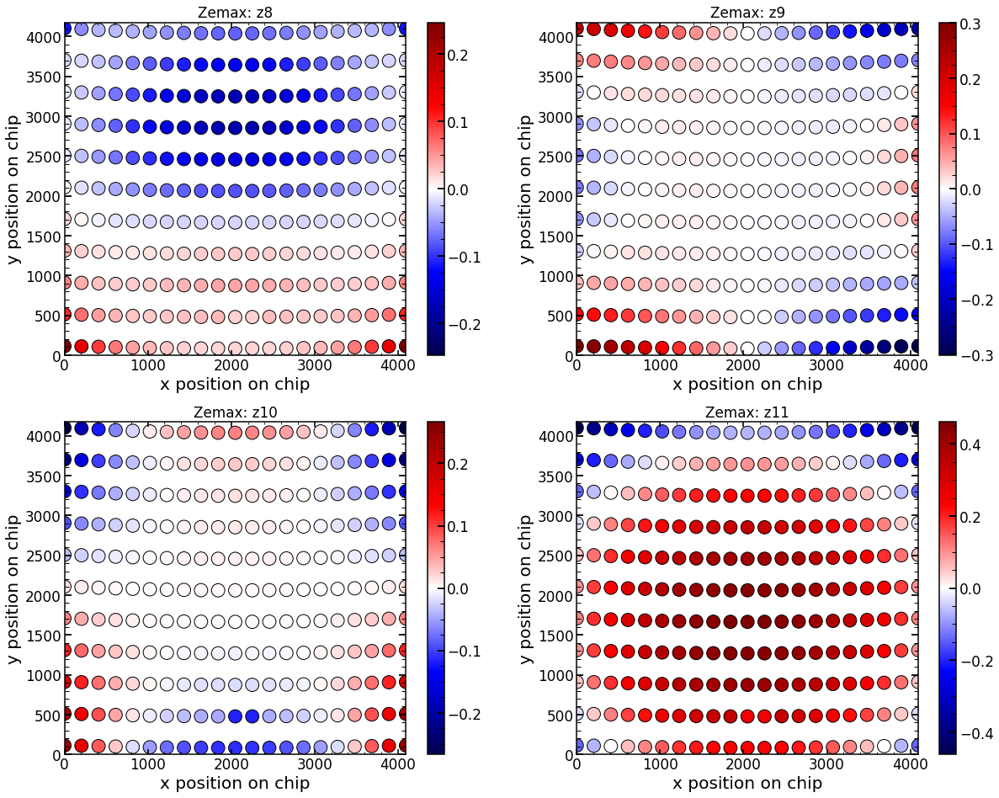

In [1676]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
values=np.array(wavelength_correction(single_Zernike_res_z8))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(8))
plt.colorbar()

plt.subplot(2,2,2)
values=np.array(wavelength_correction(single_Zernike_res_z9))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(9))
plt.colorbar()

plt.subplot(2,2,3)
values=np.array(wavelength_correction(single_Zernike_res_z10))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(10))
plt.colorbar()

plt.subplot(2,2,4)
values=np.array(wavelength_correction(single_Zernike_res_z11))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(11))
plt.colorbar()

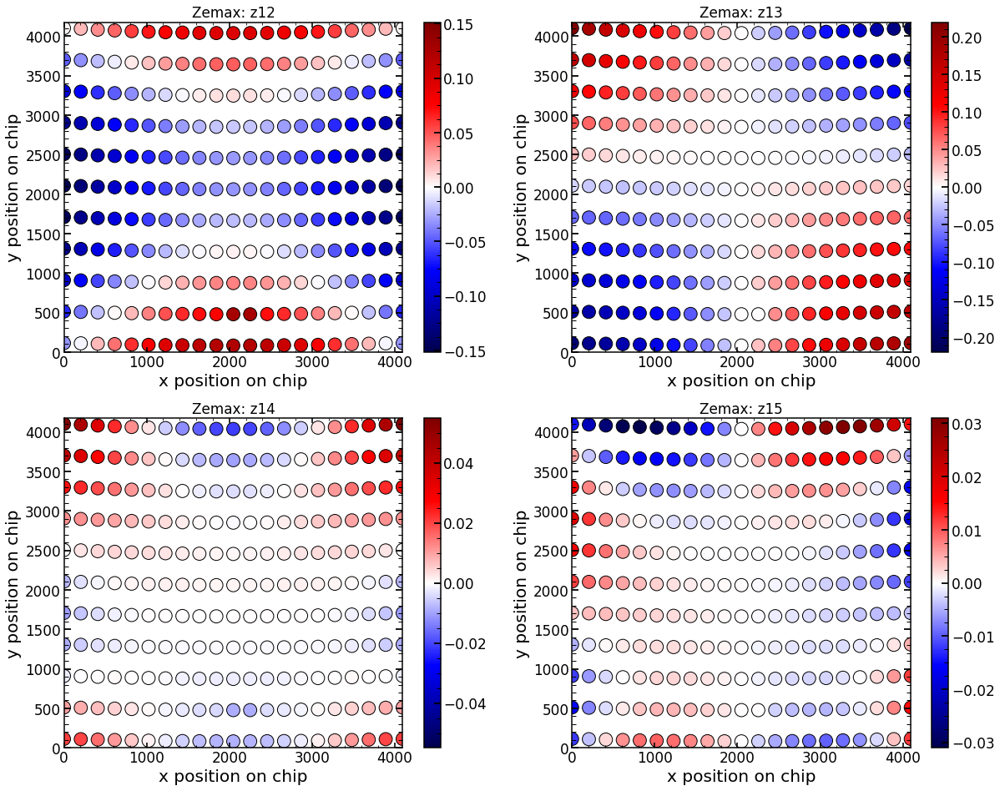

In [1677]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
values=np.array(wavelength_correction(single_Zernike_res_z12))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(12))
plt.colorbar()

plt.subplot(2,2,2)
values=np.array(wavelength_correction(single_Zernike_res_z13))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(13))
plt.colorbar()

plt.subplot(2,2,3)
values=np.array(wavelength_correction(single_Zernike_res_z14))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(14))
plt.colorbar()

plt.subplot(2,2,4)
values=np.array(wavelength_correction(single_Zernike_res_z15))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(15))
plt.colorbar()

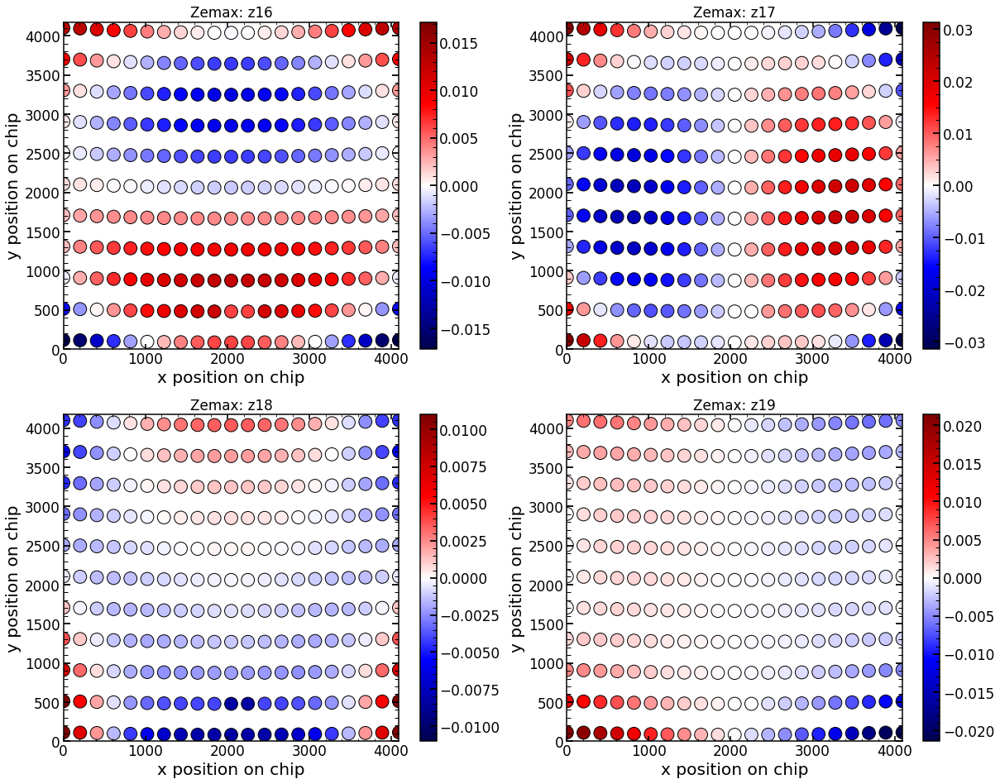

In [1596]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
values=np.array(wavelength_correction(single_Zernike_res_z16))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(16))
plt.colorbar()

plt.subplot(2,2,2)
values=np.array(wavelength_correction(single_Zernike_res_z17))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(17))
plt.colorbar()

plt.subplot(2,2,3)
values=np.array(wavelength_correction(single_Zernike_res_z18))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(18))
plt.colorbar()

plt.subplot(2,2,4)
values=np.array(wavelength_correction(single_Zernike_res_z19))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(19))
plt.colorbar()

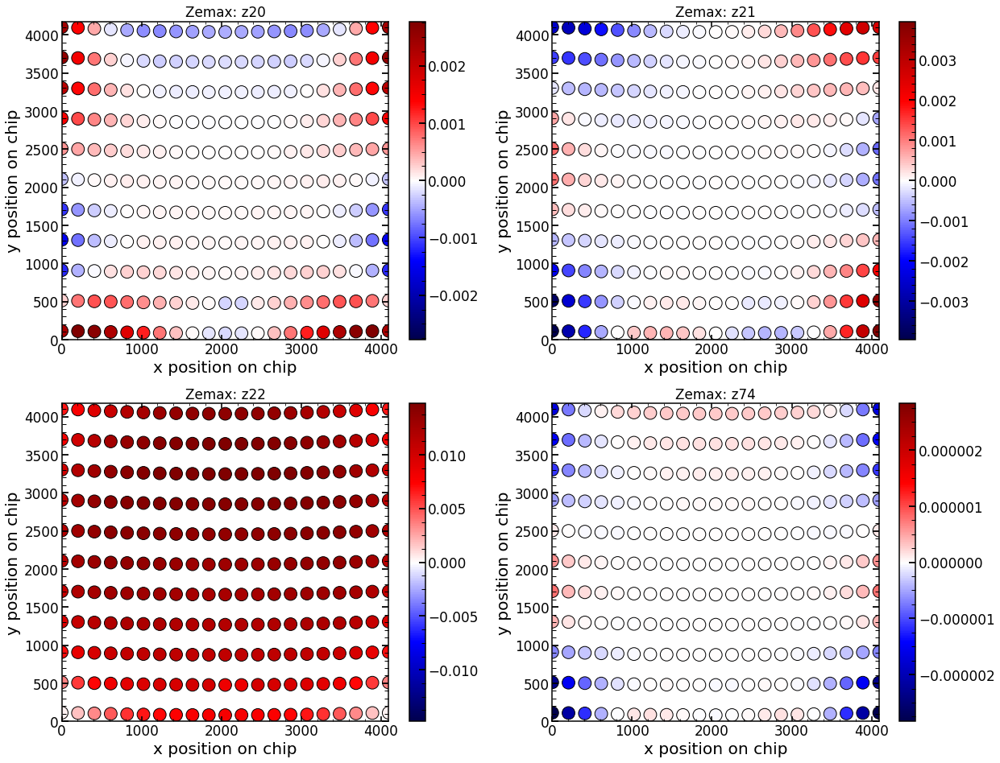

In [1681]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
values=np.array(wavelength_correction(single_Zernike_res_z20))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(20))
plt.colorbar()

plt.subplot(2,2,2)
values=np.array(wavelength_correction(single_Zernike_res_z21))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(21))
plt.colorbar()

plt.subplot(2,2,3)
values=np.array(wavelength_correction(single_Zernike_res_z22))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(22))
plt.colorbar()

plt.subplot(2,2,4)
values=np.array(wavelength_correction(single_Zernike_res_z74))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(74))
plt.colorbar()

# Sample of 1 - run interpolation

In [ ]:
# get 6 images
# infeer all properties apart from wavefront
# do huge amount of Zernike
# deduce wavefront in focus
# fit the rest


In [ ]:
/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/March22

In [276]:
import glob
Emcee3_files=glob.glob("/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/March22/chainMarch22_*Emcee3.npy")

In [277]:
res=[]
for i in range(len(Emcee3_files)):
    res.append(Emcee3_files[i][94:103])

In [278]:
res_split=[]
for i in range(len(res)):
    res_split.append([res[i][:5],res[i][5:]])
    
res_split=np.array(res_split)

In [283]:
spots_analyzed=np.unique(res_split[:,1])

In [287]:
res_split_by_spot=[]
for i in spots_analyzed:
    res_split_by_spot.append(res_split[res_split[:,1]==i])

In [289]:
res_split_by_spot[0]

array([['11790', '1025'],
       ['11694', '1025'],
       ['11796', '1025'],
       ['11730', '1025'],
       ['11700', '1025'],
       ['11784', '1025'],
       ['11754', '1025'],
       ['11748', '1025'],
       ['11760', '1025'],
       ['11736', '1025']], dtype='<U5')

In [327]:
date='March22'

single_number='102'
image_index=int(single_number)
eps=5
arc='HgAr'

minchain_list=[]
for obs in [11796,11790,11760,11748,11700,11730,11736]:
    single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc)
    chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

    minchain,like_min=single_analysis.create_likelihood()
    
    
    minchain_list.append(minchain)
    
minchain_array=np.array(minchain_list)

(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 56409.739598525244
minimal chi2 reduced is: 31.333523600483204
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 35694.041663499185
minimal chi2 reduced is: 28.547830020259017
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 1524.3903296920557
minimal chi2 reduced is: 7.581342771884763
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 486.26892444984765
minimal chi2 reduced is: 2.3947311297875173
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 1704.8305246139696
minimal chi2 reduced is: 5.891489713971136
(number of walkers, number of steps, number of parameters): (186, 40, 31)
minimal likelihood is: 56243.51540607001
minimal chi2 reduced is: 31.241247475393063
(number of walkers, number of steps, number

In [329]:
np.median(minchain_array,axis=0)

array([   -0.52824769,    -0.3884749 ,    -0.49111174,     0.25127761,
          -0.01485905,    -0.0128908 ,    -0.26604678,    -0.46245974,
           0.67984829,     0.0777539 ,     0.00711556,     0.01153881,
           0.06014028,     0.0082926 ,     0.00000016,     0.00000016,
           0.97281741,     0.94833807,    -0.01011841,    -0.06251152,
           0.79753038,     0.10981264,     0.9727988 ,     1.02082311,
          -0.028522  , 73855.79350565,     2.39837901,     0.00216294,
           0.35850719,     1.81758716,     0.99760449])